In [3]:
from __future__ import print_function, division
import scipy.interpolate as sci
import numpy as np
from PyAstronomy.pyaC import pyaErrors as PE
import six.moves as smo
from astropy.io import fits
import os
from sklearn import preprocessing
import shutil
from astropy.timeseries import LombScargle
import numpy as np
import matplotlib.pyplot as plt
from PyAstronomy import pyasl
from specutils.manipulation import FluxConservingResampler, LinearInterpolatedResampler, SplineInterpolatedResampler
from astropy import units as u
from specutils import Spectrum1D
from lmfit import Parameters, minimize, report_fit, Model,fit_report
from pylab import rc
from matplotlib import transforms
from astropy.time import Time
from astropy.coordinates import SkyCoord, EarthLocation
from astropy.coordinates import ICRS
from lmfit import Parameters, minimize, report_fit, Model,fit_report
plt.rc('xtick',c='w')
from specutils.analysis import snr_derived
plt.rc('ytick',c='w')
from pylab import *
rcParams['font.family'] = 'serif'
rcParams['font.sans-serif'] = ['Times']

/home/nwal/anaconda3/lib/python3.7/site-packages/pyfits/__init__.py:22: PyFITSDeprecationWarning: PyFITS is deprecated, please use astropy.io.fits
  PyFITSDeprecationWarning)  # noqa


In [4]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx
def sineModelFixed(x,a,c,d):
    return a*np.sin(2*np.pi*x+c)+d

def foldMeth(timeArray, period):
    phases = []
    for el in timeArray:
        passed = int(el/period)
        leftover = el - (passed*period)
        phase = leftover/period
        phases.append(phase)
    return np.array(phases)

def gaussian(x, amp, cen, wid, off):
    return (amp * np.exp(-(x-cen)**2 / wid))+off
def lorentzian(x, x0, a, gam,off):
    return (a * gam**2 / ( gam**2 + ( x - x0 )**2))+off
def lorentzianGauss(x, x0, a, gam, off, amp,wid,off2):
    return lorentzian(x,x0,a,gam,off)+gaussian(x,amp=amp,cen=x0,wid=wid,off=off2)


/home/nwal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


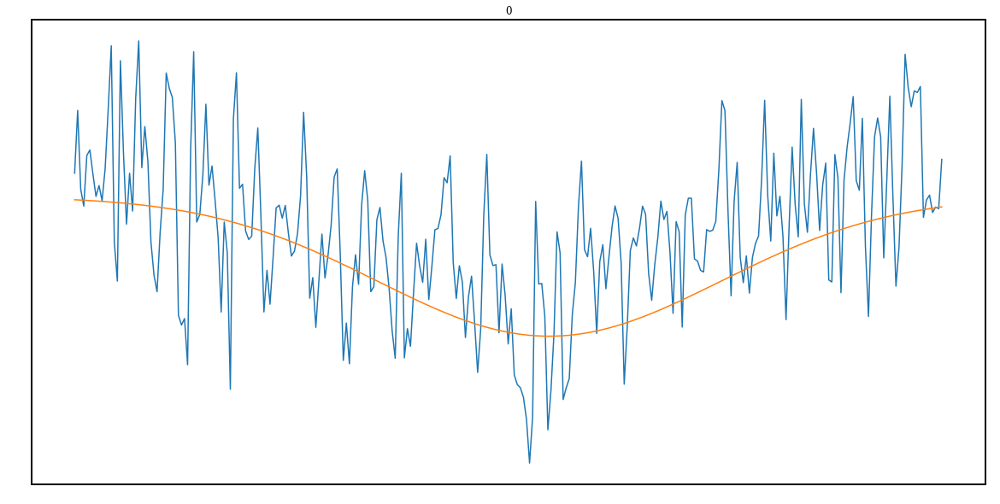

Parameters([('amp', <Parameter 'amp', value=-0.09980568163194627 +/- 0.0121, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375469819731343 +/- 1.08e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=5.853819853360861e-08 +/- 1.9e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5277205853453724 +/- 0.0131, bounds=[-inf:inf]>)])


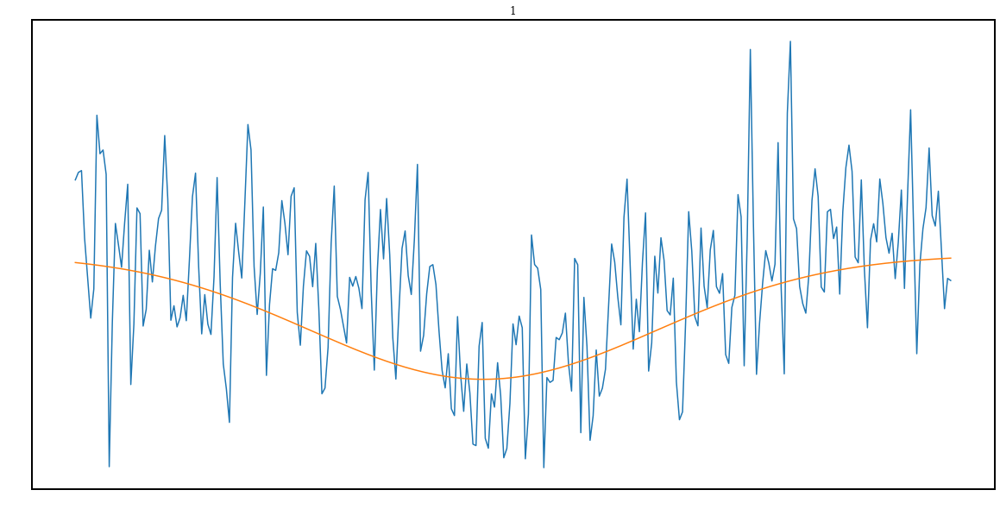

Parameters([('amp', <Parameter 'amp', value=-0.09712723227354234 +/- 0.00927, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637622213759019 +/- 9.23e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.6277925973981135e-08 +/- 4.08e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5043039681136134 +/- 0.00494, bounds=[-inf:inf]>)])


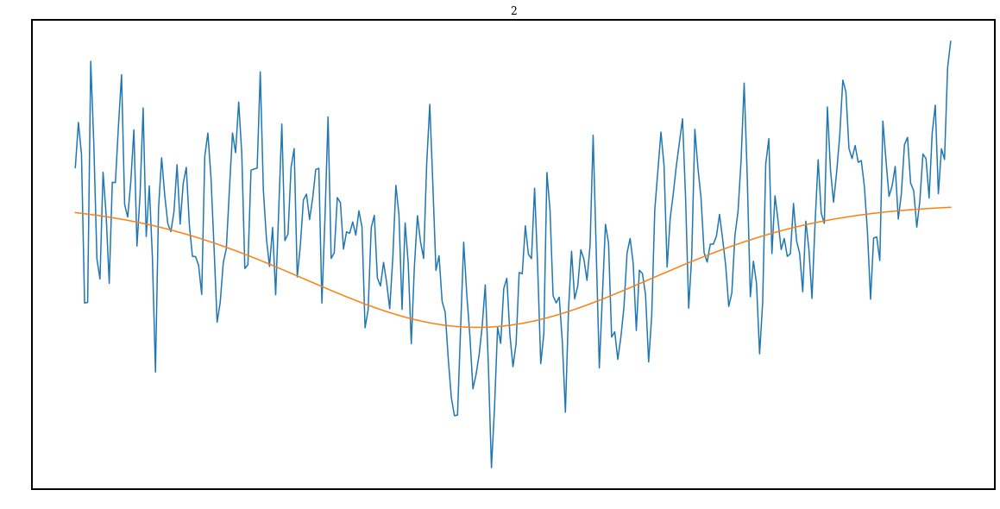

Parameters([('amp', <Parameter 'amp', value=-0.09564962522755183 +/- 0.00837, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637622029785032 +/- 9.57e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.27170793747413e-08 +/- 5.46e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5090563233190925 +/- 0.00541, bounds=[-inf:inf]>)])


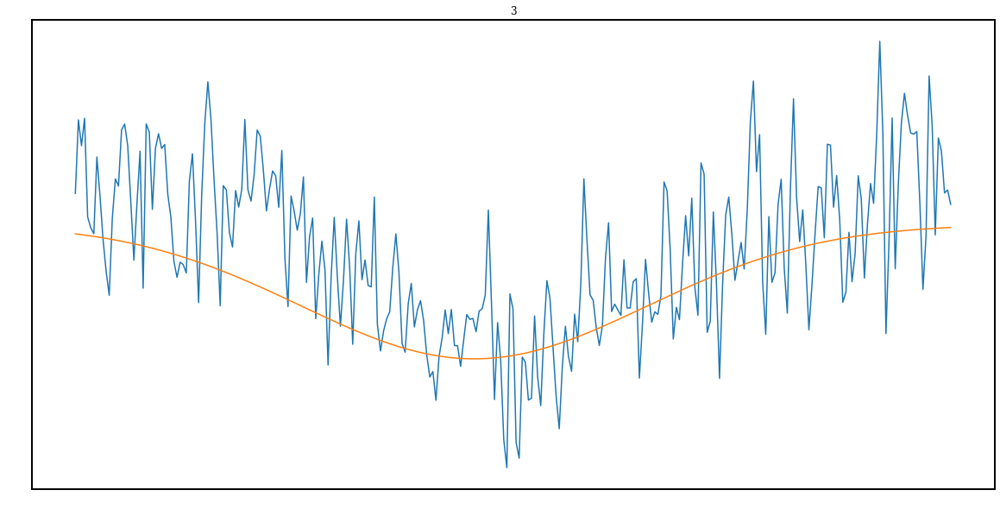

Parameters([('amp', <Parameter 'amp', value=-0.12285913999757467 +/- 0.0071, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637627547902675 +/- 6.8e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.333424106951215e-08 +/- 5.62e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5291453332814463 +/- 0.00594, bounds=[-inf:inf]>)])


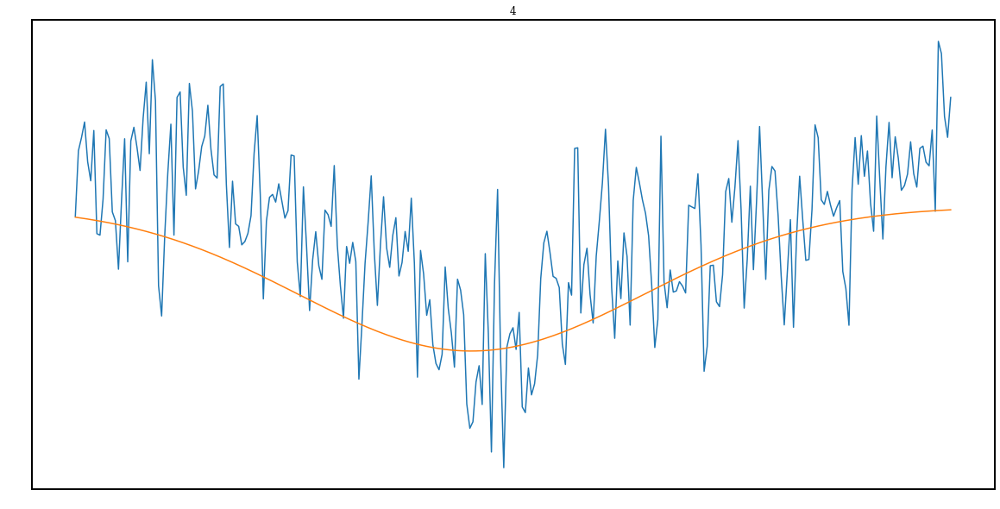

Parameters([('amp', <Parameter 'amp', value=-0.11132636032630347 +/- 0.00875, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637630720223962 +/- 8.19e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=4.893950474622897e-08 +/- 1.1e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5361035636913105 +/- 0.00904, bounds=[-inf:inf]>)])


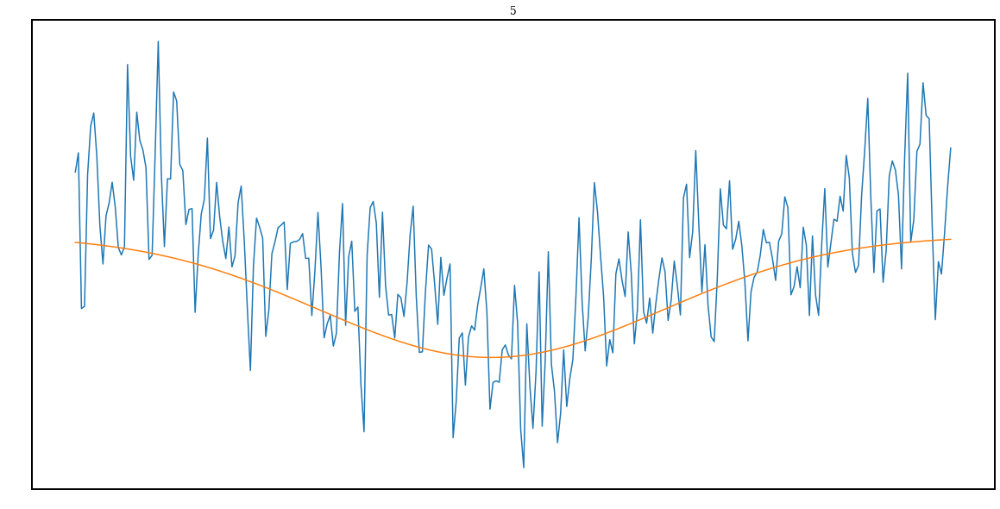

Parameters([('amp', <Parameter 'amp', value=-0.12733557324809866 +/- 0.0114, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637613377029964 +/- 8.25e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=5.726718078081484e-08 +/- 1.4e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5458172110434099 +/- 0.0123, bounds=[-inf:inf]>)])


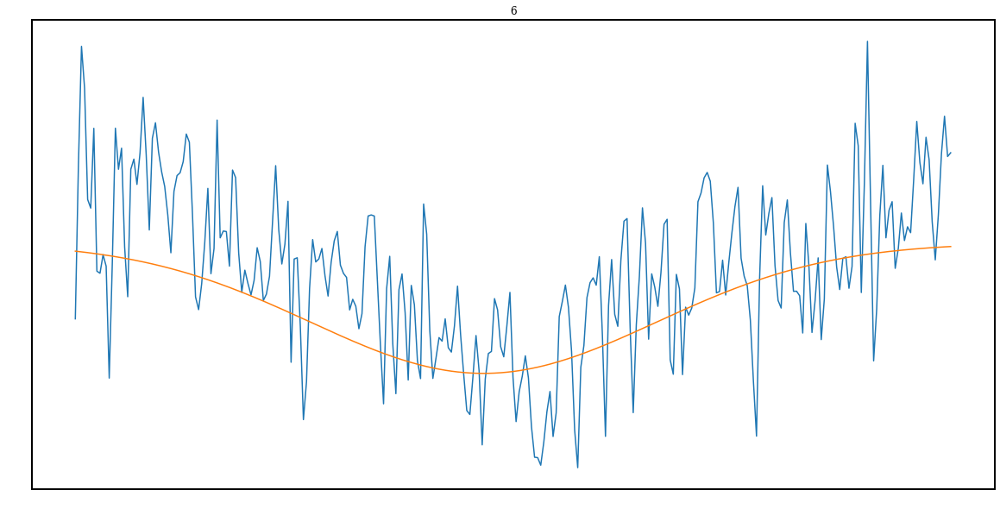

Parameters([('amp', <Parameter 'amp', value=-0.12520687782042506 +/- 0.00988, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637621262982031 +/- 8.22e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=4.903782868712435e-08 +/- 1.11e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5387772426181539 +/- 0.0102, bounds=[-inf:inf]>)])


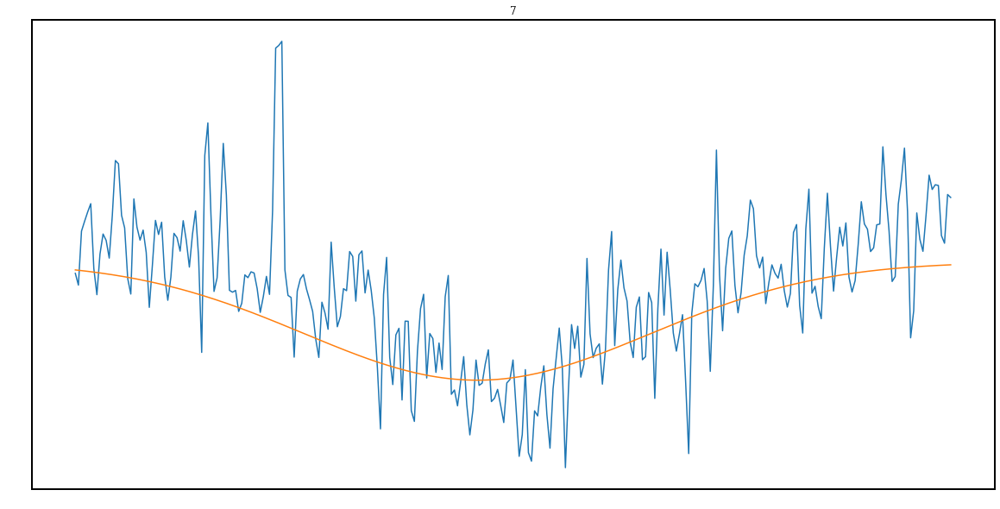

Parameters([('amp', <Parameter 'amp', value=-0.12776963493881588 +/- 0.00694, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6376228107027857 +/- 6.22e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.6831899264265014e-08 +/- 4.11e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.521361858038798 +/- 0.00501, bounds=[-inf:inf]>)])


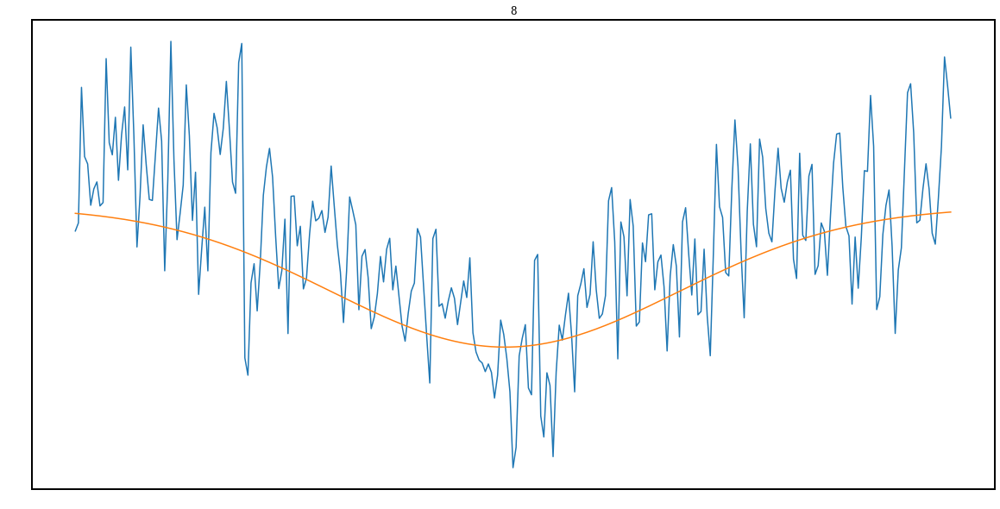

Parameters([('amp', <Parameter 'amp', value=-0.11524509297625136 +/- 0.00699, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637600680834312 +/- 7.11e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.090500581592014e-08 +/- 5.41e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5199808584424691 +/- 0.00555, bounds=[-inf:inf]>)])


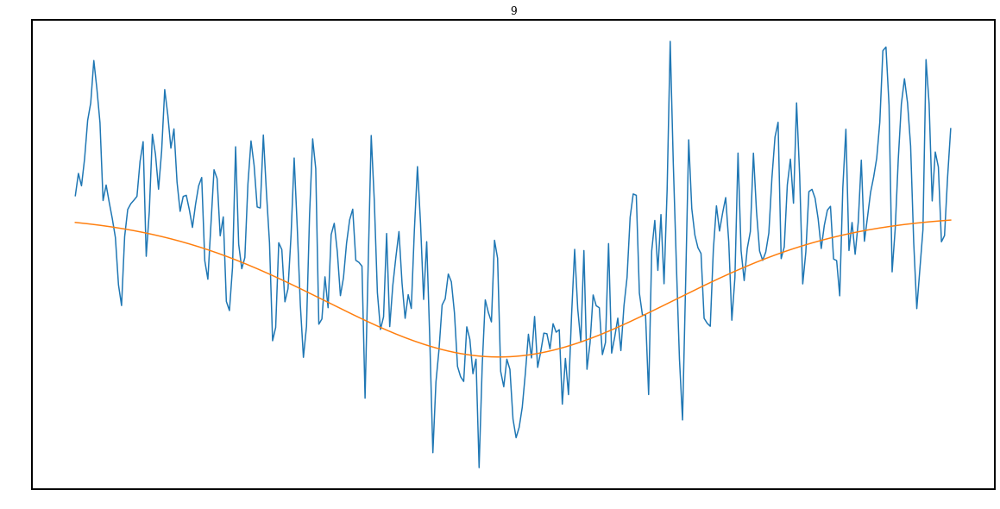

Parameters([('amp', <Parameter 'amp', value=-0.1160929722970676 +/- 0.00745, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375996853431913 +/- 7.49e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.762154907880985e-08 +/- 7.12e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5266073661797488 +/- 0.00675, bounds=[-inf:inf]>)])


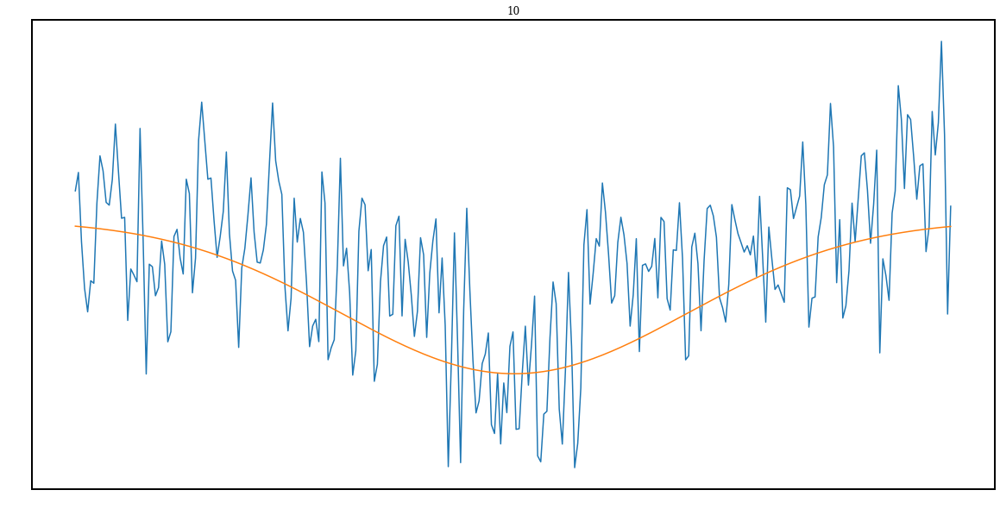

Parameters([('amp', <Parameter 'amp', value=-0.09148879038780333 +/- 0.00748, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375863887550115 +/- 7.12e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.2748073085259825e-08 +/- 2.67e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.4947026318429604 +/- 0.00353, bounds=[-inf:inf]>)])


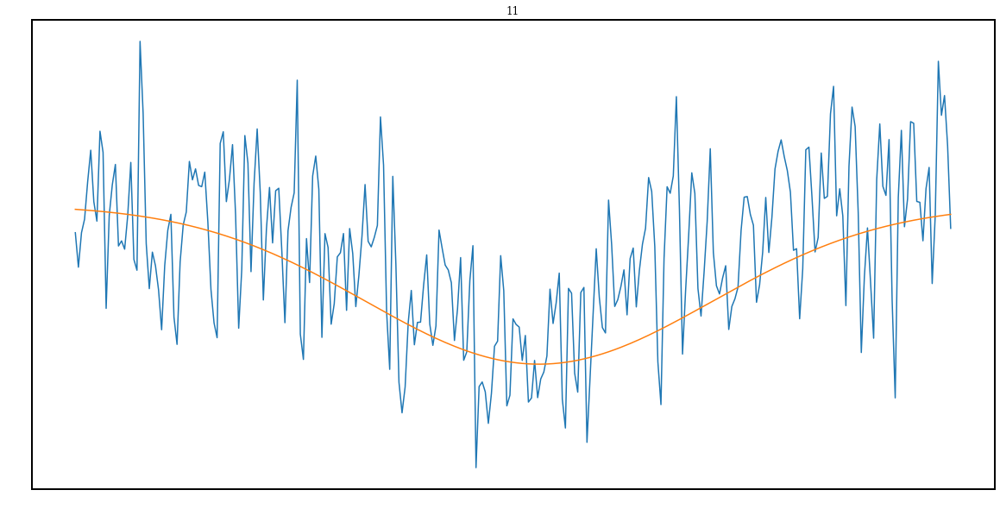

Parameters([('amp', <Parameter 'amp', value=-0.08747894045887707 +/- 0.00687, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637566730242514 +/- 7.76e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.728846744656593e-08 +/- 3.57e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.49546392255845245 +/- 0.00377, bounds=[-inf:inf]>)])


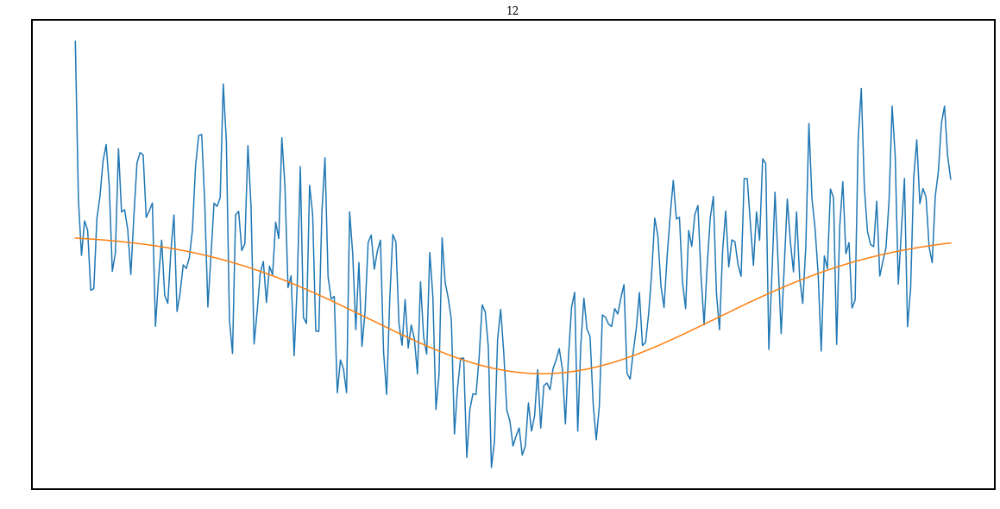

Parameters([('amp', <Parameter 'amp', value=-0.11898906357615902 +/- 0.00687, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375613349862967 +/- 6.1e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.04983380387438e-08 +/- 3.19e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5086798642034334 +/- 0.00416, bounds=[-inf:inf]>)])


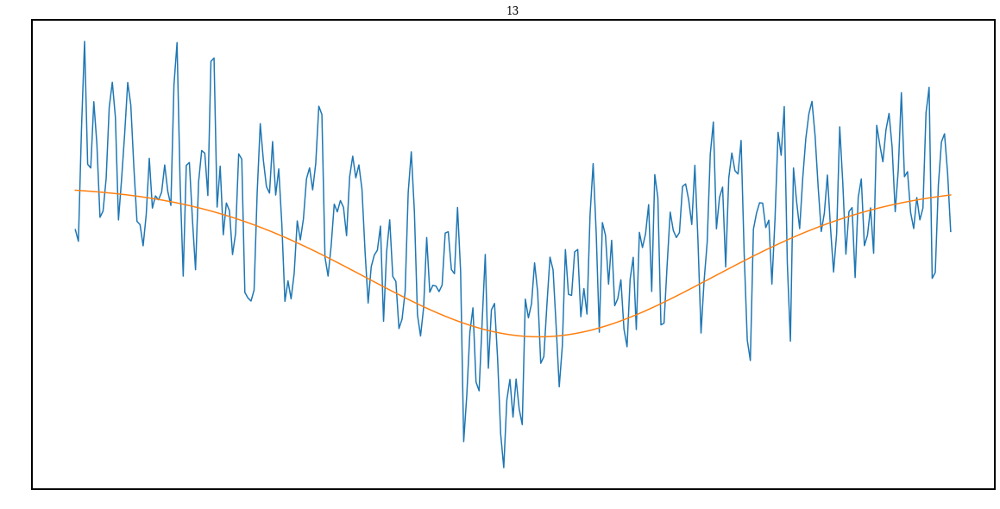

Parameters([('amp', <Parameter 'amp', value=-0.09866587758913835 +/- 0.00654, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637567572755442 +/- 6.57e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.730776834016116e-08 +/- 3.03e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5001007610761404 +/- 0.0036, bounds=[-inf:inf]>)])


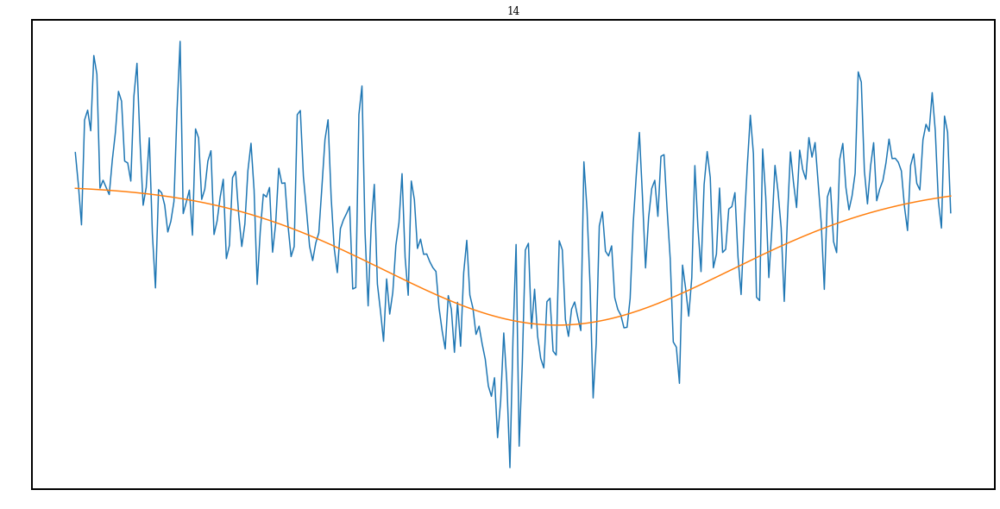

Parameters([('amp', <Parameter 'amp', value=-0.10980944196643479 +/- 0.00647, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375543967298296 +/- 6.75e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.676479623583751e-08 +/- 4.45e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5109142689504151 +/- 0.00466, bounds=[-inf:inf]>)])


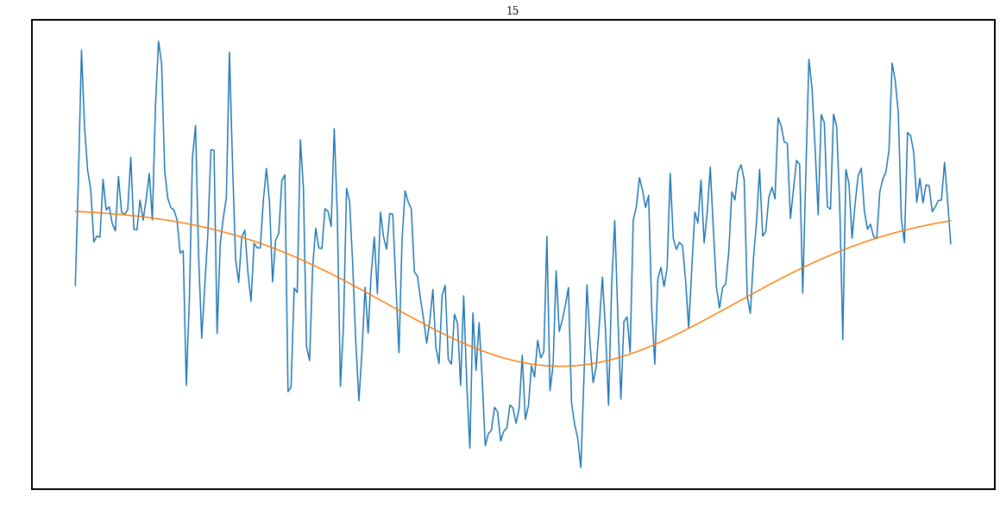

Parameters([('amp', <Parameter 'amp', value=-0.11430056359726488 +/- 0.00653, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637545128041711 +/- 5.98e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.0008108388349112e-08 +/- 3.07e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5078011658696605 +/- 0.0039, bounds=[-inf:inf]>)])


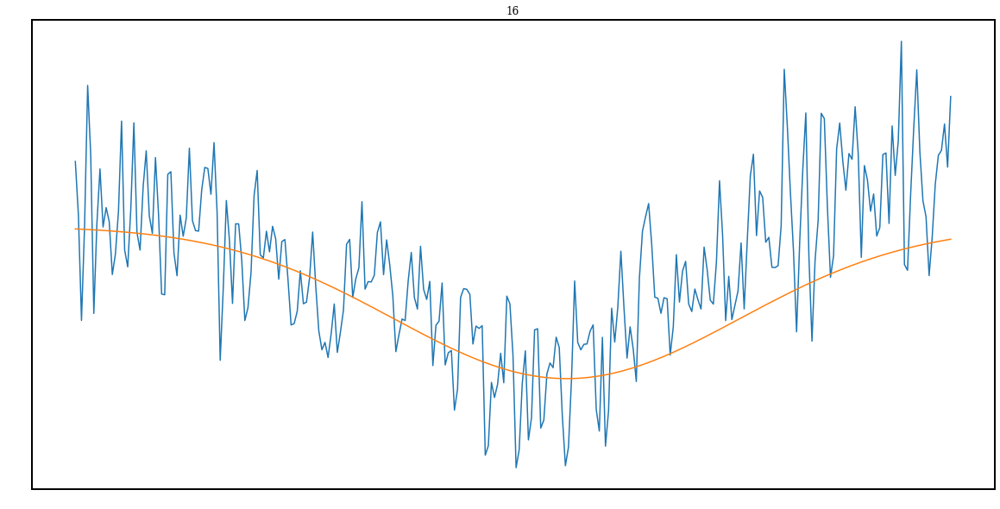

Parameters([('amp', <Parameter 'amp', value=-0.11860434162138342 +/- 0.00721, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375376683079064 +/- 6.55e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=4.6562409691709146e-08 +/- 8.21e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5293580106662845 +/- 0.0073, bounds=[-inf:inf]>)])


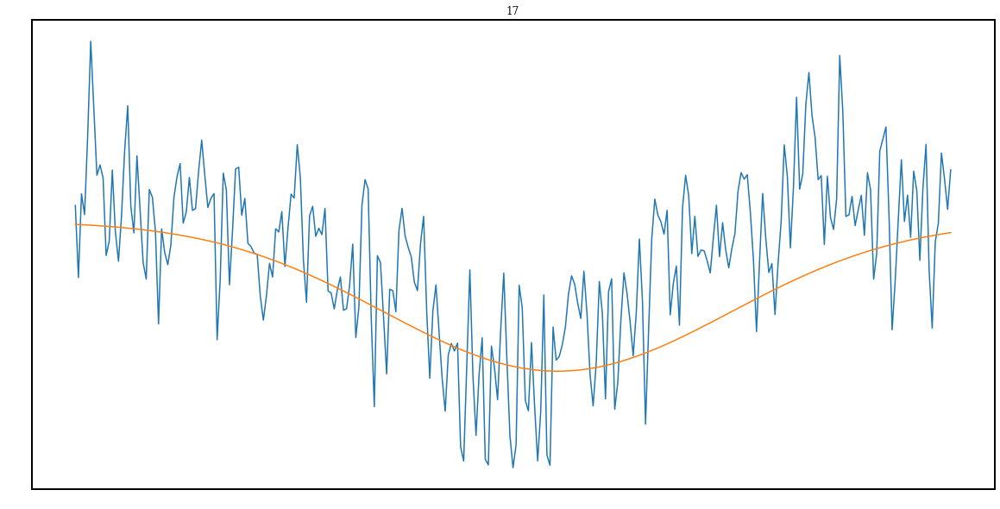

Parameters([('amp', <Parameter 'amp', value=-0.11479365018544571 +/- 0.00617, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637548598926941 +/- 5.61e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.9875753674502936e-08 +/- 2.87e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5114354195885857 +/- 0.00367, bounds=[-inf:inf]>)])


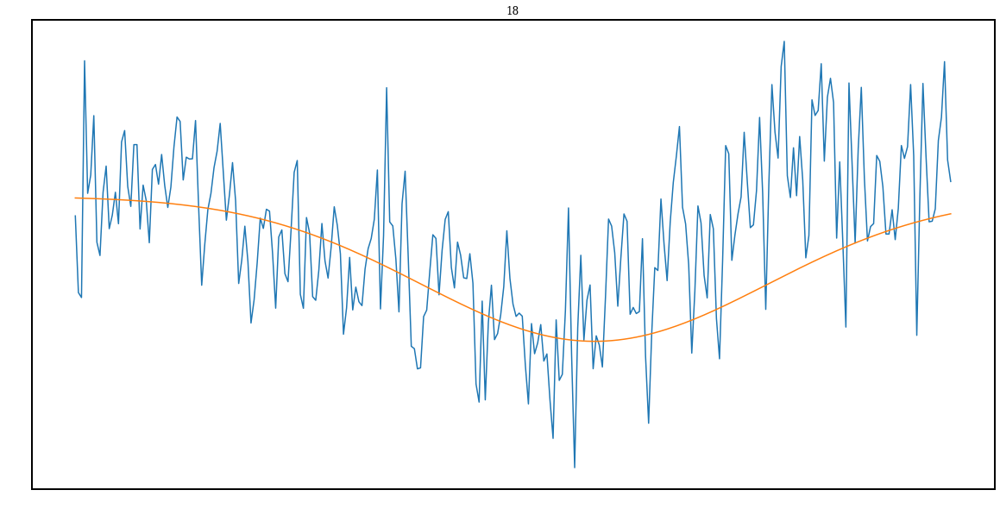

Parameters([('amp', <Parameter 'amp', value=-0.10357820068347641 +/- 0.00717, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375109693283596 +/- 8.13e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.6220850102294113e-08 +/- 7.37e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5166771509146442 +/- 0.00633, bounds=[-inf:inf]>)])


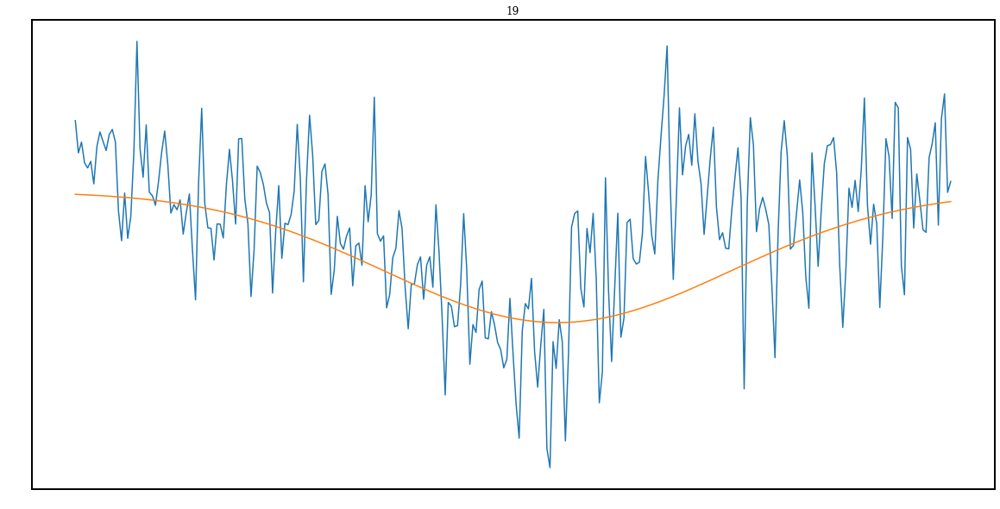

Parameters([('amp', <Parameter 'amp', value=-0.11979897811751278 +/- 0.00805, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375483732241194 +/- 5.22e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=9.886829967525541e-09 +/- 1.67e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.4987202949054631 +/- 0.00339, bounds=[-inf:inf]>)])


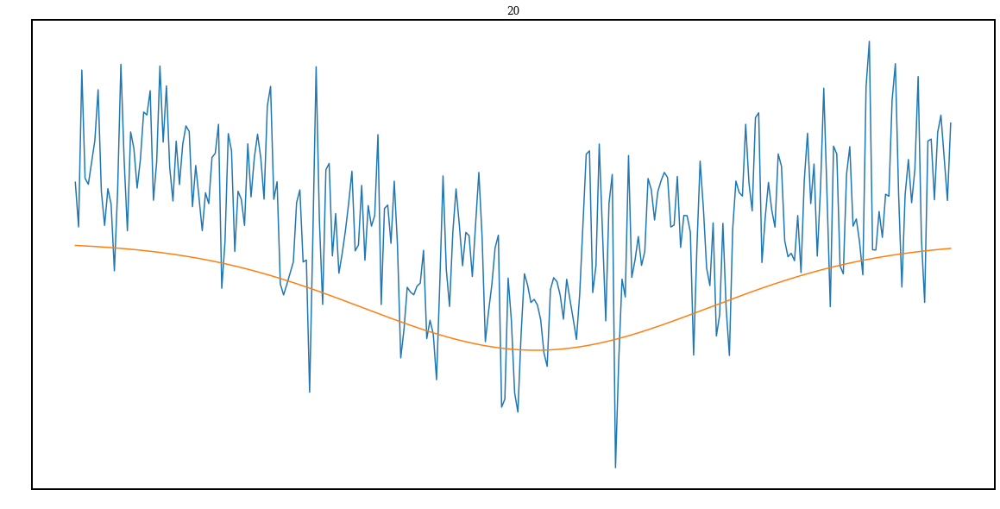

Parameters([('amp', <Parameter 'amp', value=-0.1153846275183743 +/- 0.0111, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375784199831656 +/- 1.07e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=4.359060964352973e-08 +/- 1.23e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5721634178118196 +/- 0.0109, bounds=[-inf:inf]>)])


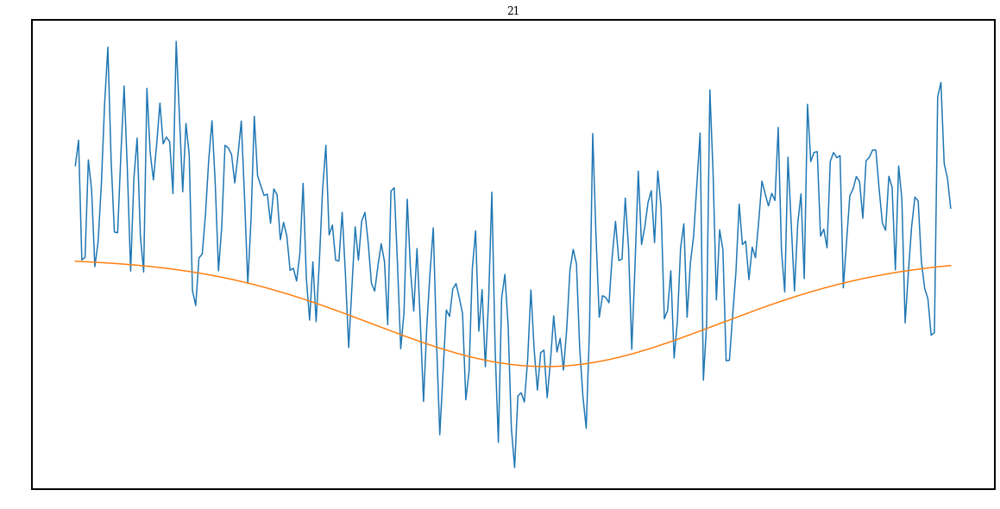

Parameters([('amp', <Parameter 'amp', value=-0.13394845068605932 +/- 0.00965, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375610451432596 +/- 8.15e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.548808239890355e-08 +/- 5.12e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.561368444957372 +/- 0.0067, bounds=[-inf:inf]>)])


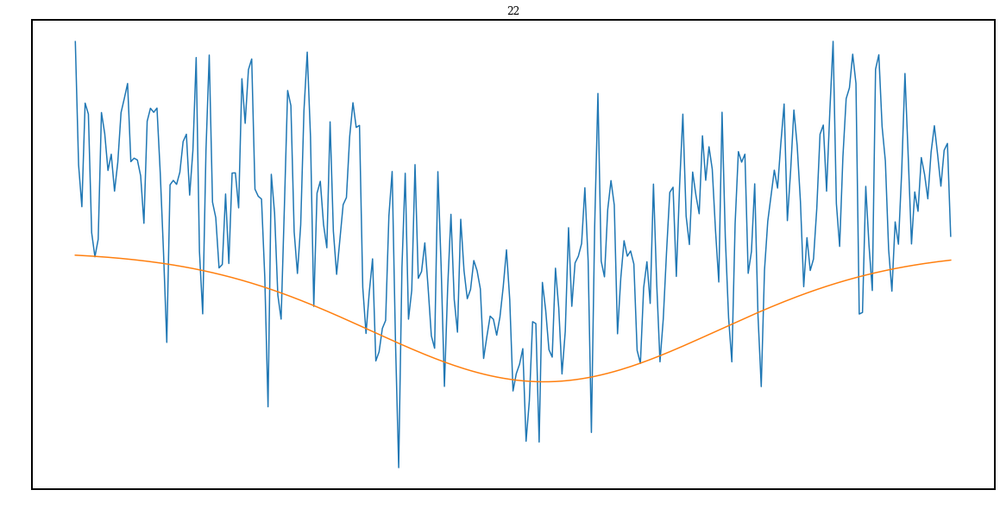

Parameters([('amp', <Parameter 'amp', value=-0.11132761135979809 +/- 0.00929, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375640642409732 +/- 9.51e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.6305768932652053e-08 +/- 6.18e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5618892808741187 +/- 0.00663, bounds=[-inf:inf]>)])


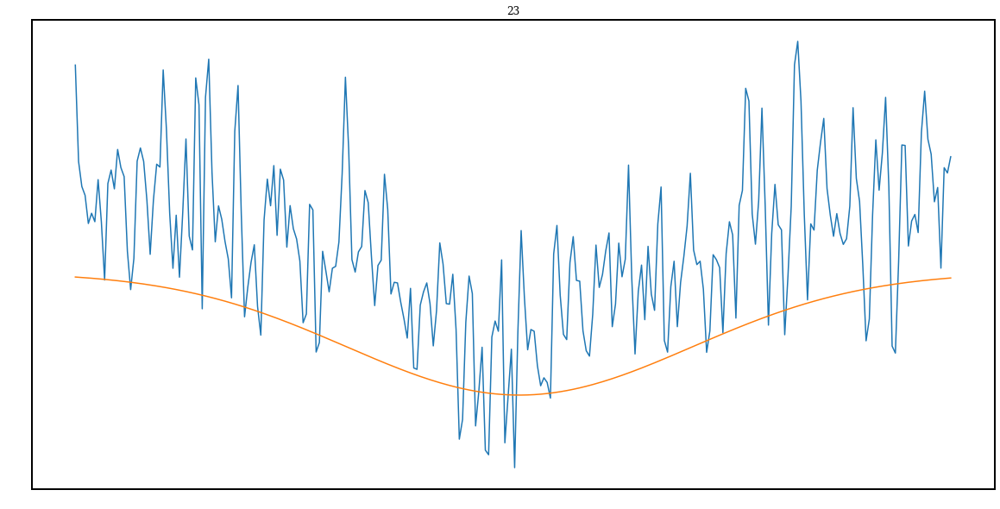

Parameters([('amp', <Parameter 'amp', value=-0.1173913193134326 +/- 0.00867, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375832953454847 +/- 8.49e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.705568008166972e-08 +/- 5.64e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5628194762579137 +/- 0.00627, bounds=[-inf:inf]>)])


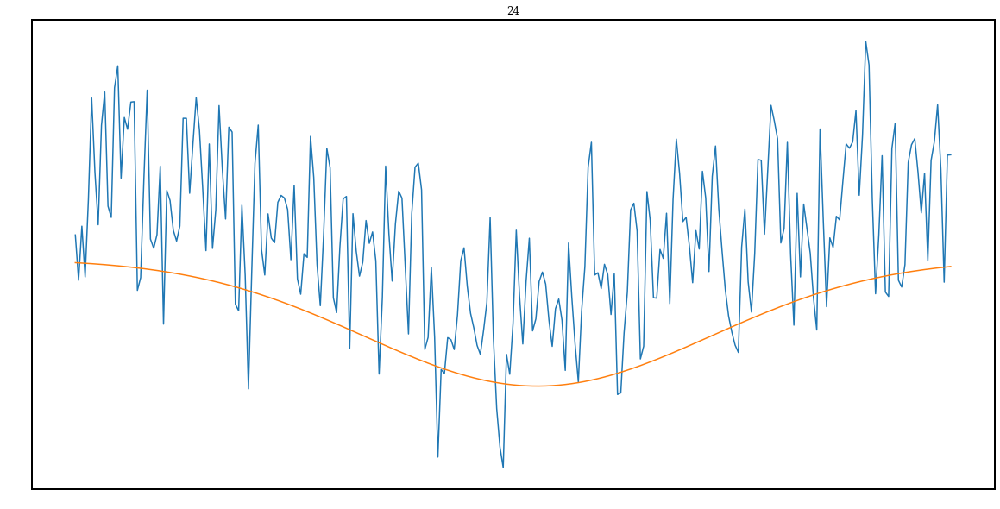

Parameters([('amp', <Parameter 'amp', value=-0.10129537225298263 +/- 0.00901, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375704713821535 +/- 1.05e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.3458276320516185e-08 +/- 8.7e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5569735646231082 +/- 0.00758, bounds=[-inf:inf]>)])


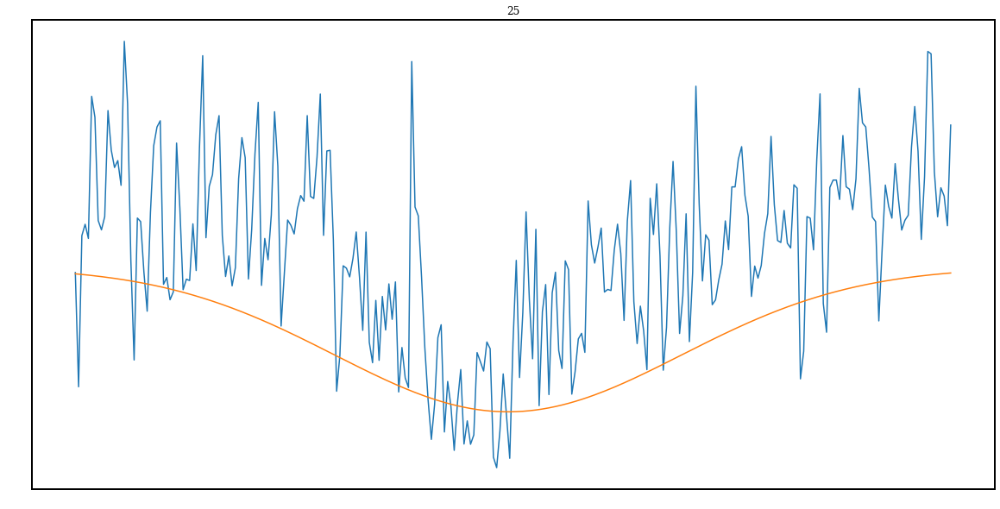

Parameters([('amp', <Parameter 'amp', value=-0.11885401424066078 +/- 0.00859, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375703496795393 +/- 6.68e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.4688495178821135e-08 +/- 2.75e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5420563059038039 +/- 0.00434, bounds=[-inf:inf]>)])


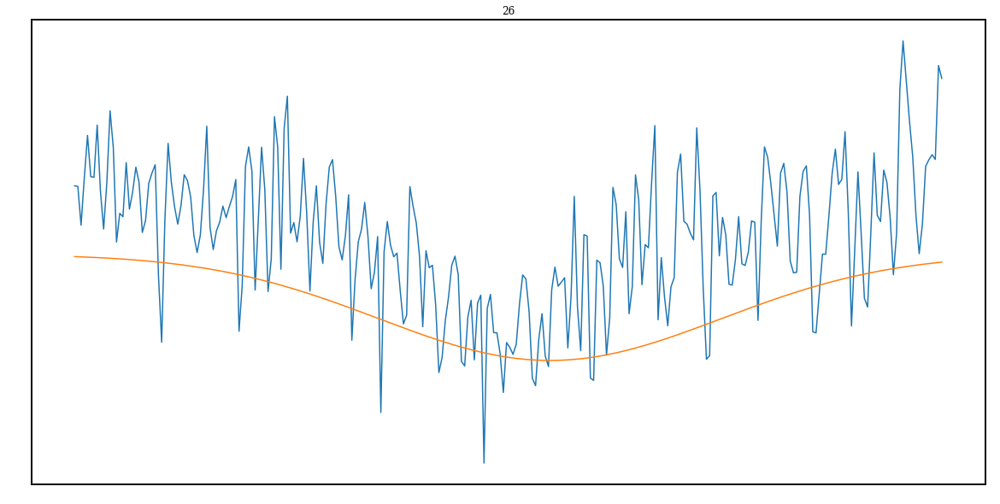

Parameters([('amp', <Parameter 'amp', value=-0.11801433648765343 +/- 0.00902, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375549111794663 +/- 7.96e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.97214529772745e-08 +/- 4.05e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5508216543323889 +/- 0.00534, bounds=[-inf:inf]>)])


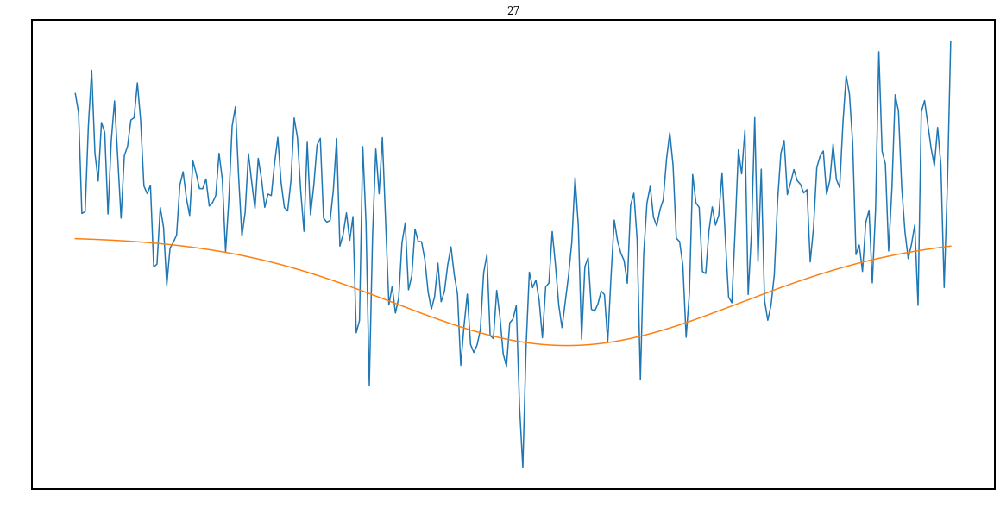

Parameters([('amp', <Parameter 'amp', value=-0.1239367495448139 +/- 0.00846, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375435189265444 +/- 7.26e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.0963760946625524e-08 +/- 3.88e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5530612852351457 +/- 0.00521, bounds=[-inf:inf]>)])


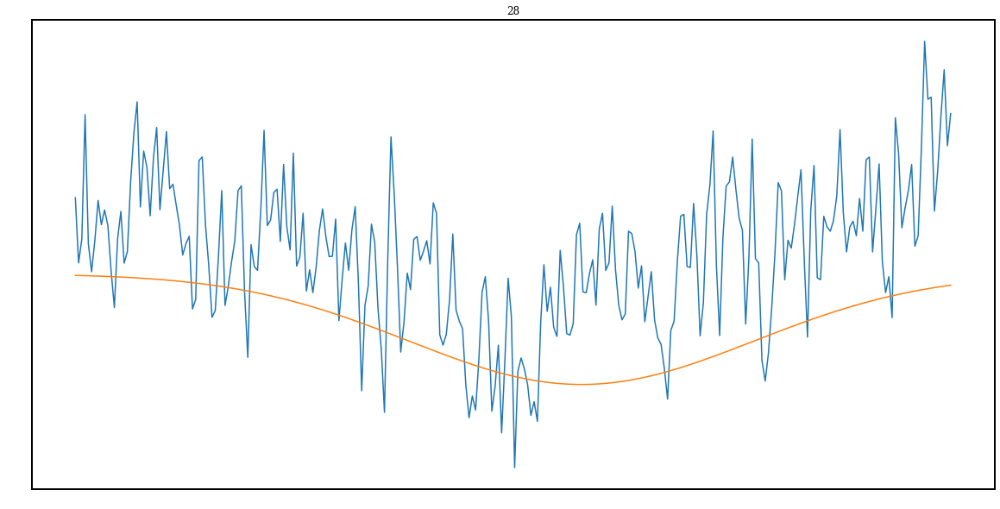

Parameters([('amp', <Parameter 'amp', value=-0.11555366313907339 +/- 0.0106, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375300841855602 +/- 1.02e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=4.391355417152495e-08 +/- 1.18e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5707152353072598 +/- 0.0104, bounds=[-inf:inf]>)])


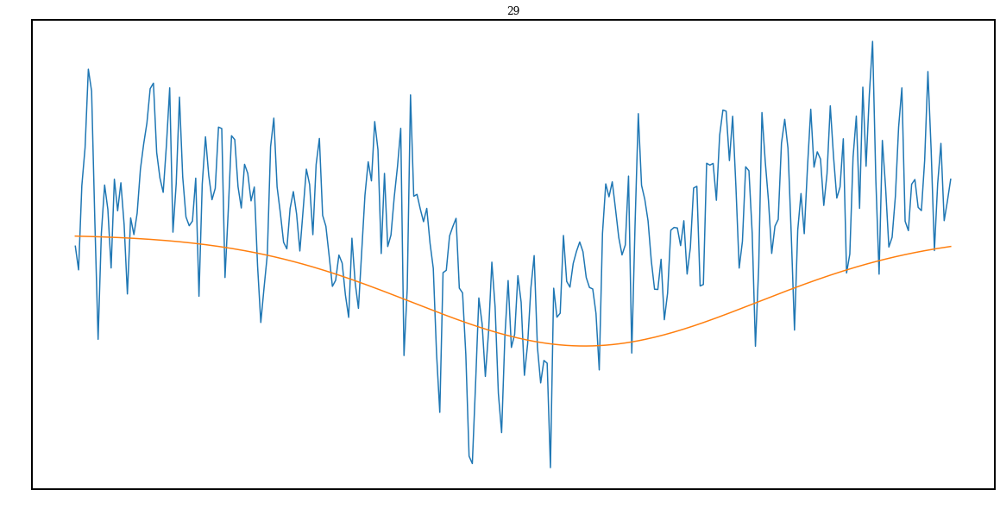

Parameters([('amp', <Parameter 'amp', value=-0.13122183778601396 +/- 0.0108, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637525157941886 +/- 6.13e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=9.04611156008825e-09 +/- 1.86e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5377097851195701 +/- 0.00437, bounds=[-inf:inf]>)])


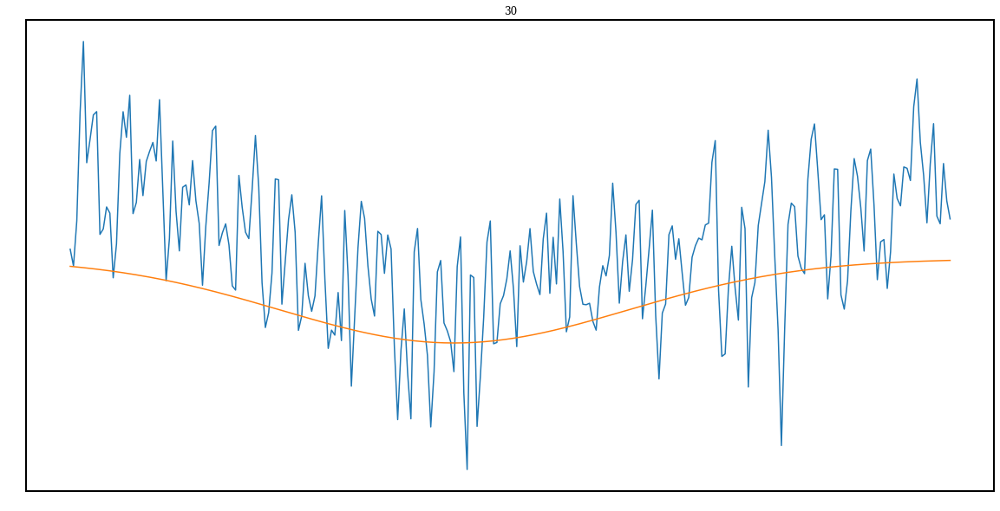

Parameters([('amp', <Parameter 'amp', value=-0.285375563495711 +/- 0.169, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637644739705405 +/- 9.74e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.9619327057362761e-07 +/- 1.66e-07, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.7369060814410305 +/- 0.173, bounds=[-inf:inf]>)])


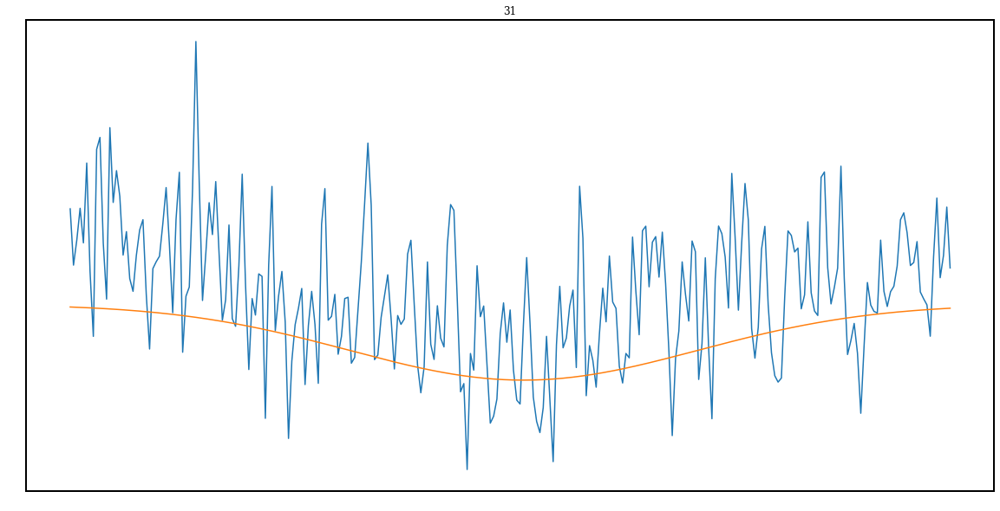

Parameters([('amp', <Parameter 'amp', value=-0.21138741472581174 +/- 0.144, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6376066143069408 +/- 1.49e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.774241307291019e-07 +/- 1.8e-07, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.6762570172729794 +/- 0.148, bounds=[-inf:inf]>)])


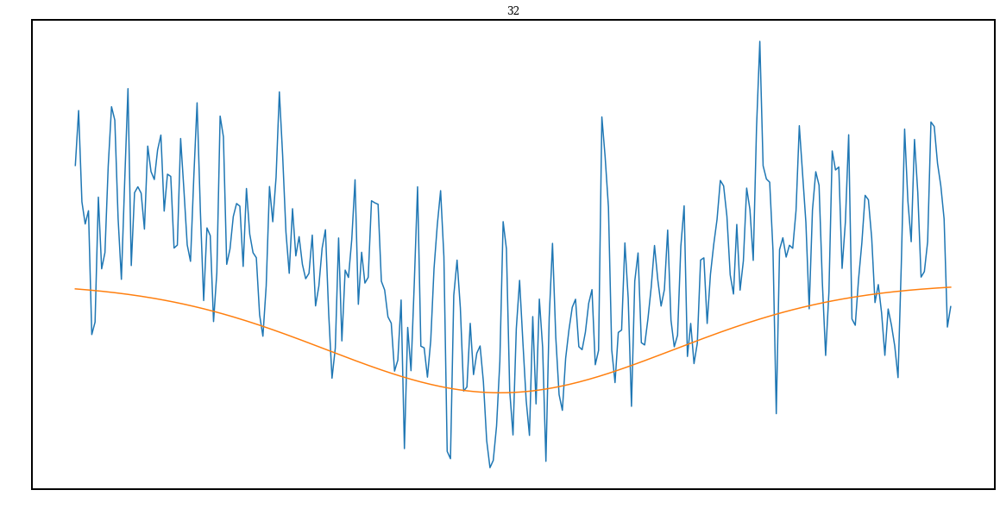

Parameters([('amp', <Parameter 'amp', value=-0.12567792318185567 +/- 0.0104, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637601638649895 +/- 9.18e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.3559774884587028e-08 +/- 5.4e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5584917551884514 +/- 0.00692, bounds=[-inf:inf]>)])


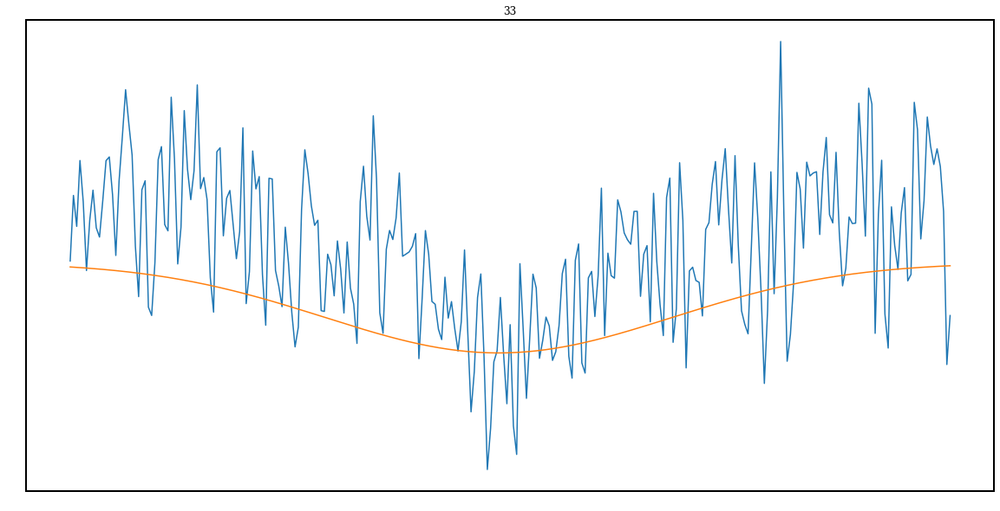

Parameters([('amp', <Parameter 'amp', value=-0.14268645647181236 +/- 0.0131, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637600395080674 +/- 7.66e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.1753838202994571e-08 +/- 2.72e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5501080229397002 +/- 0.00591, bounds=[-inf:inf]>)])


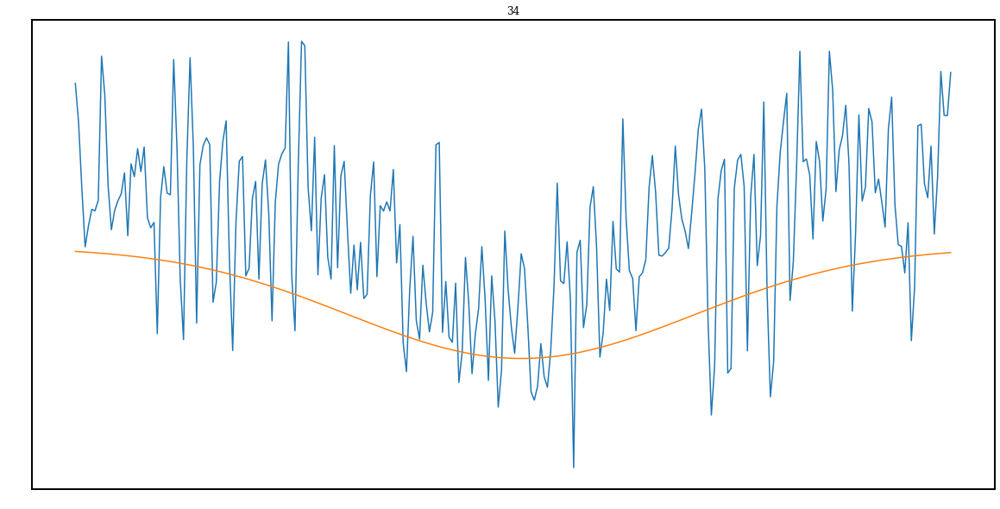

Parameters([('amp', <Parameter 'amp', value=-0.12206090400785116 +/- 0.0112, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637582664080534 +/- 9.28e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.8363542847553443e-08 +/- 4.46e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5546465811003717 +/- 0.00633, bounds=[-inf:inf]>)])


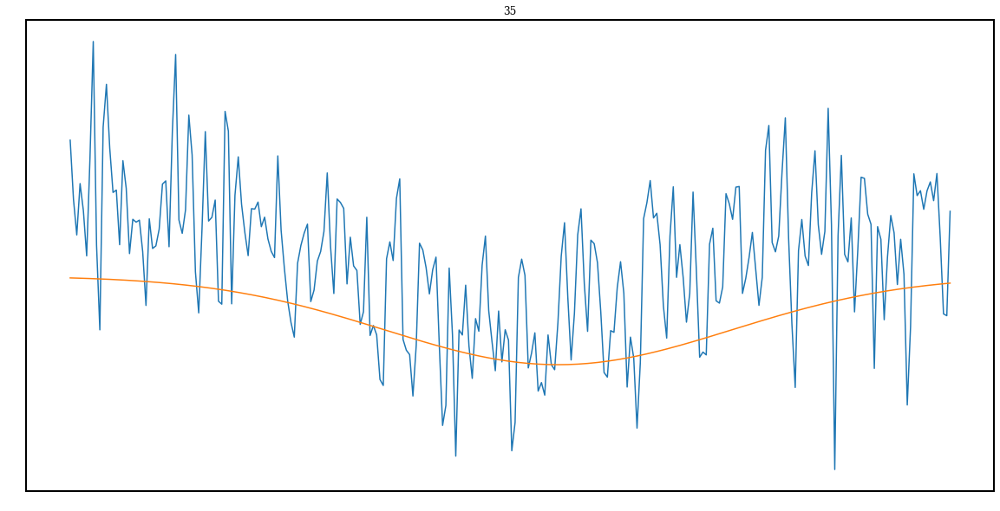

Parameters([('amp', <Parameter 'amp', value=-0.13183723187273627 +/- 0.012, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637551131885302 +/- 1.06e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.851253114046335e-08 +/- 7.41e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5658859414156358 +/- 0.00901, bounds=[-inf:inf]>)])


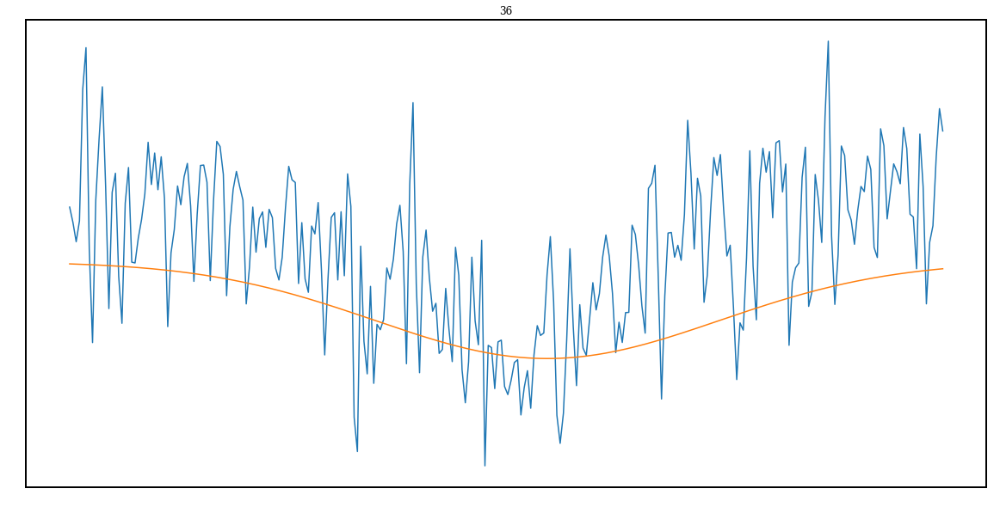

Parameters([('amp', <Parameter 'amp', value=-0.15059385939823436 +/- 0.0108, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637551265253394 +/- 8.01e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.4294638233449937e-08 +/- 4.82e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5631420070336863 +/- 0.00726, bounds=[-inf:inf]>)])


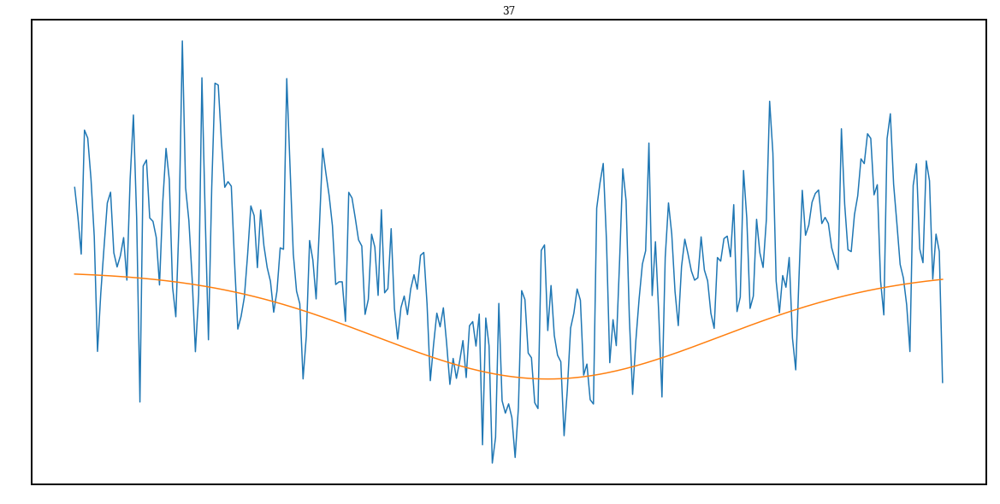

Parameters([('amp', <Parameter 'amp', value=-0.12560824000087414 +/- 0.0107, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637555064070063 +/- 7.72e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.4045870610874706e-08 +/- 3.08e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5386130177492766 +/- 0.00529, bounds=[-inf:inf]>)])


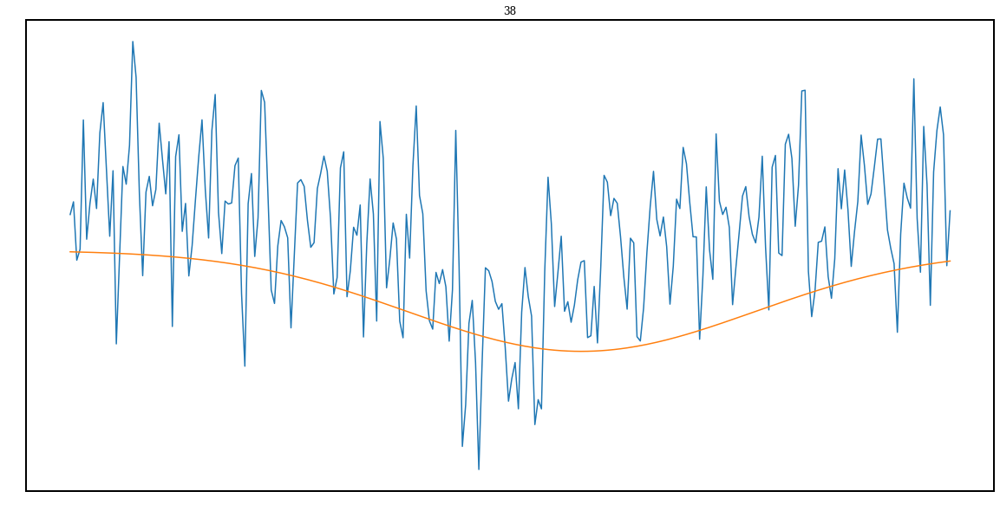

Parameters([('amp', <Parameter 'amp', value=-0.12268989612481647 +/- 0.0117, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375275335615305 +/- 7.74e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.094932648992541e-08 +/- 2.64e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5452897829576884 +/- 0.00512, bounds=[-inf:inf]>)])


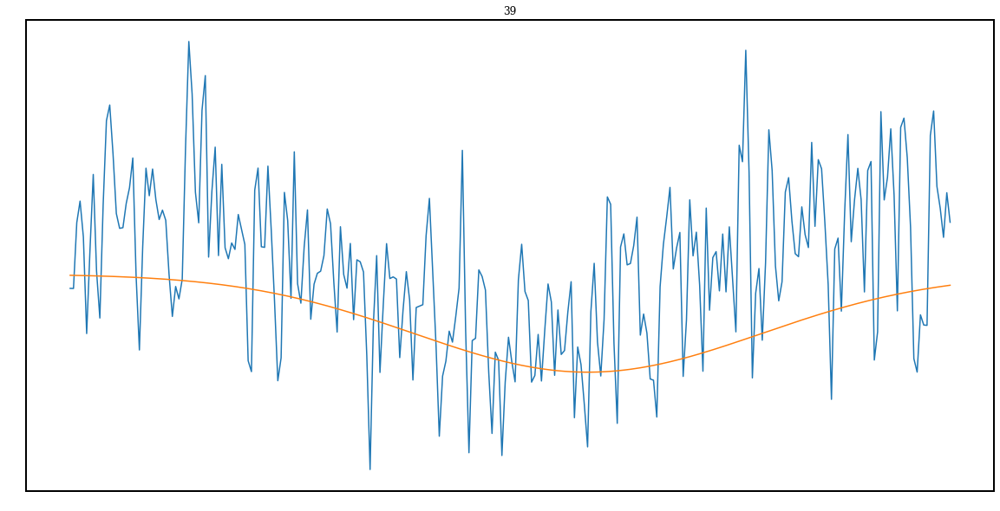

Parameters([('amp', <Parameter 'amp', value=-0.12802126315792564 +/- 0.0118, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375200089137 +/- 1.08e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.042592403456823e-08 +/- 8.05e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.557718189775971 +/- 0.00923, bounds=[-inf:inf]>)])


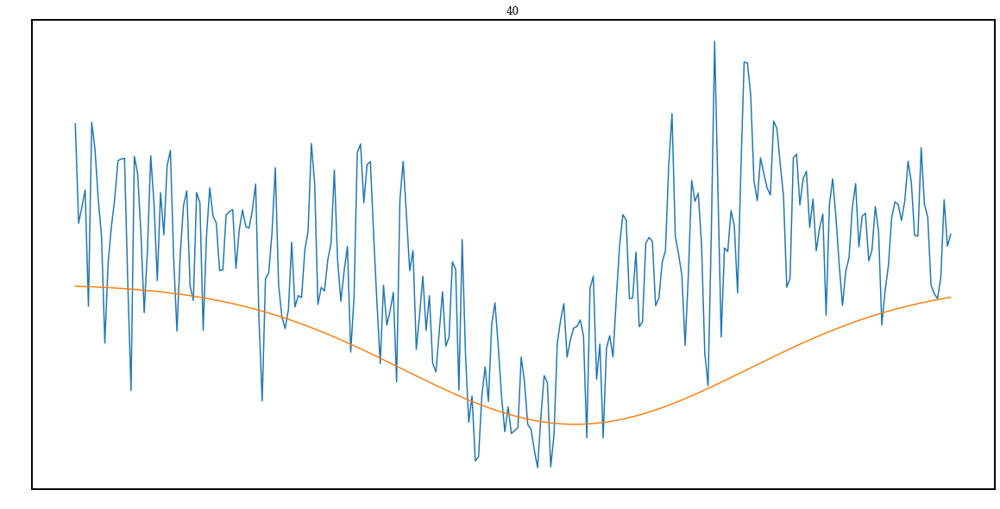

Parameters([('amp', <Parameter 'amp', value=-0.12668189531544663 +/- 0.00862, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375388341496064 +/- 5.02e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=8.892566092001112e-09 +/- 1.5e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5403136303480681 +/- 0.00346, bounds=[-inf:inf]>)])


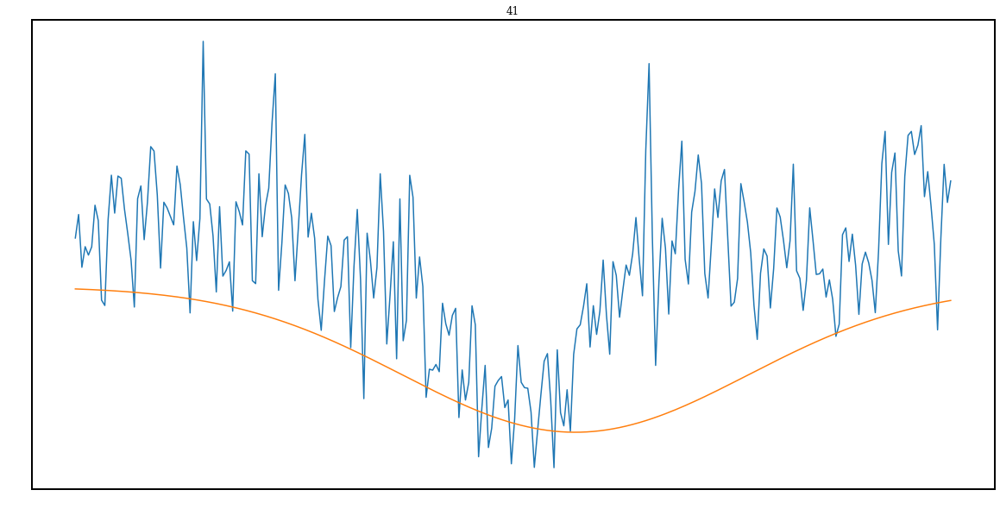

Parameters([('amp', <Parameter 'amp', value=-0.12422082016485948 +/- 0.00761, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637531423440704 +/- 4.35e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=8.178909586177689e-09 +/- 1.24e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5388409771141891 +/- 0.00295, bounds=[-inf:inf]>)])


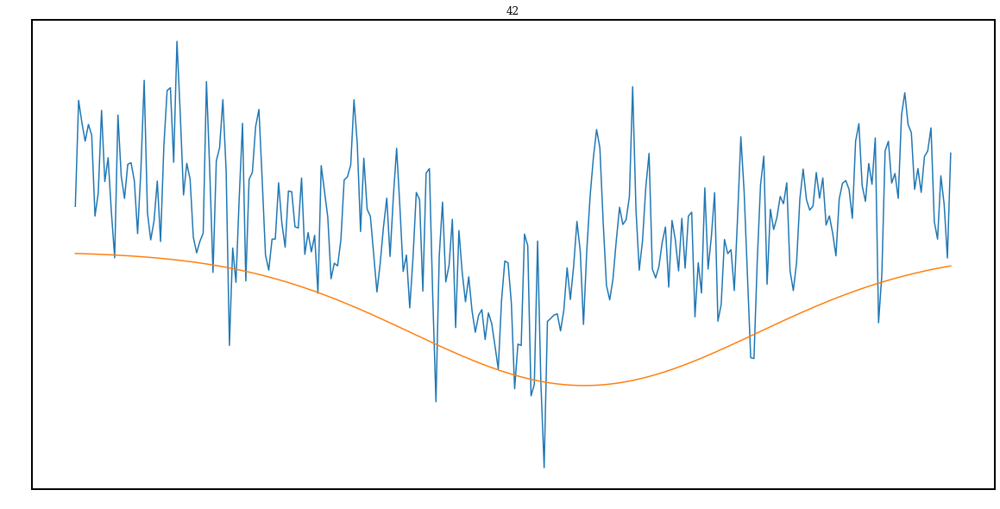

Parameters([('amp', <Parameter 'amp', value=-0.08836193294454182 +/- 0.00961, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375488173591353 +/- 1.11e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=5.1857109765295595e-08 +/- 1.59e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5646806480396717 +/- 0.01, bounds=[-inf:inf]>)])


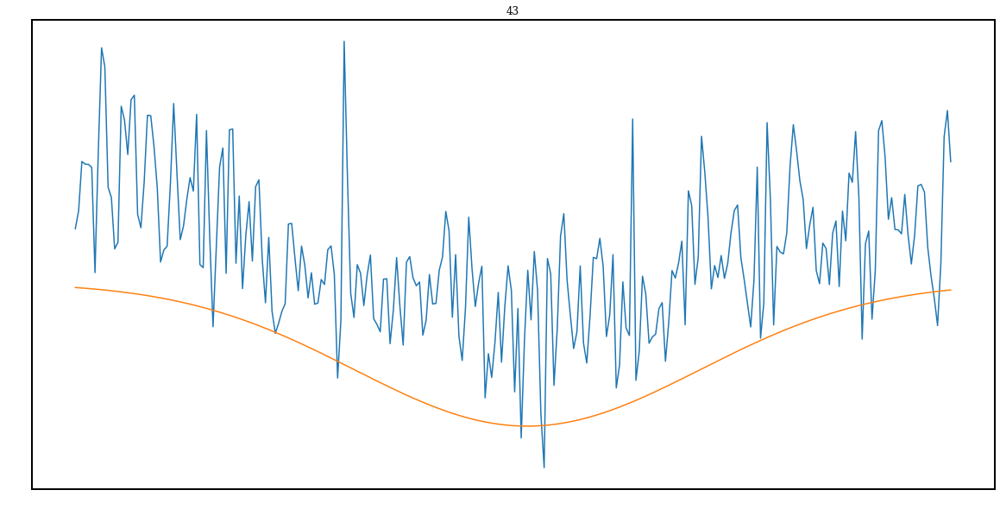

Parameters([('amp', <Parameter 'amp', value=-0.11453019047000919 +/- 0.0235, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.63759350863991 +/- 9.92e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=9.579906510483652e-08 +/- 3.98e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5931738092982448 +/- 0.0253, bounds=[-inf:inf]>)])


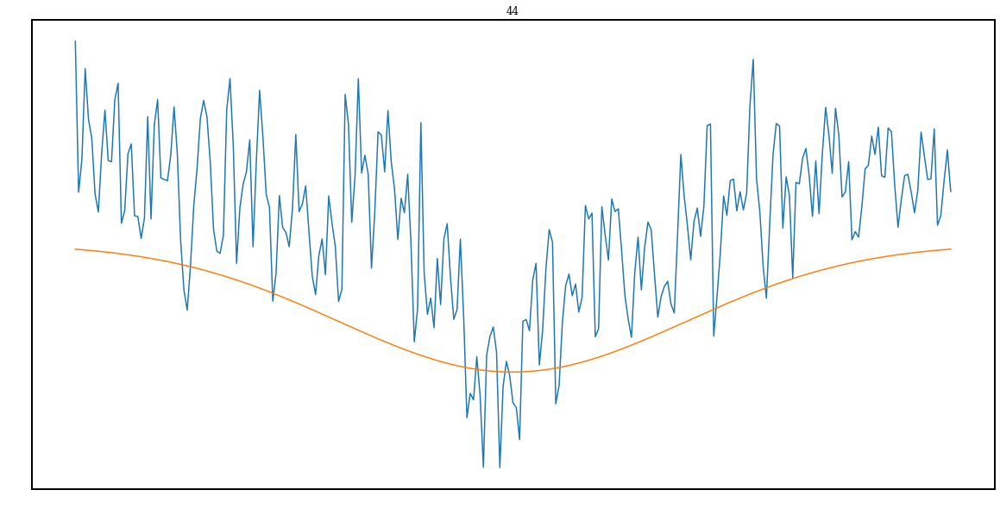

Parameters([('amp', <Parameter 'amp', value=-0.12893428761207976 +/- 0.00853, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375969762463565 +/- 5.57e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.1886606542133193e-08 +/- 1.99e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5483771339304346 +/- 0.00389, bounds=[-inf:inf]>)])


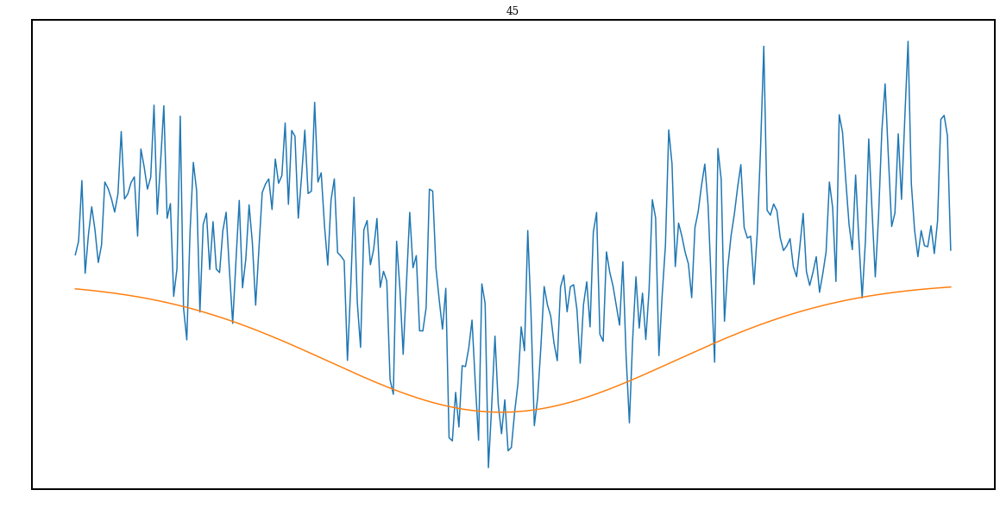

Parameters([('amp', <Parameter 'amp', value=-0.12126998971054206 +/- 0.00828, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375967785442787 +/- 6.13e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.3736493759379764e-08 +/- 2.41e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5551924350591219 +/- 0.00403, bounds=[-inf:inf]>)])


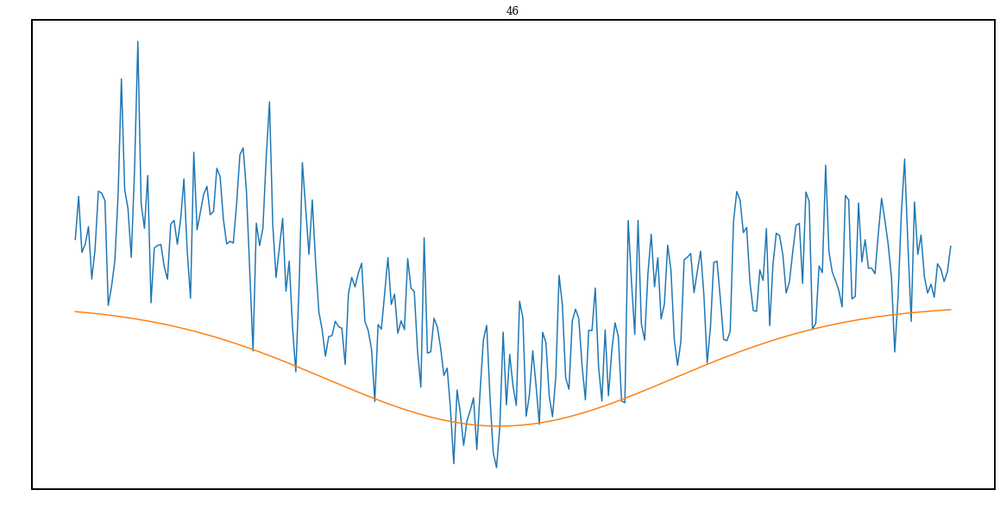

Parameters([('amp', <Parameter 'amp', value=-0.12207966212011429 +/- 0.00717, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375995924076725 +/- 6.42e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.272457084724024e-08 +/- 3.66e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5569899661575759 +/- 0.00465, bounds=[-inf:inf]>)])


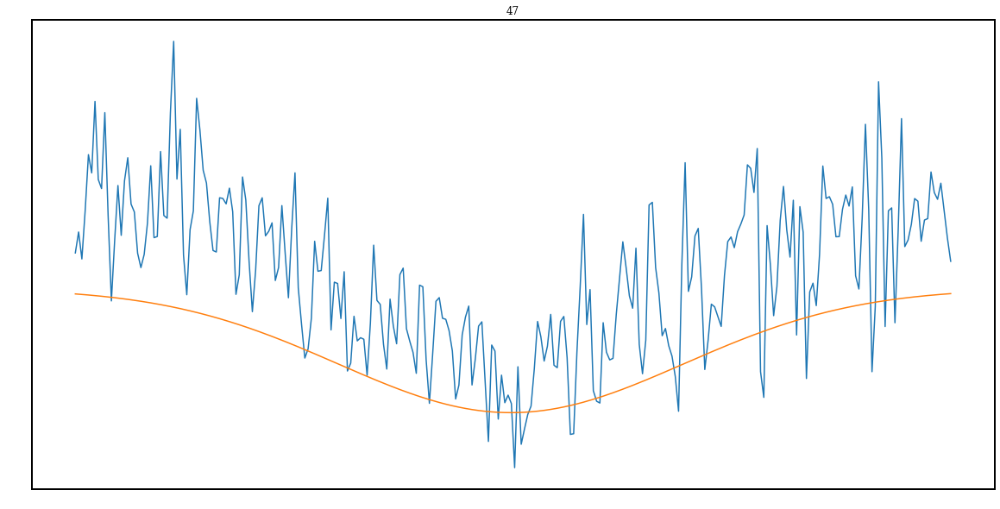

Parameters([('amp', <Parameter 'amp', value=-0.1335985731904224 +/- 0.00823, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375940094798542 +/- 7.1e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=4.010832623291587e-08 +/- 7.28e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5701383827481384 +/- 0.00772, bounds=[-inf:inf]>)])


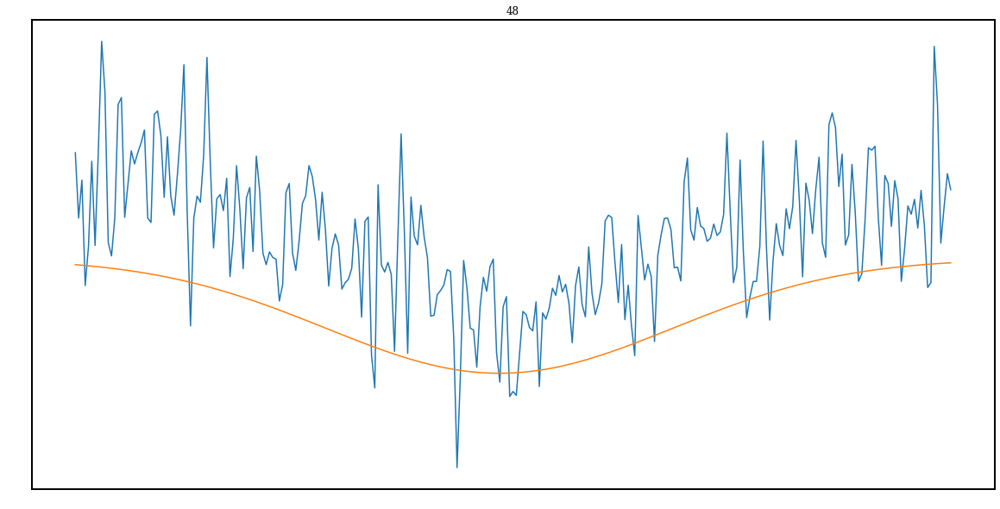

Parameters([('amp', <Parameter 'amp', value=-0.11083653739790139 +/- 0.00794, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6376050858656006 +/- 8.42e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.31966701483925e-08 +/- 6.93e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5623382500244462 +/- 0.00664, bounds=[-inf:inf]>)])


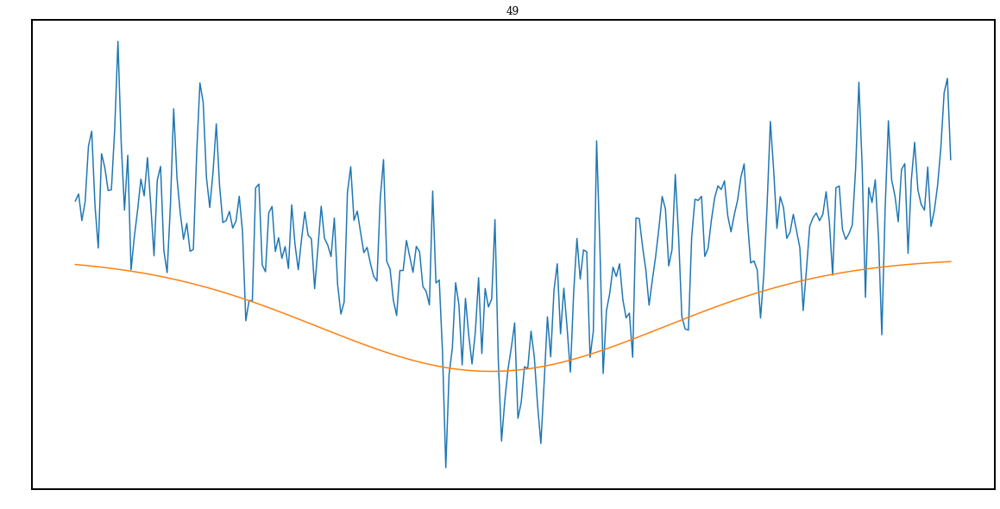

Parameters([('amp', <Parameter 'amp', value=-0.12261569860645255 +/- 0.00761, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637609500194858 +/- 6.6e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.0966287555467696e-08 +/- 3.51e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5522676025847869 +/- 0.00466, bounds=[-inf:inf]>)])


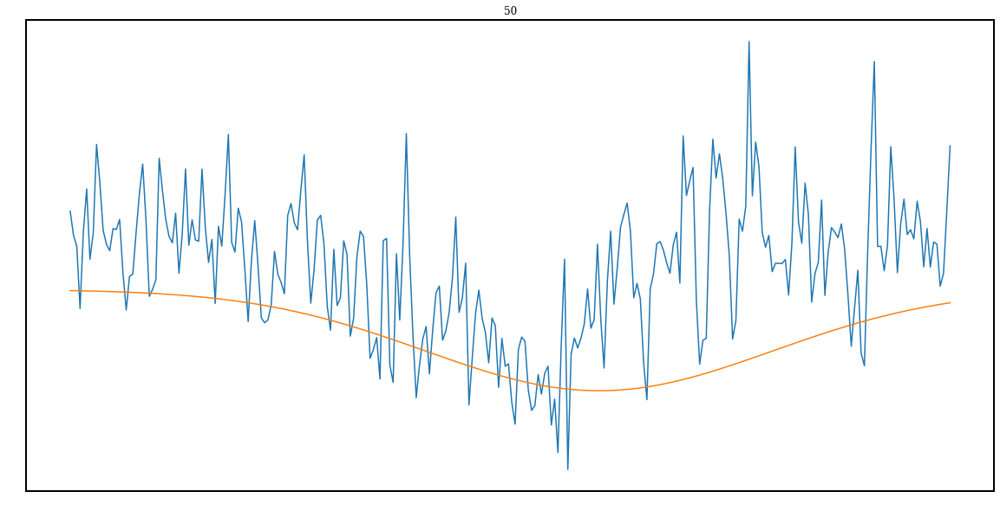

Parameters([('amp', <Parameter 'amp', value=-0.1240813814044736 +/- 0.00991, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375079404156927 +/- 7.08e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.3241511866204726e-08 +/- 2.72e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.552070651828154 +/- 0.00475, bounds=[-inf:inf]>)])


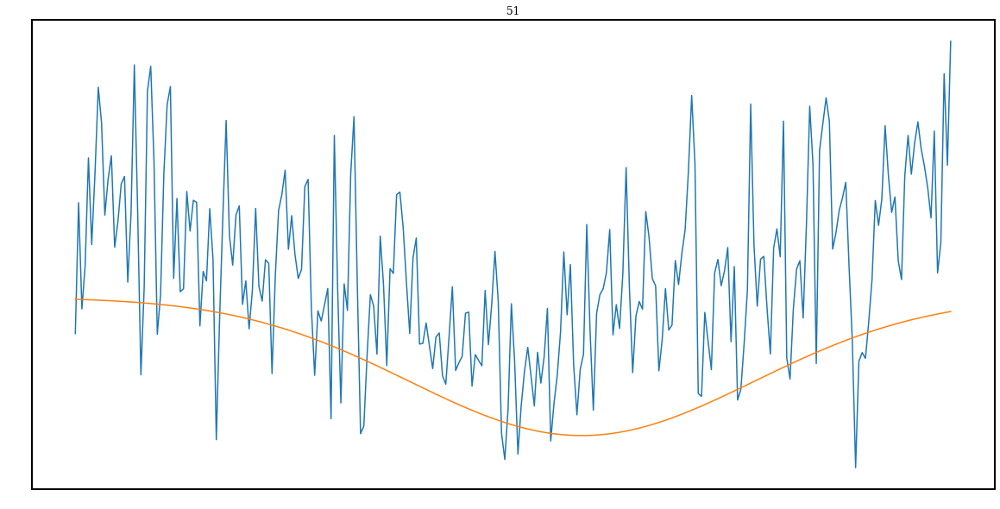

Parameters([('amp', <Parameter 'amp', value=-0.12756728698499198 +/- 0.0298, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375302259330846 +/- 1.15e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=9.240724647227502e-08 +/- 4.46e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5981634821371463 +/- 0.0323, bounds=[-inf:inf]>)])


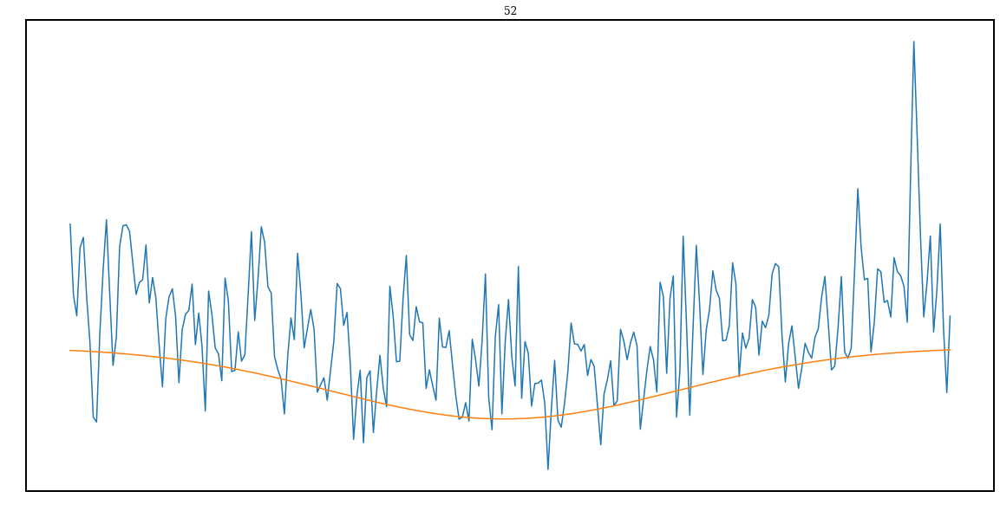

Parameters([('amp', <Parameter 'amp', value=-0.196718081152132 +/- 0.1, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375823576244213 +/- 1.23e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.5342485811327652e-07 +/- 1.23e-07, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.6665296730831797 +/- 0.104, bounds=[-inf:inf]>)])


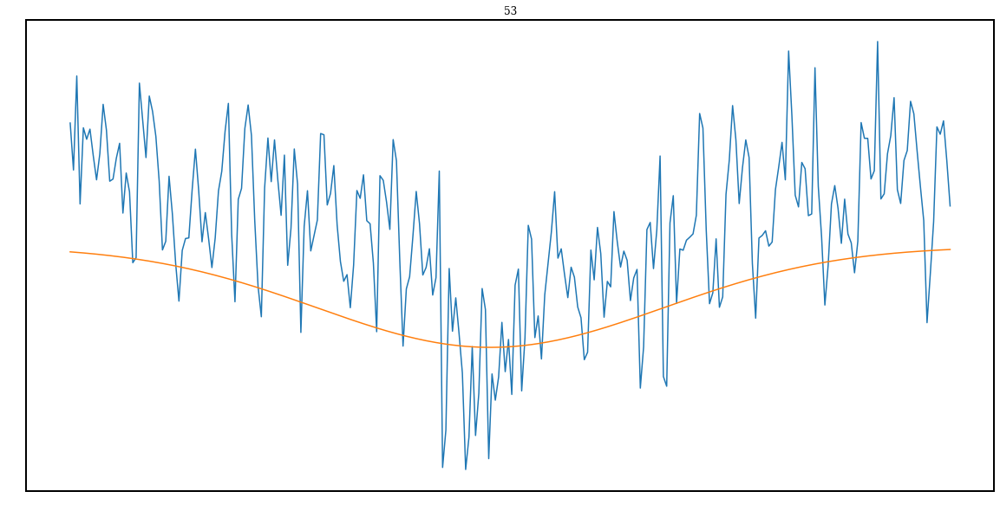

Parameters([('amp', <Parameter 'amp', value=-0.14655348871069587 +/- 0.0105, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637612421246328 +/- 7.68e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.155931173401089e-08 +/- 4.18e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5651879429509483 +/- 0.00653, bounds=[-inf:inf]>)])


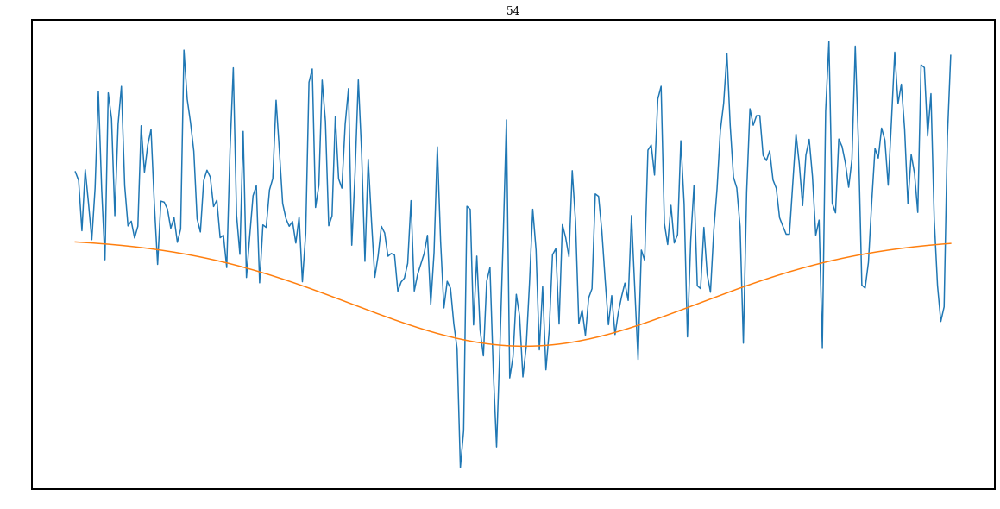

Parameters([('amp', <Parameter 'amp', value=-0.12487416281567794 +/- 0.0109, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637581687408955 +/- 8.11e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.4909871474150943e-08 +/- 3.37e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5559786079855592 +/- 0.00554, bounds=[-inf:inf]>)])


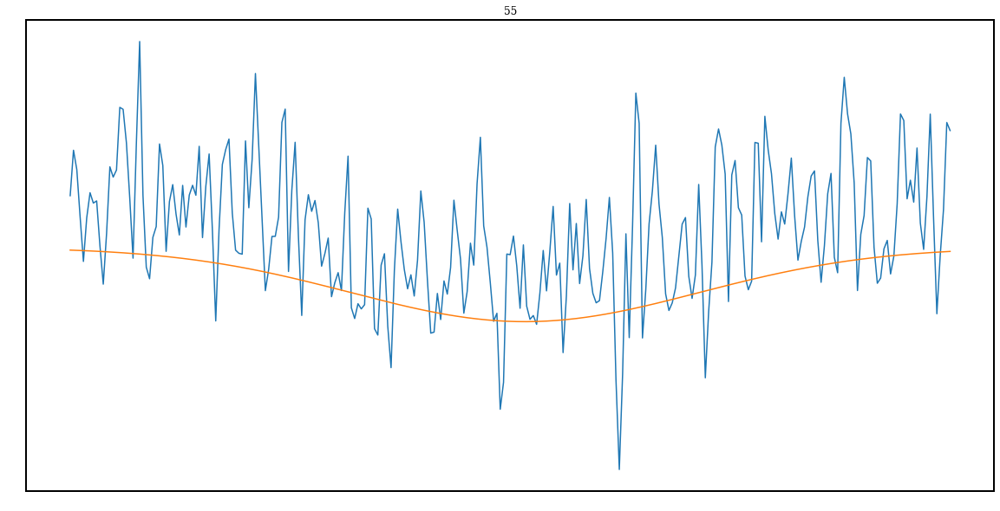

Parameters([('amp', <Parameter 'amp', value=-0.12543654785635822 +/- 0.0145, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375735969429153 +/- 1.34e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.8540348834441675e-08 +/- 1.32e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5748433100347943 +/- 0.0134, bounds=[-inf:inf]>)])


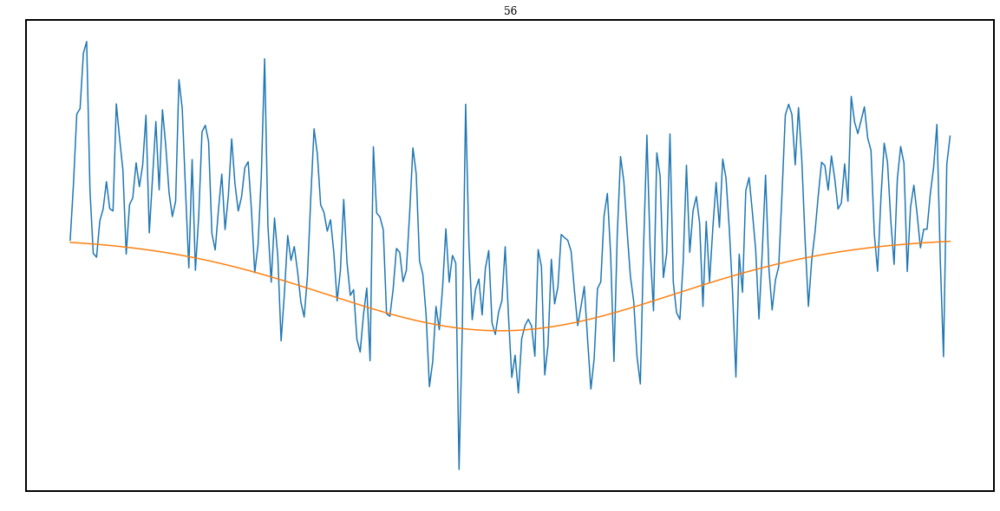

Parameters([('amp', <Parameter 'amp', value=-0.1379861047404848 +/- 0.0128, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375976034036133 +/- 1.04e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=4.353596440621437e-08 +/- 1.19e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5689540629002817 +/- 0.0126, bounds=[-inf:inf]>)])


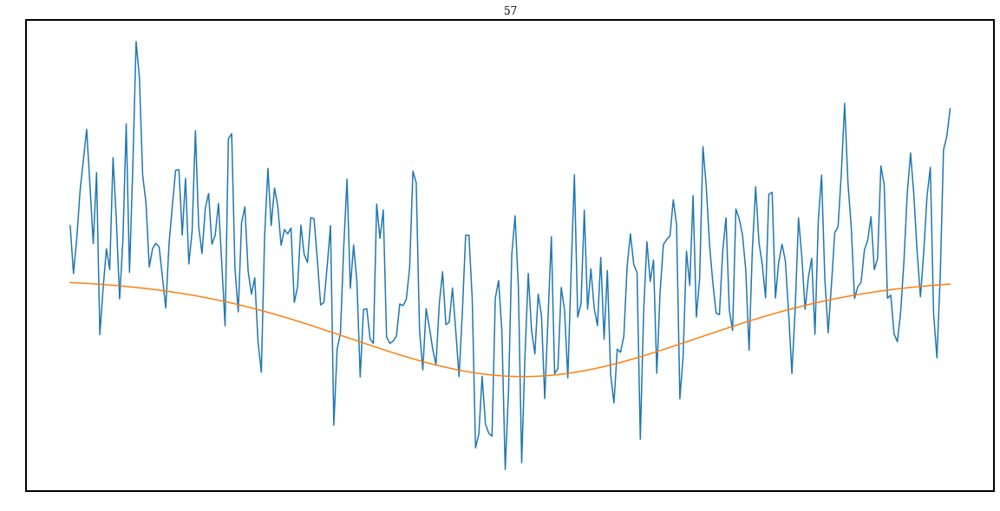

Parameters([('amp', <Parameter 'amp', value=-0.10936911873850216 +/- 0.0115, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637583629541483 +/- 1.24e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.638549254338333e-08 +/- 1.13e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5563489577342237 +/- 0.0102, bounds=[-inf:inf]>)])


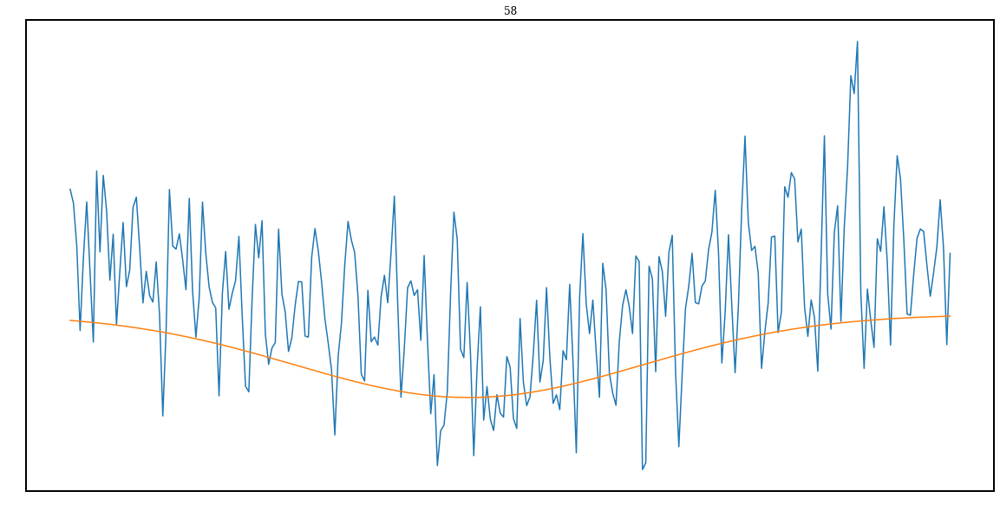

Parameters([('amp', <Parameter 'amp', value=-0.13385027782624023 +/- 0.0137, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6376125665496564 +/- 1.19e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.814997083321831e-08 +/- 1.15e-08, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5774152830205663 +/- 0.0125, bounds=[-inf:inf]>)])


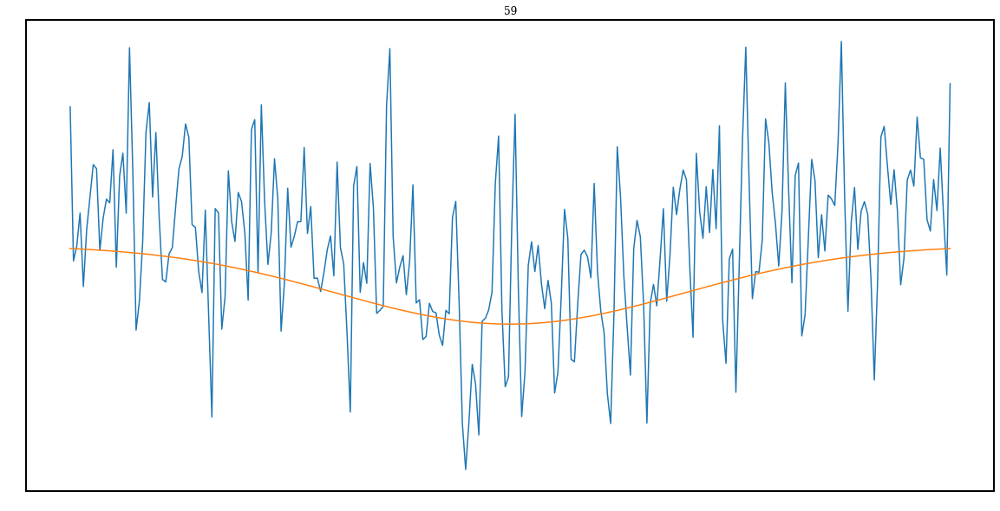

Parameters([('amp', <Parameter 'amp', value=-0.13293562063784162 +/- 0.0152, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375886545958904 +/- 1.31e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.6812281974787137e-08 +/- 8.63e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5506233005433436 +/- 0.0109, bounds=[-inf:inf]>)])


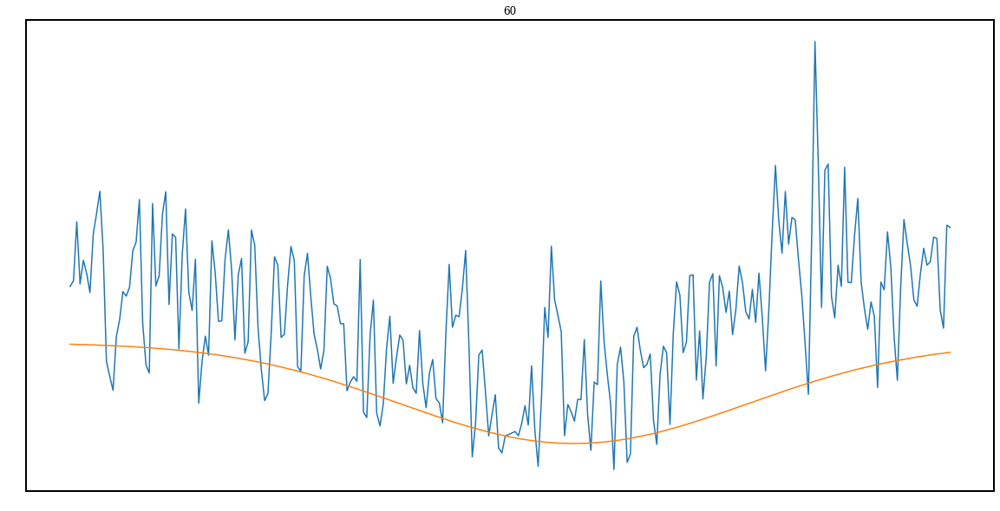

Parameters([('amp', <Parameter 'amp', value=-0.12695843078190752 +/- 0.00987, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375298156009506 +/- 9.14e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.6588372087721315e-08 +/- 8.35e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5746266754967394 +/- 0.00874, bounds=[-inf:inf]>)])


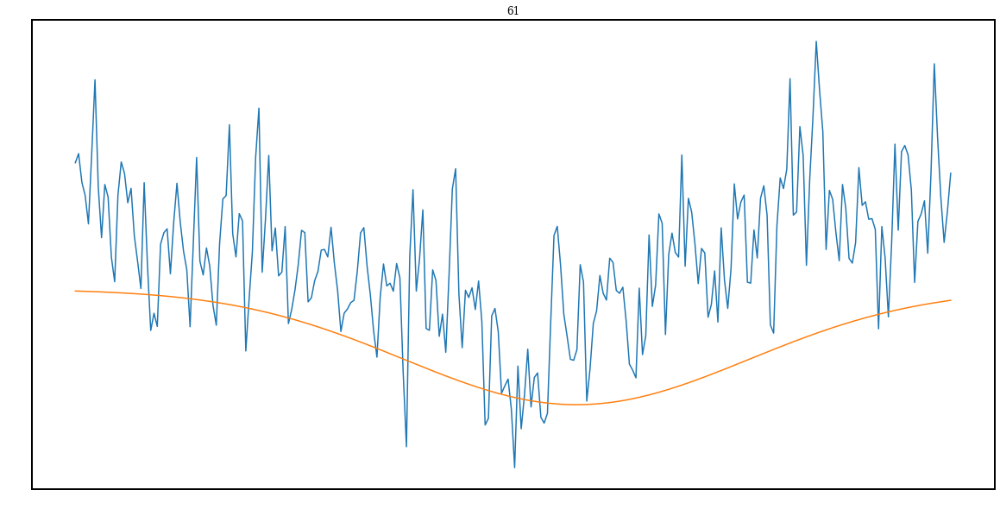

Parameters([('amp', <Parameter 'amp', value=-0.11527632320654153 +/- 0.00854, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637525582914475 +/- 8.74e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.242755737756728e-08 +/- 6.97e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.570794555337605 +/- 0.00698, bounds=[-inf:inf]>)])


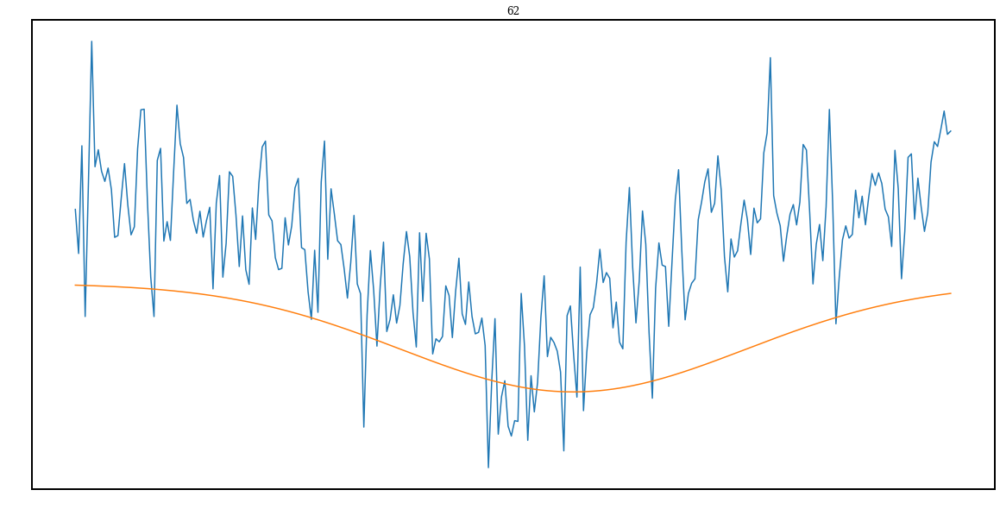

Parameters([('amp', <Parameter 'amp', value=-0.14944052213070005 +/- 0.00791, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375330218314157 +/- 5.82e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.2949212575991725e-08 +/- 3.34e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5802325558749134 +/- 0.00513, bounds=[-inf:inf]>)])


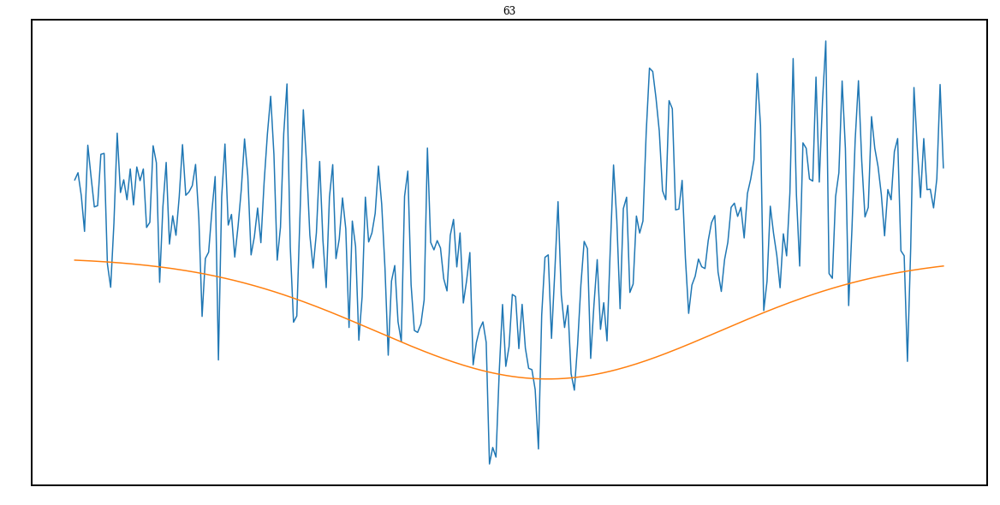

Parameters([('amp', <Parameter 'amp', value=-0.11824435799070265 +/- 0.00996, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375532545312854 +/- 6.52e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=9.8471172319123e-09 +/- 2.08e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5482112494993366 +/- 0.00418, bounds=[-inf:inf]>)])


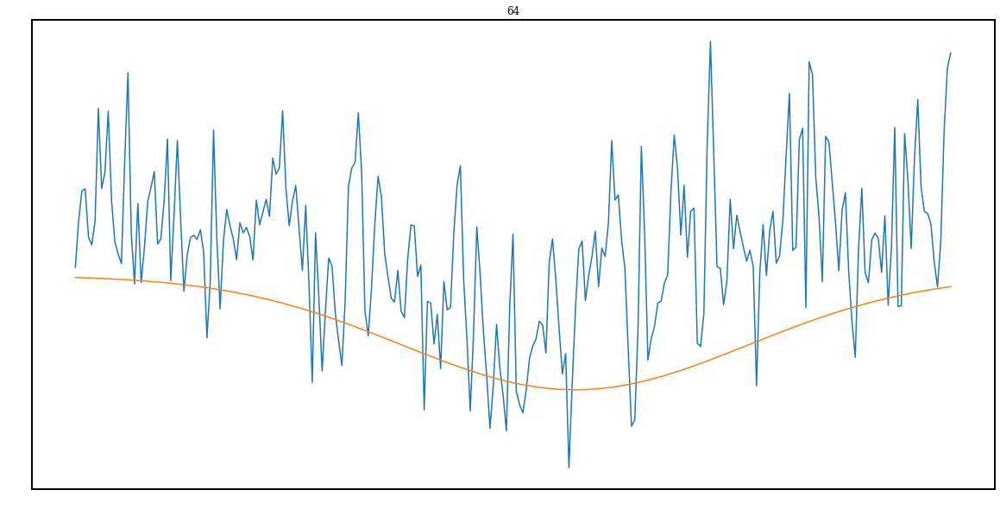

Parameters([('amp', <Parameter 'amp', value=-0.10189173941674955 +/- 0.0104, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6375322364034965 +/- 9.87e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.6200110689845753e-08 +/- 4.33e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5505451750091263 +/- 0.00554, bounds=[-inf:inf]>)])


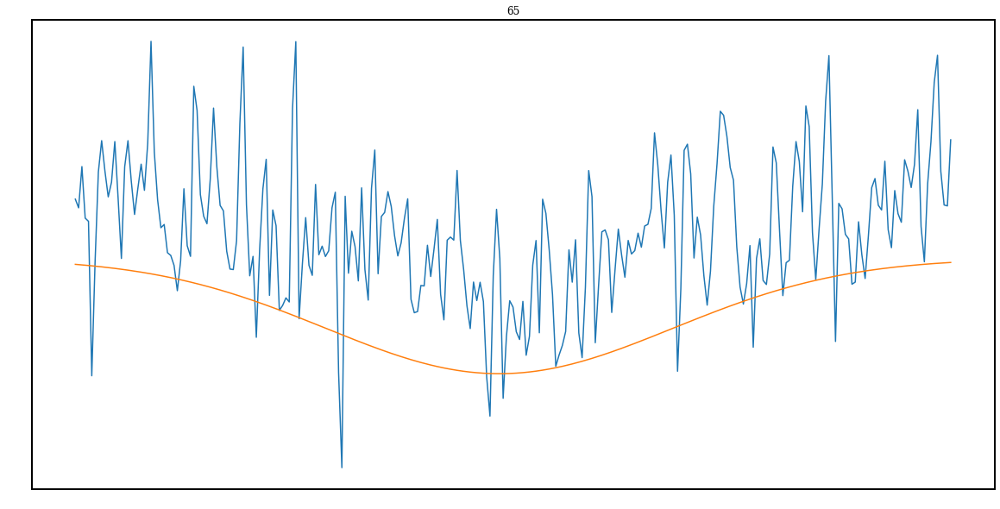

Parameters([('amp', <Parameter 'amp', value=-0.07948317433197197 +/- 0.00918, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637589650720491 +/- 1.34e-05, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=2.828507169872778e-08 +/- 9.31e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5522044748918513 +/- 0.00687, bounds=[-inf:inf]>)])


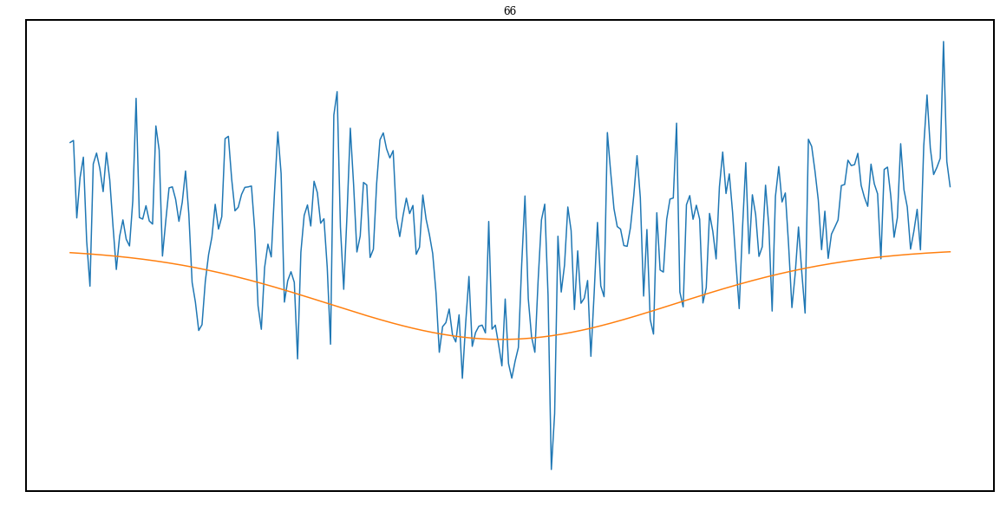

Parameters([('amp', <Parameter 'amp', value=-0.134142947195268 +/- 0.0134, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637594281554498 +/- 5.85e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=5.410830203406137e-09 +/- 1.32e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5404901770627731 +/- 0.00446, bounds=[-inf:inf]>)])


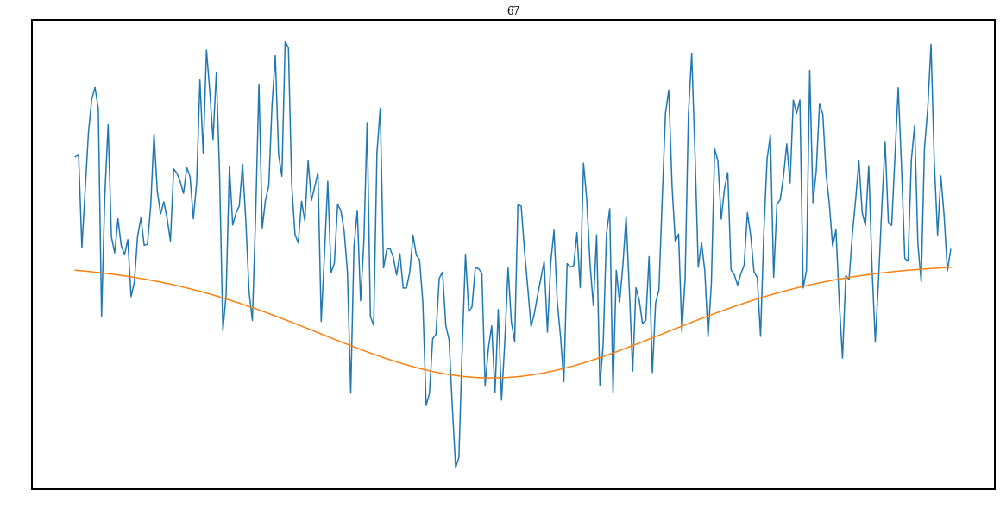

Parameters([('amp', <Parameter 'amp', value=-0.10956007706886316 +/- 0.0105, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.637603181989925 +/- 9.87e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.9278949494288466e-08 +/- 4.91e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5597510155077435 +/- 0.0061, bounds=[-inf:inf]>)])


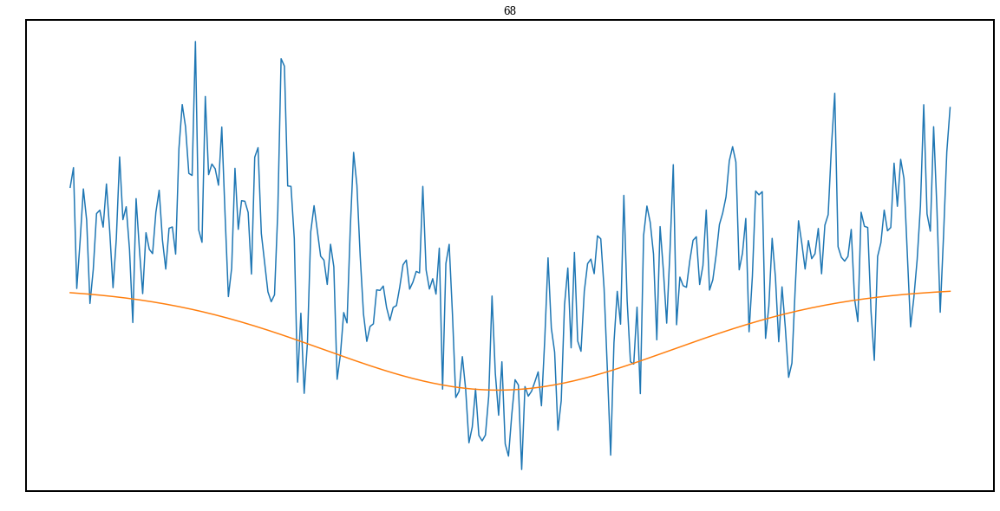

Parameters([('amp', <Parameter 'amp', value=-0.14624635454530666 +/- 0.0112, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6376006593281835 +/- 6.77e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=1.33272938920959e-08 +/- 2.6e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.557339561908794 +/- 0.00535, bounds=[-inf:inf]>)])


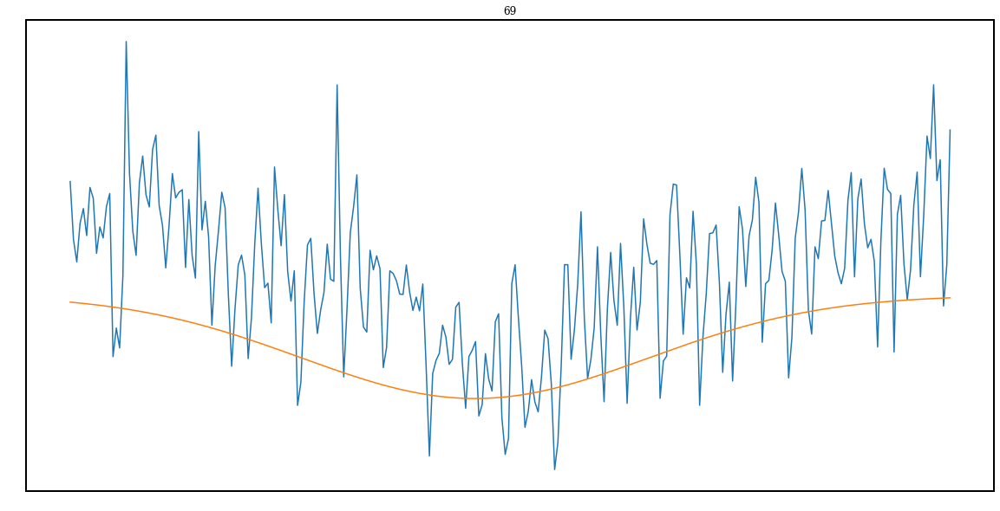

Parameters([('amp', <Parameter 'amp', value=-0.1281517834709659 +/- 0.0099, bounds=[-inf:inf]>), ('cen', <Parameter 'cen', value=3.6376237541682204 +/- 9.12e-06, bounds=[-inf:inf]>), ('wid', <Parameter 'wid', value=3.253415067014331e-08 +/- 7.32e-09, bounds=[-inf:inf]>), ('off', <Parameter 'off', value=0.5694284723804489 +/- 0.00813, bounds=[-inf:inf]>)])


In [3]:
def fit_function(params, x1=None, dat1=None):
    #1 is alpha 6562.801
    #4861.363 be -0.13033118436
    #ga 4340.472
    model1 = gaussian(x1, params['amp'], params['cen'], params['wid'], params['off'])
    resid1 = dat1 - model1
    return resid1


params = Parameters()
params.add('amp', value = -0.1)
params.add('cen', value=np.log10(4341))
params.add('wid', value=0.00000005)
params.add('off', value=0.5)#, min=0.001,max=1)


path = '/home/nwal/Desktop/binaries/WD0137UVES/'
fluxes = []
wavels = []
count = 0
with open(path+'Bs') as file:
    for line in file:
        line = line.strip('\n')
        line = path+line
        wvl, flx = pyasl.read1dFitsSpec(line)
        flx = flx/np.median(flx)
        fluxes.append(flx)
        wavels.append(np.log10(wvl))
        count = count+1
path = '/home/nwal/Desktop/binaries/WD0137UVES/'
dates2 = []
with open(path+'Bs') as file:
    for line in file:
        line = line.strip('\n')
        line = path+line
        hdul = fits.open(line)
        dates2.append(hdul[0].header['MJD-OBS'])
        hdul.close()

count=0
wavelsAng = np.array(wavels)


globalOff = []
for el in fluxes:

    mod = Model(gaussian)
    indexSt = find_nearest(wavelsAng[count], np.log10(4338))
    indexFi = find_nearest(wavelsAng[count], np.log10(4344))
    fluxIn = fluxes[count][indexSt:indexFi+1]
    pixels = wavelsAng[count][indexSt:indexFi+1]
    pars = mod.make_params(amp=-0.06,cen=np.log10(4341),wid=0.00000005,off=0.45)
    result = mod.fit(fluxIn,pars,x=pixels)
    cenEst = result.params['cen'].value
    indexSt = find_nearest(wavelsAng[count], cenEst-0.0004)
    indexFi = find_nearest(wavelsAng[count], cenEst+0.0004)
    fluxIn = fluxes[count][indexSt:indexFi+1]
    pixels = wavelsAng[count][indexSt:indexFi+1]
    x1Final = pixels
    dat1Final = fluxIn
    #beta
    
    out = minimize(fit_function, params, args=(x1Final, dat1Final))
    globalOff.append(out.params['cen'].value)
    count = count+1
    
    
    

    rc('axes', linewidth=2)

    plt.figure(figsize=(20,10))
    plt.title(str(count-1))
    plt.plot(10**x1Final,dat1Final)
    plt.plot(10**x1Final, gaussian(x1Final, params['amp'], params['cen'], params['wid'], params['off']))
    plt.show()
    print(out.params)
    params = Parameters()
    params.add('amp', value = -0.1)
    params.add('cen', value=np.log10(4341))
    params.add('wid', value=0.00000005)
    params.add('off', value=0.5)#, min=0.001,max=1)
    
    #errorsTwo.append(out.params['offsetx'].stderr)

In [4]:
esovlt = EarthLocation.from_geodetic(lat=-24.6275*u.deg, lon=-70.4044*u.deg, height=2635*u.m)
sc = SkyCoord("01:39:42.8531448117 -34:42:39.576295162", frame=ICRS, unit=(u.hourangle, u.deg))
baryCorr = []
for el in dates2:
    barycorr = sc.radial_velocity_correction(obstime=Time(el, format='mjd'), location=esovlt)  
    baryCorr.append(barycorr.to(u.km/u.s).value)
print(baryCorr)

[-15.321903668601571, -15.330067302250562, -15.33834899326864, -15.346696805417304, -15.355165832687963, -15.363779948110665, -15.372456460856021, -15.38125528744991, -15.390139546280937, -15.399119814326909, -15.408246606248404, -15.417401815383252, -15.42662661470356, -15.435926170597172, -15.445291865161845, -15.45472148566732, -15.46419811829514, -15.473733643144547, -15.483358018395261, -15.492951489012409, 10.66405551990992, 10.65558241772212, 10.647115021549961, 10.638643107455293, 10.630180641590051, 10.621720938267673, 10.613285428230611, 10.60486157612443, 10.596465843509357, 10.588090478756692, 2.5957557689502093, 2.5876405225042363, 2.5794774568407144, 2.5712576108697016, 2.5629799093962036, 2.554666763632402, 2.5462981854823257, 2.537875337610399, 2.5294296193450685, 2.520944935712213, -2.1690381464467294, -2.1776693447688222, -2.186281832254971, -2.194876056303985, -2.203437199301622, -2.211957806742311, -2.2204466663747495, -2.228905630201015, -2.2373225488571507, -2.245

In [5]:
rawOffsets = globalOff

In [7]:
print(rawOffsets) #3920-3940
print(len(rawOffsets))

[3.6375469819731343, 3.637622213759019, 3.637622029785032, 3.637627547902675, 3.637630720223962, 3.637613377029964, 3.637621262982031, 3.6376228107027857, 3.637600680834312, 3.6375996853431913, 3.6375863887550115, 3.637566730242514, 3.6375613349862967, 3.637567572755442, 3.6375543967298296, 3.637545128041711, 3.6375376683079064, 3.637548598926941, 3.6375109693283596, 3.6375483732241194, 3.6375784199831656, 3.6375610451432596, 3.6375640642409732, 3.6375832953454847, 3.6375704713821535, 3.6375703496795393, 3.6375549111794663, 3.6375435189265444, 3.6375300841855602, 3.637525157941886, 3.637644739705405, 3.6376066143069408, 3.637601638649895, 3.637600395080674, 3.637582664080534, 3.637551131885302, 3.637551265253394, 3.637555064070063, 3.6375275335615305, 3.6375200089137, 3.6375388341496064, 3.637531423440704, 3.6375488173591353, 3.63759350863991, 3.6375969762463565, 3.6375967785442787, 3.6375995924076725, 3.6375940094798542, 3.6376050858656006, 3.637609500194858, 3.6375079404156927, 3.637

In [7]:
wavels[0]

array([3.51613898, 3.51614271, 3.51614643, ..., 3.65924188, 3.65924456,
       3.65924724])

In [8]:
len(wavels)

70

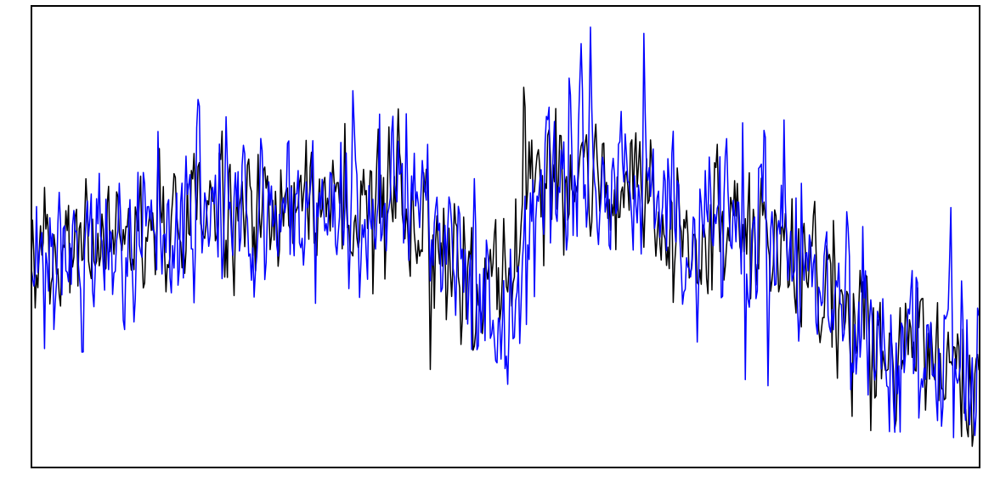

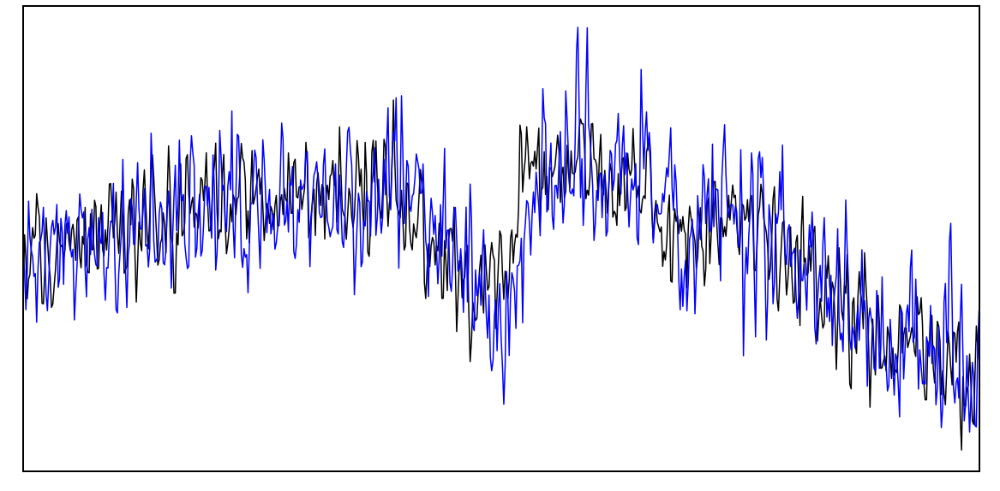

In [7]:

shift = np.array([-1.00230022117564e-05,-8.52547880962895e-05,-8.5070814109578e-05,-9.05889317524e-05,-9.37612530393928e-05,-7.64180590415719e-05,-8.43040111084825e-05,-8.58517318631513e-05,-6.37218633894321e-05,-6.27263722687843e-05,-4.94297840889502e-05,-2.97712715915388e-05,-2.43760153741945e-05,-3.06137845194065e-05,-1.74377589070573e-05,-8.16907078826645e-06,-7.09336983817366e-07,-1.16399560186053e-05,2.59896425629513e-05,-1.14142531968398e-05,-4.14610122430048e-05,-2.40861723370678e-05,-2.71052700506758e-05,-4.63363745621948e-05,-3.35124112309515e-05,-3.33907086167429e-05,-1.79522085437256e-05,-6.55995562182099e-06,6.87478536232078e-06,1.18010290366399e-05,-0.000107780734483,-6.9655336018215e-05,-6.46796789722792e-05,-6.34361097513469e-05,-4.57051096116601e-05,-1.417291437944e-05,-1.43062824715656e-05,-1.81050991403531e-05,9.42540939208314e-06,1.69500572226866e-05,-1.87517868388554e-06,5.53553021864772e-06,-1.18583882127155e-05,-5.65496689874934e-05,-6.00172754339212e-05,-5.98195733561013e-05,-6.26334367499481e-05,-5.70505089316775e-05,-6.81268946780555e-05,-7.25412239357404e-05,2.90185552298539e-05,6.733037837936e-06,-4.53986534987294e-05,-7.54622754053358e-05,-4.4728438032493e-05,-3.66379719927146e-05,-6.06444326907152e-05,-4.66705705606252e-05,-7.56075787338162e-05,-5.16956249678735e-05,7.14336997198473e-06,1.13760564475207e-05,3.93713950685992e-06,-1.62955603628667e-05,4.72256742600763e-06,-5.26917495684565e-05,-5.7322583575381e-05,-6.62230190022761e-05,-6.37003572609984e-05,-8.67951972978176e-05])
    
adjWvl = []
count = 0
for el in wavels:
    
    newW = el+shift[count]
    newW = 10**newW
    adjWvl.append(newW)
    count = count + 1


from astropy import units as u
from specutils.manipulation import FluxConservingResampler, LinearInterpolatedResampler, SplineInterpolatedResampler

from astropy.nddata import StdDevUncertainty
from astropy.modeling import models
from specutils import Spectrum1D, SpectralRegion
from specutils.analysis import snr_derived
from astropy.io import fits as pyfits
from PyAstronomy import pyasl
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3920,3940,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
shiftedStack = adjAdjAdjFlux
count = 0.0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl
    else:
        cummulativeShifted = cummulativeShifted + fl
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3920,3940)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.array([-0.200600349656766,-0.200707231138328,-0.200815658273095,-0.200924951091541,-0.201035830905727,-0.201148610270691,-0.201262206565783,-0.201377404241573,-0.201493720429593,-0.20161129360777,-0.201730785133777,-0.201850648709046,-0.201971423386213,-0.202093176805649,-0.202215796138407,-0.202339252414563,-0.202463324191792,-0.202588167008998,-0.202714173090377,-0.202839774556215,0.139617981702683,0.13950704853809,0.139396190078884,0.13928527246927,0.139174478559568,0.139063720818156,0.138953279824688,0.138842991461407,0.138733071249492,0.138623417701589,0.033984648783692,0.033878400806298,0.033771526761023,0.033663909325776,0.033555534423685,0.033446695471096,0.033337130776046,0.033226855560592,0.033116280917012,0.033005196123614,-0.028397894935714,-0.028510897956671,-0.028623656008053,-0.02873617494738,-0.028848260776657,-0.028959815898583,-0.029070955365798,-0.029181703425438,-0.029291901013281,-0.02940160533885,-0.07080554648681,-0.070912621588126,-0.071020404859343,-0.071128728310516,-0.071237805018196,-0.071347416574277,-0.071457484329723,-0.071568053830434,-0.071679036261904,-0.071790482056239,-0.131684605782472,-0.13178316765953,-0.131882718833023,-0.131983326648746,-0.132084957202194,-0.132187325620145,-0.132290689663983,-0.132394912257195,-0.132499911737444,-0.132605634758681])

adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3920,3940,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0
unshiftedStack = adjAdjAdjFlux
medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(3920,3940)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')


1.0000262690990627

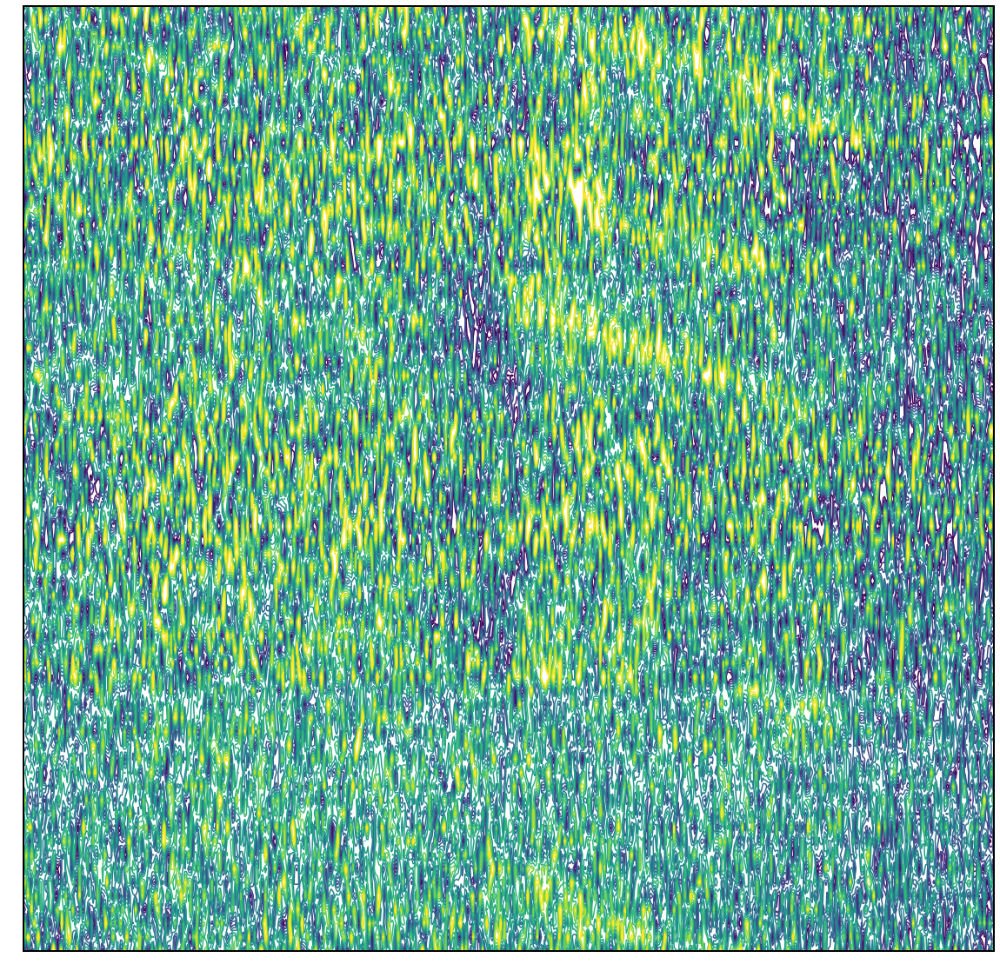

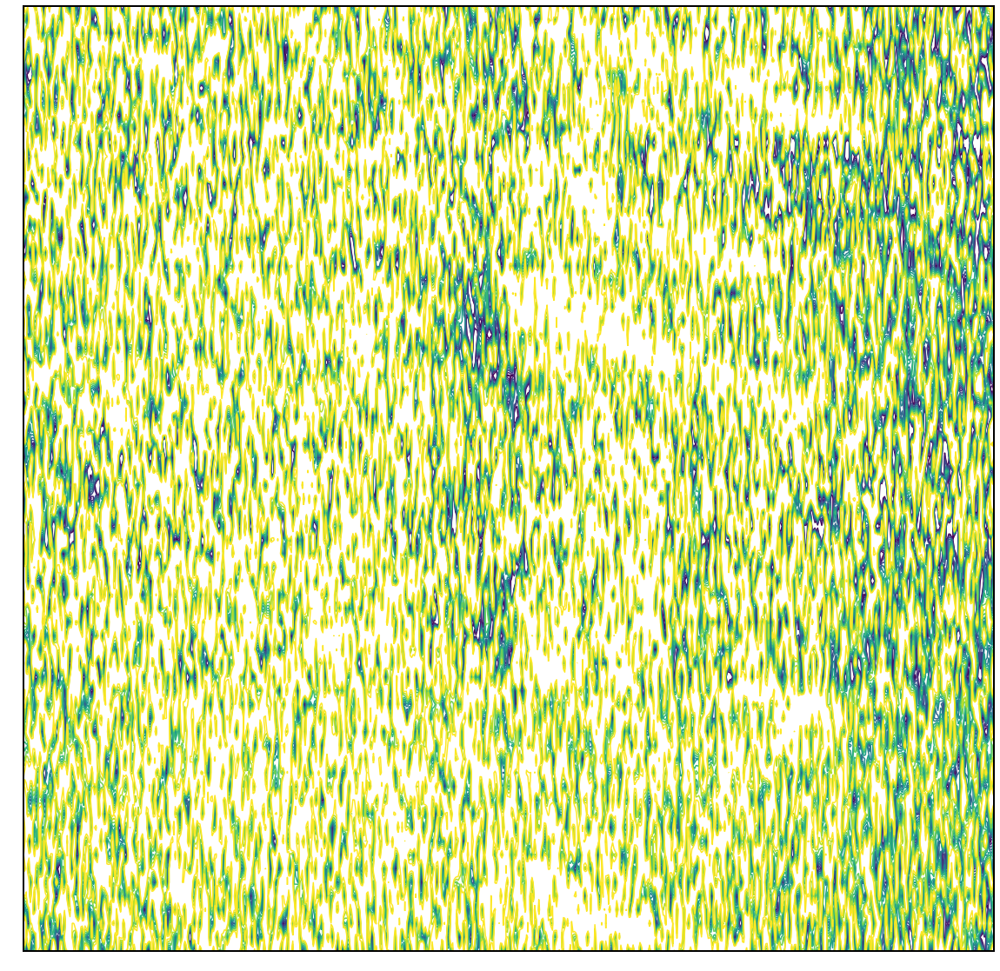

In [15]:
plt.figure(figsize=(20,20))
X,Y = np.meshgrid(resample_grid.value, np.linspace(1,71,70))
plt.contour(X,Y,shiftedStack, np.linspace(0.9,1.1,10))
plt.show()

plt.figure(figsize=(20,20))
#X,Y = np.meshgrid(resample_grid.value, np.linspace(1,71,70))
plt.contour(X,Y,shiftedStack, np.linspace(0.9,1.0,10))

In [22]:
print(dates2)

[53686.0210507, 53686.02500751, 53686.02896131, 53686.03288999, 53686.03682203, 53686.04077027, 53686.04469894, 53686.04863746, 53686.05257135, 53686.05650745, 53686.06046958, 53686.06440856, 53686.06834464, 53686.07228212, 53686.07621948, 53686.0801579, 53686.08409248, 53686.0880303, 53686.09198571, 53686.09591172, 54343.32136658, 54343.3247298, 54343.3280914, 54343.33145671, 54343.33482155, 54343.33818987, 54343.34155448, 54343.34492164, 54343.34828614, 54343.35165237, 54366.1974056, 54366.20077345, 54366.20413736, 54366.20750231, 54366.21087004, 54366.21423268, 54366.2175996, 54366.22097162, 54366.22433738, 54366.22770465, 54378.24412149, 54378.24748912, 54378.2508571, 54378.25422693, 54378.2575941, 54378.26095687, 54378.26431999, 54378.26768554, 54378.27104993, 54378.27441618, 54387.14391089, 54387.14727827, 54387.15064578, 54387.15400946, 54387.1573772, 54387.16074355, 54387.16410735, 54387.16747138, 54387.17083414, 54387.17419851, 54400.08153019, 54400.08489261, 54400.08825411, 5

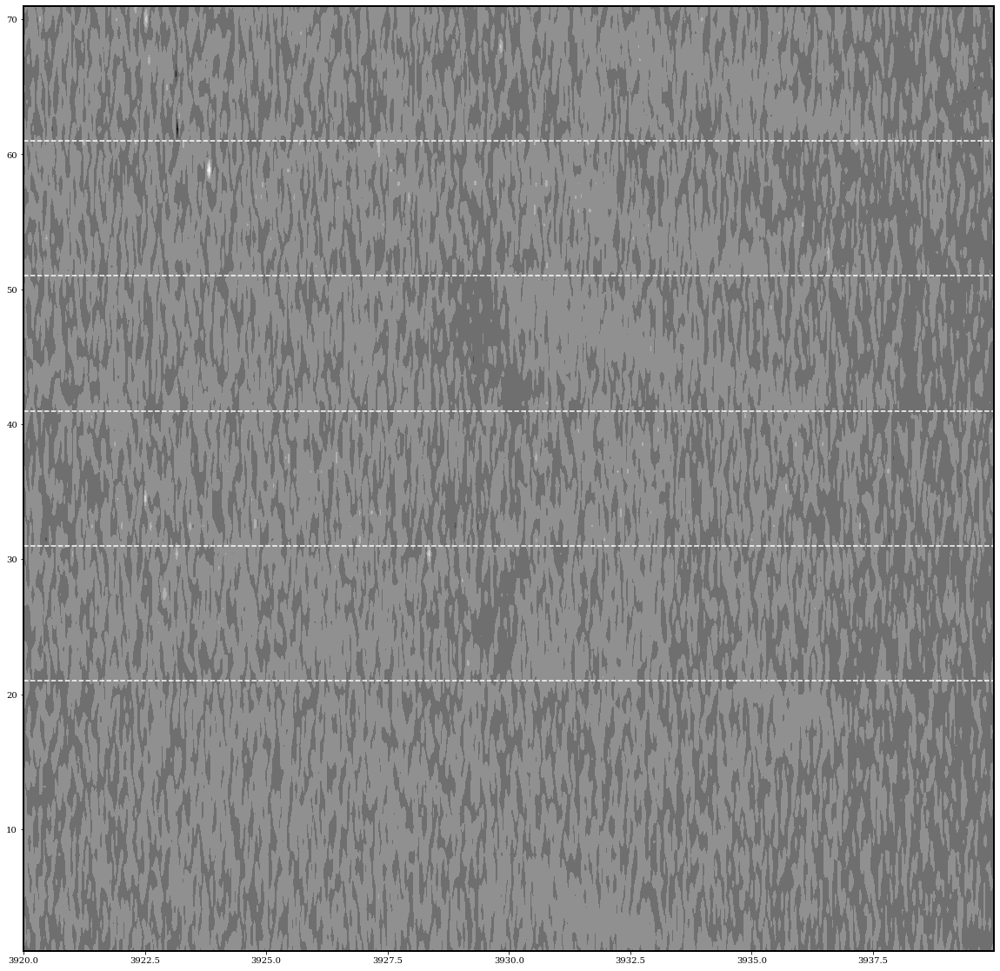

In [30]:
plt.figure(figsize=(20,20))
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.plot([resample_grid.value[0], resample_grid.value[-1]],[21,21], c='w', ls='--')
plt.plot([resample_grid.value[0], resample_grid.value[-1]],[31,31], c='w', ls='--')
plt.plot([resample_grid.value[0], resample_grid.value[-1]],[41,41], c='w', ls='--')
plt.plot([resample_grid.value[0], resample_grid.value[-1]],[51,51], c='w', ls='--')
plt.plot([resample_grid.value[0], resample_grid.value[-1]],[61,61], c='w', ls='--')
X,Y = np.meshgrid(resample_grid.value, np.linspace(1,71,70))
plt.contourf(X,Y,shiftedStack,cmap='gray')
plt.savefig('WD0137CaTrailConsecutive.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')
plt.show()


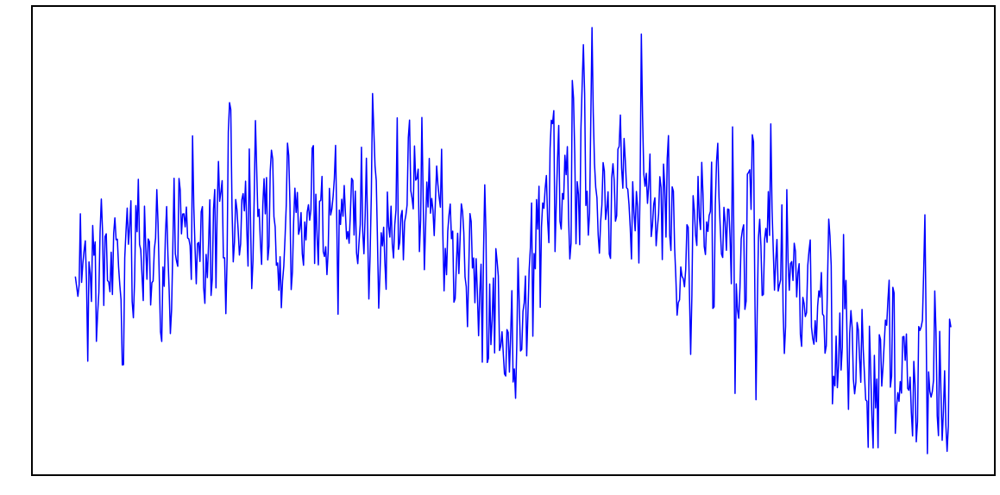

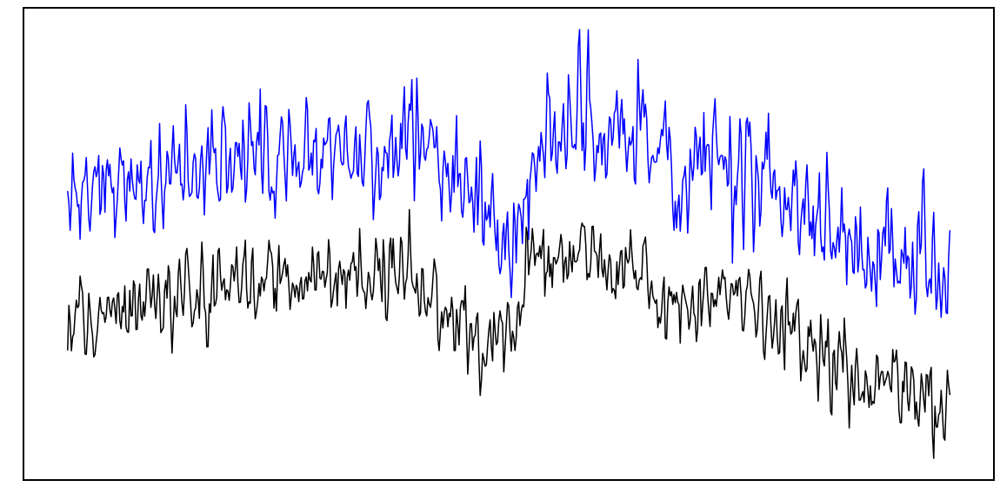

In [12]:
plt.figure(figsize=(20,10))
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()
plt.figure(figsize=(20,10))
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')
plt.plot(resample_grid.value, cummulativeShifted-3, c='k', label='Shifted')

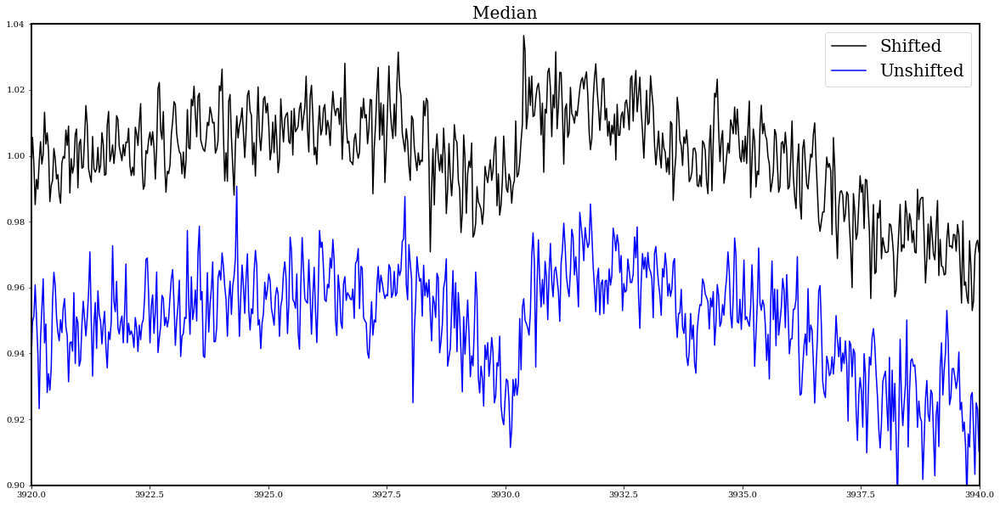

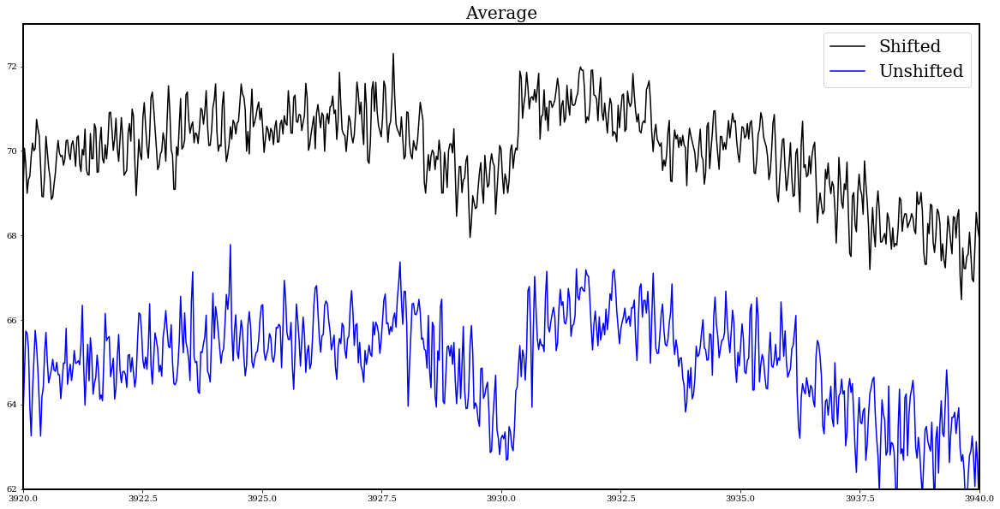

In [26]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Median', fontsize=20)
plt.xlim(3920,3940)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, medianUnShifted-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.9, 1.04)
plt.savefig('WD0137CaMed.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')
plt.show()

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Average', fontsize=20)
plt.xlim(3920,3940)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted-5, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(62,73)
plt.savefig('WD0137CaAvg.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')




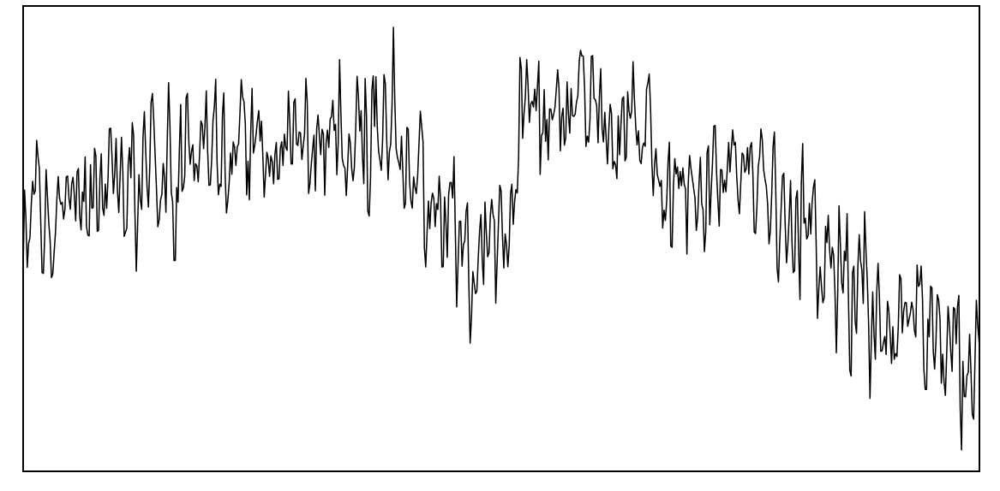

In [11]:
plt.figure(figsize=(20,10))
plt.xlim(3920,3940)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
#plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')


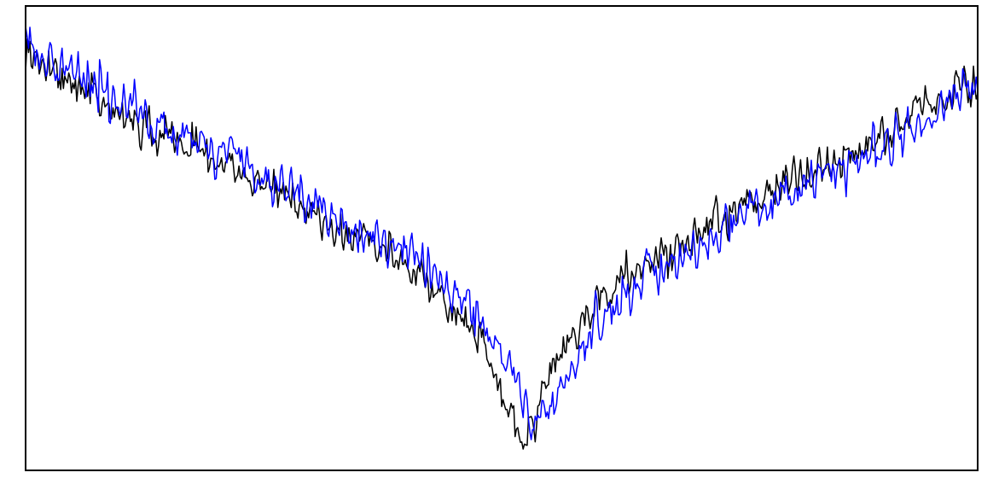

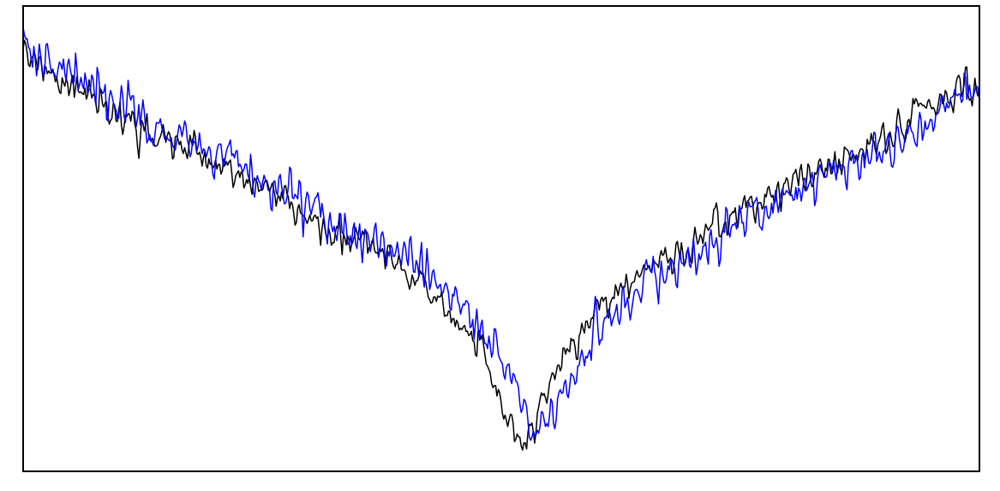

In [12]:

shift = np.array([-1.00230022117564e-05,-8.52547880962895e-05,-8.5070814109578e-05,-9.05889317524e-05,-9.37612530393928e-05,-7.64180590415719e-05,-8.43040111084825e-05,-8.58517318631513e-05,-6.37218633894321e-05,-6.27263722687843e-05,-4.94297840889502e-05,-2.97712715915388e-05,-2.43760153741945e-05,-3.06137845194065e-05,-1.74377589070573e-05,-8.16907078826645e-06,-7.09336983817366e-07,-1.16399560186053e-05,2.59896425629513e-05,-1.14142531968398e-05,-4.14610122430048e-05,-2.40861723370678e-05,-2.71052700506758e-05,-4.63363745621948e-05,-3.35124112309515e-05,-3.33907086167429e-05,-1.79522085437256e-05,-6.55995562182099e-06,6.87478536232078e-06,1.18010290366399e-05,-0.000107780734483,-6.9655336018215e-05,-6.46796789722792e-05,-6.34361097513469e-05,-4.57051096116601e-05,-1.417291437944e-05,-1.43062824715656e-05,-1.81050991403531e-05,9.42540939208314e-06,1.69500572226866e-05,-1.87517868388554e-06,5.53553021864772e-06,-1.18583882127155e-05,-5.65496689874934e-05,-6.00172754339212e-05,-5.98195733561013e-05,-6.26334367499481e-05,-5.70505089316775e-05,-6.81268946780555e-05,-7.25412239357404e-05,2.90185552298539e-05,6.733037837936e-06,-4.53986534987294e-05,-7.54622754053358e-05,-4.4728438032493e-05,-3.66379719927146e-05,-6.06444326907152e-05,-4.66705705606252e-05,-7.56075787338162e-05,-5.16956249678735e-05,7.14336997198473e-06,1.13760564475207e-05,3.93713950685992e-06,-1.62955603628667e-05,4.72256742600763e-06,-5.26917495684565e-05,-5.7322583575381e-05,-6.62230190022761e-05,-6.37003572609984e-05,-8.67951972978176e-05])

adjWvl = []
count = 0
for el in wavels:
    
    newW = el+shift[count]
    newW = 10**newW
    adjWvl.append(newW)
    count = count + 1


from astropy import units as u
from specutils.manipulation import FluxConservingResampler, LinearInterpolatedResampler, SplineInterpolatedResampler

from astropy.nddata import StdDevUncertainty
from astropy.modeling import models
from specutils import Spectrum1D, SpectralRegion
from specutils.analysis import snr_derived
from astropy.io import fits as pyfits
from PyAstronomy import pyasl
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(4330,4350,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0.0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl
    else:
        cummulativeShifted = cummulativeShifted + fl
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(4330,4350)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.zeros_like(shift)

adjWvl = []
count = 0
for el in wavels:
    
    newW = el+shift[count]
    newW = 10**newW
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(4330,4350,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(4330,4350)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')


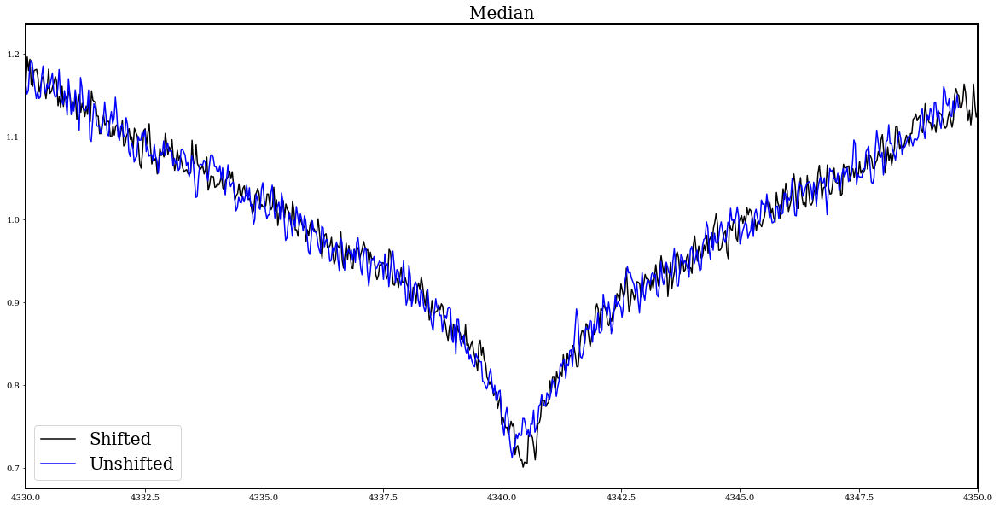

In [18]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Median', fontsize=20)
plt.xlim(4330,4350)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')
plt.plot(resample_grid.value-0.4, medianUnShifted, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.savefig('WD0137GammaMed.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')



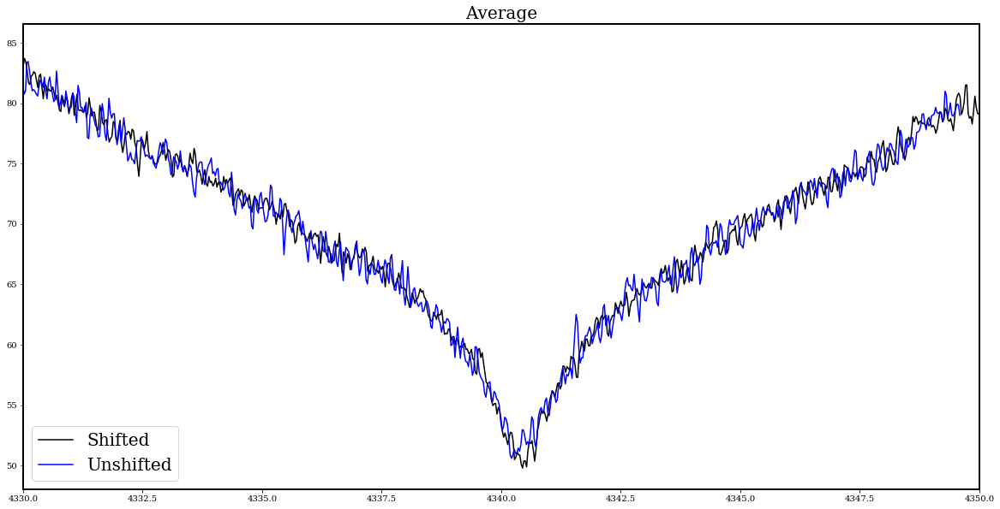

In [19]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Average', fontsize=20)
plt.xlim(4330,4350)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value-0.4, cummulativeUnShifted, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.savefig('WD0137GammaAvg.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')



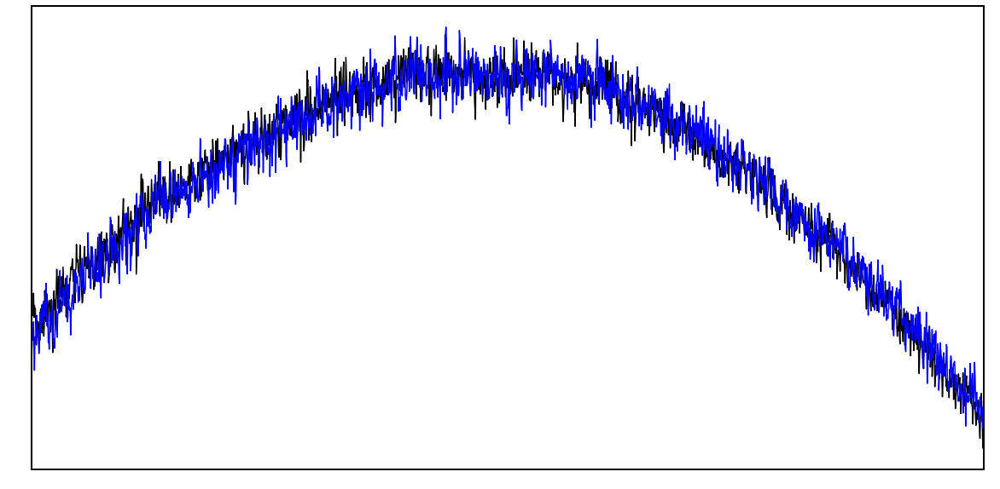

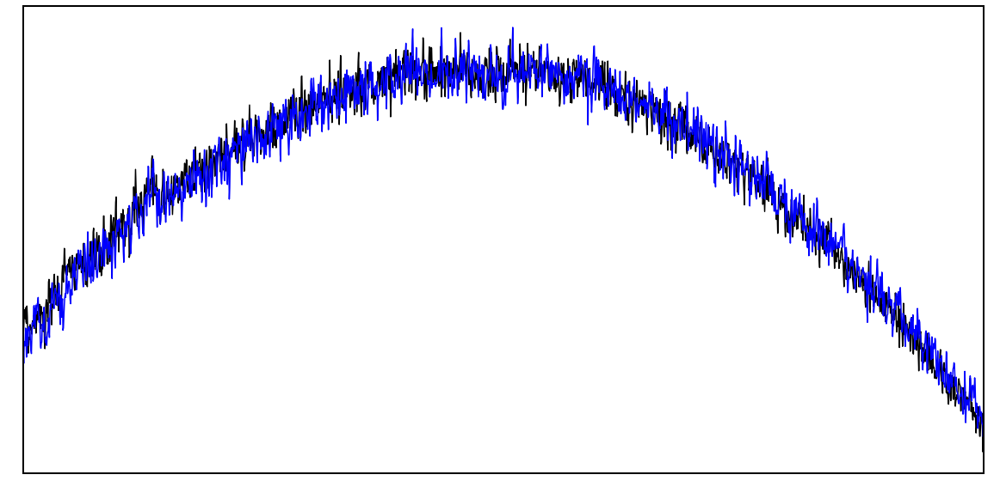

In [8]:

shift = np.array([-1.00230022117564e-05,-8.52547880962895e-05,-8.5070814109578e-05,-9.05889317524e-05,-9.37612530393928e-05,-7.64180590415719e-05,-8.43040111084825e-05,-8.58517318631513e-05,-6.37218633894321e-05,-6.27263722687843e-05,-4.94297840889502e-05,-2.97712715915388e-05,-2.43760153741945e-05,-3.06137845194065e-05,-1.74377589070573e-05,-8.16907078826645e-06,-7.09336983817366e-07,-1.16399560186053e-05,2.59896425629513e-05,-1.14142531968398e-05])

adjWvl = []
count = 0
for el in wavels:
    
    newW = el+shift[count]
    newW = 10**newW
    adjWvl.append(newW)
    count = count + 1


from astropy import units as u
from specutils.manipulation import FluxConservingResampler, LinearInterpolatedResampler, SplineInterpolatedResampler

from astropy.nddata import StdDevUncertainty
from astropy.modeling import models
from specutils import Spectrum1D, SpectralRegion
from specutils.analysis import snr_derived
from astropy.io import fits as pyfits
from PyAstronomy import pyasl
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3900,3960,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0.0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl
    else:
        cummulativeShifted = cummulativeShifted + fl
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3900,3960)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.zeros_like(shift)

adjWvl = []
count = 0
for el in wavels:
    
    newW = el+shift[count]
    newW = 10**newW
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3900,3960,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(3900,3960)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')


In [27]:
rawOffsets

[3.6375469819731343,
 3.637622213759019,
 3.637622029785032,
 3.637627547902675,
 3.637630720223962,
 3.637613377029964,
 3.637621262982031,
 3.6376228107027857,
 3.637600680834312,
 3.6375996853431913,
 3.6375863887550115,
 3.637566730242514,
 3.6375613349862967,
 3.637567572755442,
 3.6375543967298296,
 3.637545128041711,
 3.6375376683079064,
 3.637548598926941,
 3.6375109693283596,
 3.6375483732241194,
 3.6375784199831656,
 3.6375610451432596,
 3.6375640642409732,
 3.6375832953454847,
 3.6375704713821535,
 3.6375703496795393,
 3.6375549111794663,
 3.6375435189265444,
 3.6375300841855602,
 3.637525157941886,
 3.637644739705405,
 3.6376066143069408,
 3.637601638649895,
 3.637600395080674,
 3.637582664080534,
 3.637551131885302,
 3.637551265253394,
 3.637555064070063,
 3.6375275335615305,
 3.6375200089137,
 3.6375388341496064,
 3.637531423440704,
 3.6375488173591353,
 3.63759350863991,
 3.6375969762463565,
 3.6375967785442787,
 3.6375995924076725,
 3.6375940094798542,
 3.63760508586560

[-15.321903668601571, -15.330067302250562, -15.33834899326864, -15.346696805417304, -15.355165832687963, -15.363779948110665, -15.372456460856021, -15.38125528744991, -15.390139546280937, -15.399119814326909, -15.408246606248404, -15.417401815383252, -15.42662661470356, -15.435926170597172, -15.445291865161845, -15.45472148566732, -15.46419811829514, -15.473733643144547, -15.483358018395261, -15.492951489012409, 10.66405551990992, 10.65558241772212, 10.647115021549961, 10.638643107455293, 10.630180641590051, 10.621720938267673, 10.613285428230611, 10.60486157612443, 10.596465843509357, 10.588090478756692, 2.5957557689502093, 2.5876405225042363, 2.5794774568407144, 2.5712576108697016, 2.5629799093962036, 2.554666763632402, 2.5462981854823257, 2.537875337610399, 2.5294296193450685, 2.520944935712213, -2.1690381464467294, -2.1776693447688222, -2.186281832254971, -2.194876056303985, -2.203437199301622, -2.211957806742311, -2.2204466663747495, -2.228905630201015, -2.2373225488571507, -2.245

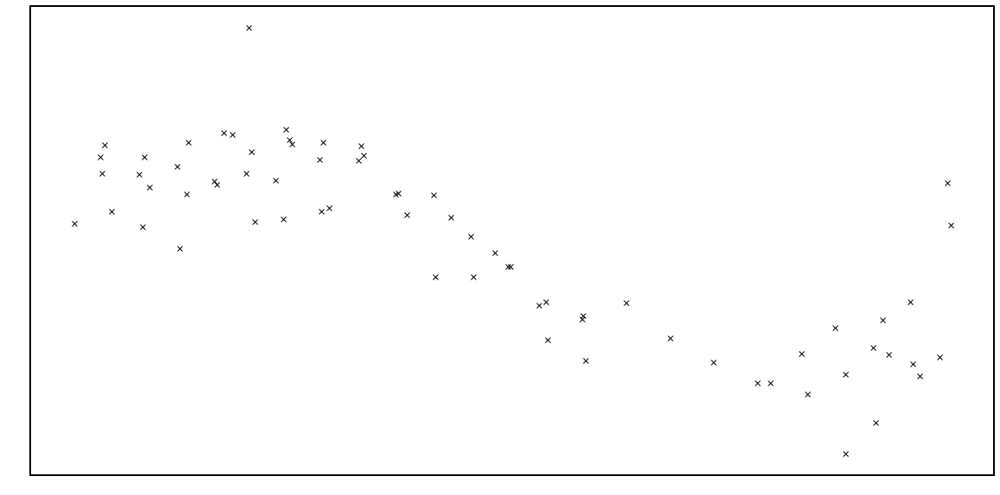

In [6]:

esovlt = EarthLocation.from_geodetic(lat=-24.6275*u.deg, lon=-70.4044*u.deg, height=2635*u.m)
sc = SkyCoord("01:39:42.8531448117 -34:42:39.576295162", frame=ICRS, unit=(u.hourangle, u.deg))
baryCorr = []
for el in dates2:
    barycorr = sc.radial_velocity_correction(obstime=Time(el, format='mjd'), location=esovlt)  
    baryCorr.append(barycorr.to(u.km/u.s).value)
print(baryCorr)


offsetsAlpha = 10**np.array(rawOffsets)

offsetsAlphaS = offsetsAlpha

halpharest = 4340.472 #air
offsetsAlphaS = (offsetsAlphaS - halpharest)/halpharest
offsetsAlphaS = (offsetsAlphaS)*(299792458/1000)
print(offsetsAlphaS)
offsetsAlphaS = np.array(offsetsAlphaS) + baryCorr

dat = np.array([dates2, offsetsAlphaS])
a = np.column_stack((dat))
fitname = 'WD0137UVESOnlyRV.dat'
#np.savetxt(fitname, a, delimiter='\t')
phases = foldMeth(np.array(dates2), 0.0794300)


plt.figure(figsize=(20,10))
plt.plot(phases,offsetsAlphaS, 'kx')

Name     Value      Min      Max   Stderr     Vary     Expr Brute_Step
a      31.6     -inf      inf    2.134     True     None     None
c    0.0561     -inf      inf  0.06064     True     None     None
d     13.74     -inf      inf    1.479     True     None     None
[0.98641194 0.03622699 0.08600415 0.13546506 0.18496827 0.23467544
 0.28413622 0.33372101 0.38324751 0.43280184 0.48268387 0.53227446
 0.58182853 0.63140023 0.68097041 0.73055395 0.78008914 0.82966511
 0.87946255 0.92888984 0.20126627 0.24360821 0.28592975 0.328298
 0.37066033 0.41306647 0.45542591 0.49781745 0.5401755  0.58255533
 0.20377187 0.2461721  0.28852272 0.33088644 0.37328516 0.41561979
 0.45800831 0.50046103 0.54283495 0.58522787 0.86833048 0.91072794
 0.9531298  0.99555495 0.03794662 0.08028289 0.12262357 0.16499484
 0.2073515  0.24973159 0.91402354 0.95641785 0.9988138  0.04116153
 0.08356037 0.12594171 0.16829095 0.21064308 0.25297923 0.29533564
 0.79479026 0.83712212 0.8794424  0.92179605 0.96418331 0.00650

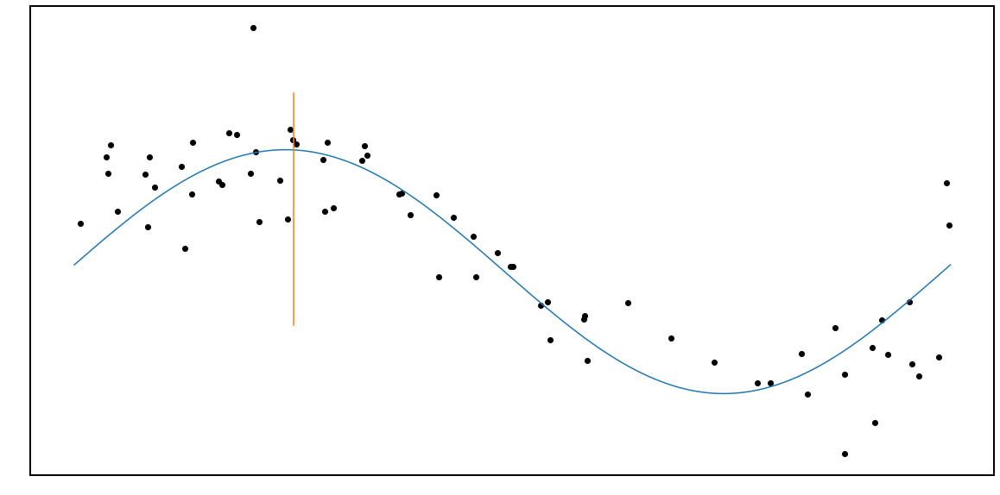

In [8]:

plt.figure(figsize=(20,10))
mod = Model(sineModelFixed)
pars = mod.make_params(a=25,c=0,d=20)
#UVESFold = foldMeth(UVEST,0.41574154920793316)
UVESFold = foldMeth(np.array(dates2), 0.0794300)
result = mod.fit(offsetsAlphaS,pars,x=UVESFold)
TDummy = np.linspace(0,1,1000)
ypointsModel = sineModelFixed(TDummy,result.params['a'].value,result.params['c'].value,result.params['d'].value)
result.params.pretty_print()
plt.plot(UVESFold,offsetsAlphaS,ls='', c='k',marker='o')
plt.plot(TDummy,ypointsModel)
print(UVESFold)
plt.plot([0.25,0.25],[0,60])

In [32]:
modelResults = sineModelFixed(UVESFold,result.params['a'].value,result.params['c'].value,result.params['d'].value)
print(modelResults)


[ 12.81947694  22.58915403  31.49317388  38.63653631  43.39803281
  45.31542082  44.19133872  40.13680243  33.55020613  25.05598395
  15.40904372   5.65584909  -3.31227803 -10.64240063 -15.62564292
 -17.78292075 -16.90718563 -13.08184691  -6.64097662   1.71138707
  44.35783889  45.33692627  44.09423564  40.71329316  35.43328333
  28.61807392  20.76221565  12.40580487   4.15014254  -3.4335586
  44.47715766  45.32471709  43.94703934  40.4419953   35.05141208
  28.16895397  20.26144507  11.88166408   3.6484648   -3.87642167
  -8.27825989  -1.53701752   6.28311921  14.63435535  22.91637418
  30.54222195  36.98705709  41.79939226  44.63440148  45.29418129
  -0.96112953   6.91896878  15.28083279  23.52522252  31.08971814
  37.42820852  42.0943693   44.76520364  45.25255325  43.5221926
 -16.06918068 -12.27053046  -6.64403183   0.42159305   8.43173927
  16.80294191  24.96946383  32.34710677  38.41267293  42.7384142 ]


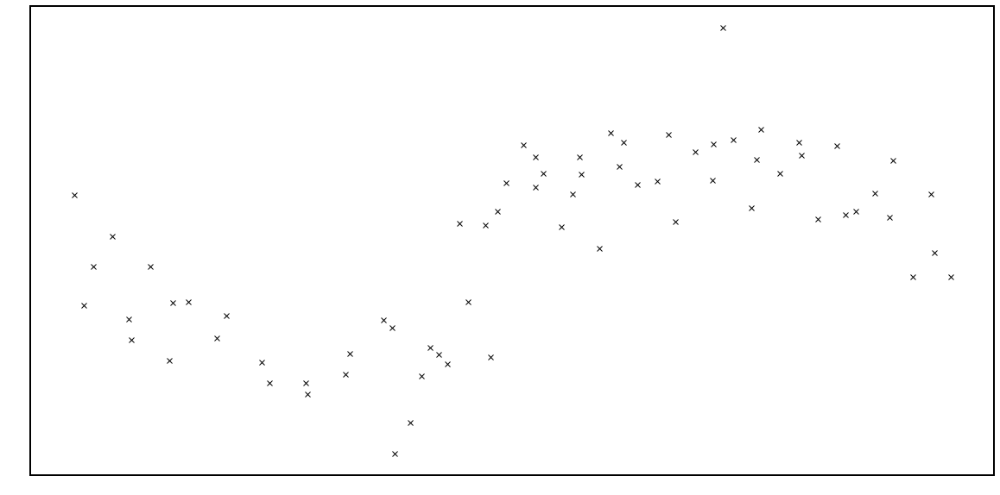

In [15]:


phases = foldMeth(np.array(dates2), 1/12.5868237)


plt.figure(figsize=(20,10))
plt.plot(phases,offsetsAlphaS, 'kx')

Name     Value      Min      Max   Stderr     Vary     Expr Brute_Step
a    -29.88     -inf      inf    2.182     True     None     None
c  -0.001656     -inf      inf  0.06684     True     None     None
d     18.26     -inf      inf    1.484     True     None     None
[0.48211965 0.53192332 0.5816891  0.63113871 0.6806306  0.7303264
 0.77977588 0.82934933 0.87886451 0.92840751 0.97827814 0.02785739
 0.07740013 0.1269605  0.17651936 0.22609156 0.27561542 0.32518007
 0.37496611 0.42438211 0.80531359 0.84764584 0.88995771 0.93231627
 0.97466892 0.01706537 0.05941512 0.10179697 0.14414534 0.18651548
 0.74198368 0.78437422 0.82671516 0.86906919 0.91145822 0.95378317
 0.996162   0.03860502 0.08096925 0.12335249 0.37187276 0.41426052
 0.45665269 0.49906815 0.54145012 0.58377672 0.62610771 0.6684693
 0.71081628 0.75318668 0.3919529  0.43433752 0.47672377 0.51906182
 0.56145097 0.60382262 0.64616218 0.68850463 0.7308311  0.77317783
 0.23548613 0.27780832 0.32011892 0.36246289 0.40484046 0.4471

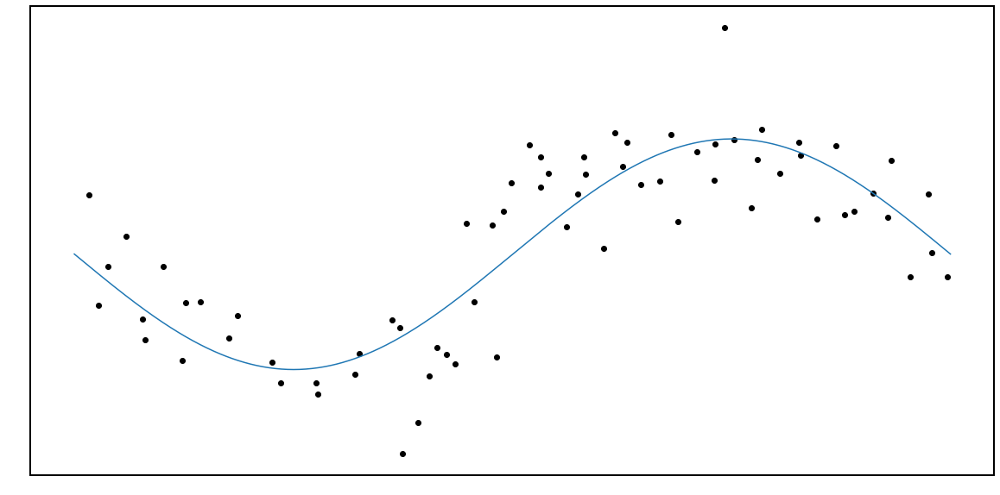

In [16]:

plt.figure(figsize=(20,10))
mod = Model(sineModelFixed)
pars = mod.make_params(a=25,c=0,d=20)
#UVESFold = foldMeth(UVEST,0.41574154920793316)
UVESFold = foldMeth(np.array(dates2), 1/12.5868237)
result = mod.fit(offsetsAlphaS,pars,x=UVESFold)
TDummy = np.linspace(0,1,1000)
ypointsModel = sineModelFixed(TDummy,result.params['a'].value,result.params['c'].value,result.params['d'].value)
result.params.pretty_print()
plt.plot(UVESFold,offsetsAlphaS,ls='', c='k',marker='o')
plt.plot(TDummy,ypointsModel)
print(UVESFold)

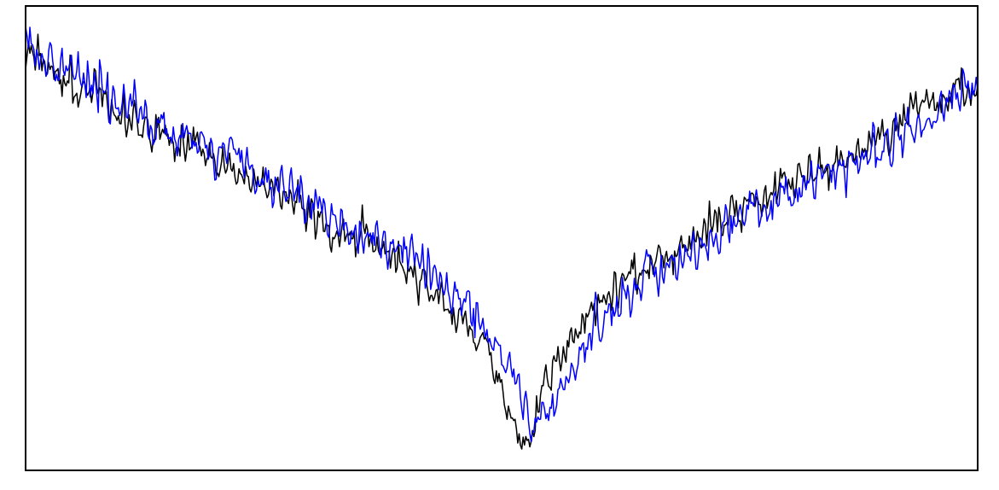

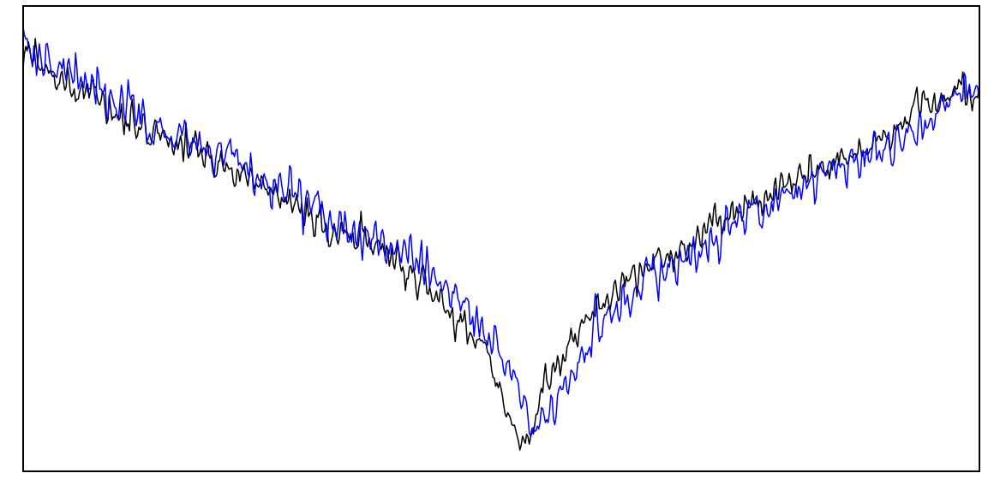

In [35]:
shift = -np.array([0.407438116982176,0.549004199613441,0.678038784247141,0.781583077073078,0.850643859823268,0.878529011948535,0.862379884140516,0.803804660812966,0.708570860972822,0.585719355041799,0.44618062331959,0.305103924608372,0.17539464194975,0.069401890658126,-0.002611168769614,-0.033708265326864,-0.020891942821672,0.03463034881413,0.128022262898473,0.249088820619743,0.4878272264339,0.502125380062711,0.484255979931974,0.435428487206535,0.359105674139968,0.260555808309646,0.14693881144116,0.026074518327792,-0.09333152004054,-0.203009027065548,0.606369664672647,0.618758341822834,0.598930157416169,0.548302241009061,0.470375843012051,0.370850211379223,0.25648443440207,0.135281766862385,0.016201677991004,-0.092622712429373,-0.08845087730554,0.009275521224613,0.122622157761816,0.243657923177584,0.363691063692937,0.474223404636506,0.567656282548774,0.637452974884633,0.678620826875443,0.68829460479884,0.06438502797582,0.178593519121774,0.299777920610224,0.419262096740798,0.528903424779879,0.620794926371505,0.688474516129515,0.727265813434475,0.734444516150475,0.709515154057648,-0.087029932102632,-0.031923106255843,0.049648871098018,0.152058055428213,0.268143392659284,0.389457013194689,0.507808314851737,0.614738973990912,0.702673908538022,0.765420012794165])
    
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1
    

from astropy import units as u
from specutils.manipulation import FluxConservingResampler, LinearInterpolatedResampler, SplineInterpolatedResampler

from astropy.nddata import StdDevUncertainty
from astropy.modeling import models
from specutils import Spectrum1D, SpectralRegion
from specutils.analysis import snr_derived
from astropy.io import fits as pyfits
from PyAstronomy import pyasl
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(4330,4350,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0.0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl
    else:
        cummulativeShifted = cummulativeShifted + fl
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(4330,4350)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.zeros_like(shift)

adjWvl = []
count = 0
for el in wavels:
    
    newW = el+shift[count]
    newW = 10**newW
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(4330,4350,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(4330,4350)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')


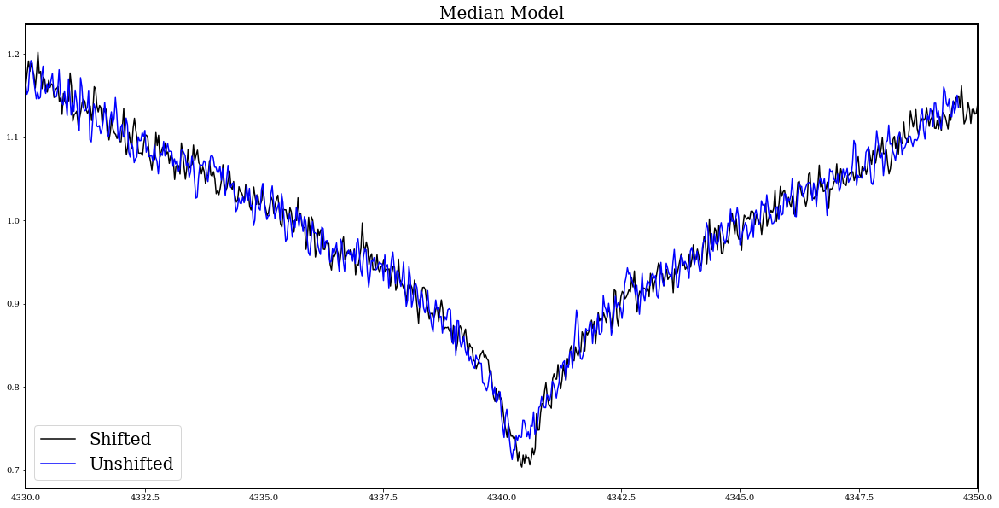

In [36]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Median Model', fontsize=20)
plt.xlim(4330,4350)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')
plt.plot(resample_grid.value-0.4, medianUnShifted, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.savefig('WD0137GammaMedMod.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')



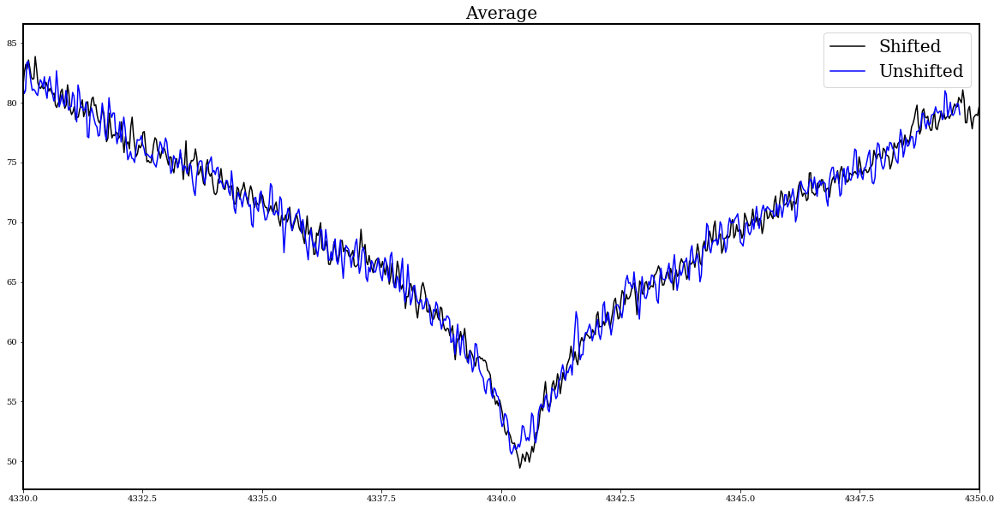

In [37]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Average', fontsize=20)
plt.xlim(4330,4350)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value-0.4, cummulativeUnShifted, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.savefig('WD0137GammaAvgMod.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')



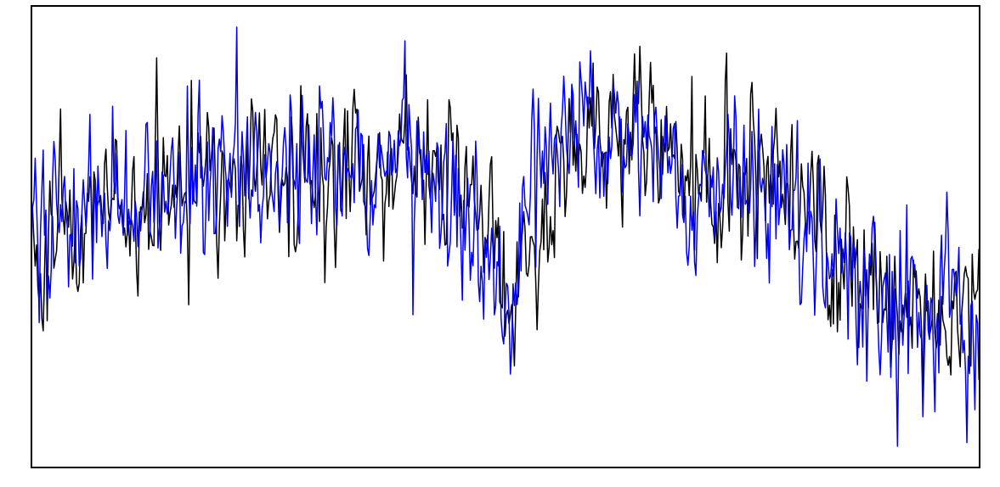

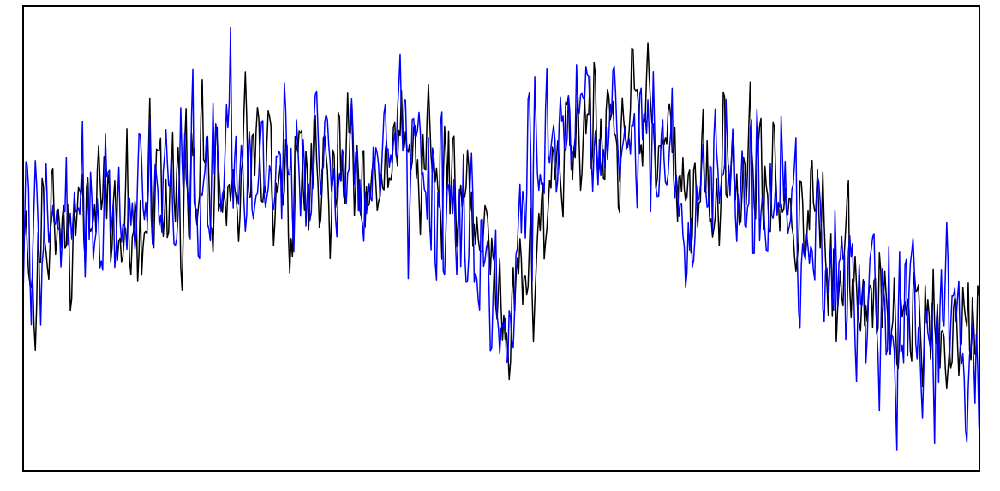

In [6]:

shift = np.array([0.368437950793149,0.496453262106692,0.613136596243456,0.706769581168092,0.769219833650886,0.794435806036302,0.779832480258259,0.726864104569939,0.640746128374593,0.529654025769331,0.403472006392252,0.275899234942159,0.158605785189438,0.062758709383022,-0.002361226479686,-0.030481694481139,-0.01889215633117,0.031315515707845,0.115767912309193,0.225245922778096,0.441132177273131,0.454061704981887,0.437902772148512,0.393749069752242,0.324731911874878,0.235615285069311,0.132873760021157,0.023578653297748,-0.084397783503527,-0.183576908509553,0.548327678151164,0.559530505358547,0.541600283991802,0.495818495306631,0.425351248394714,0.335352256543401,0.231933624967083,0.122332533174931,0.014650845833055,-0.083756823286797,-0.079984318162689,0.008387664015943,0.110884707749555,0.220334873366771,0.328878385805686,0.428830519629729,0.513319958982327,0.57643567944274,0.613662925480481,0.622410724878641,0.058222063131635,0.161498464349721,0.271083038525564,0.379130133706111,0.478276542795582,0.561372147086344,0.62257341501301,0.657651591285536,0.66414314523642,0.641600033285843,-0.078699386495945,-0.028867411667252,0.044896458048738,0.137502987591151,0.242476582313557,0.352178006629038,0.459200666607933,0.555895873286207,0.635413634971435,0.692153652924635])

adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1


from astropy import units as u
from specutils.manipulation import FluxConservingResampler, LinearInterpolatedResampler, SplineInterpolatedResampler

from astropy.nddata import StdDevUncertainty
from astropy.modeling import models
from specutils import Spectrum1D, SpectralRegion
from specutils.analysis import snr_derived
from astropy.io import fits as pyfits
from PyAstronomy import pyasl
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3920,3940,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0.0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl
    else:
        cummulativeShifted = cummulativeShifted + fl
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3920,3940)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.zeros_like(shift)

adjWvl = []
count = 0
for el in wavels:
    
    newW = el+shift[count]
    newW = 10**newW
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3920,3940,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(3920,3940)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')


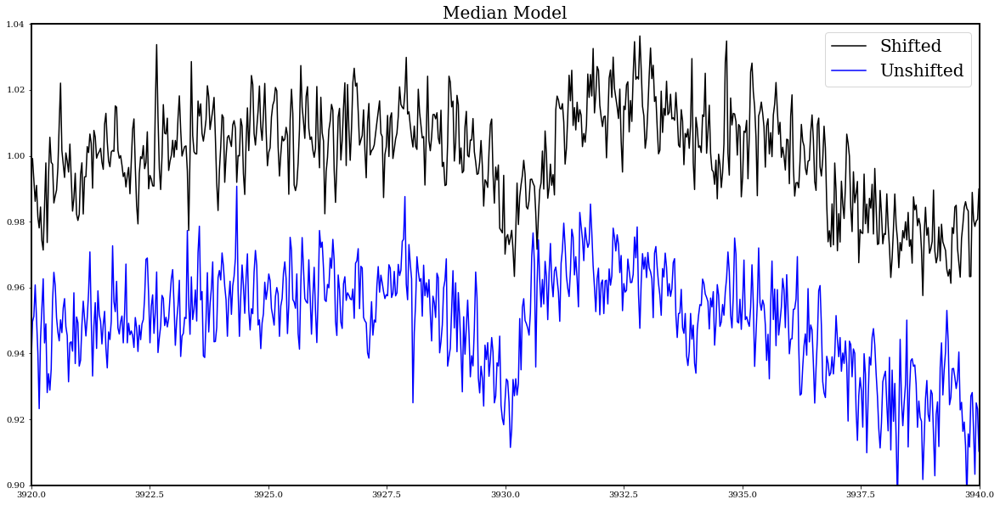

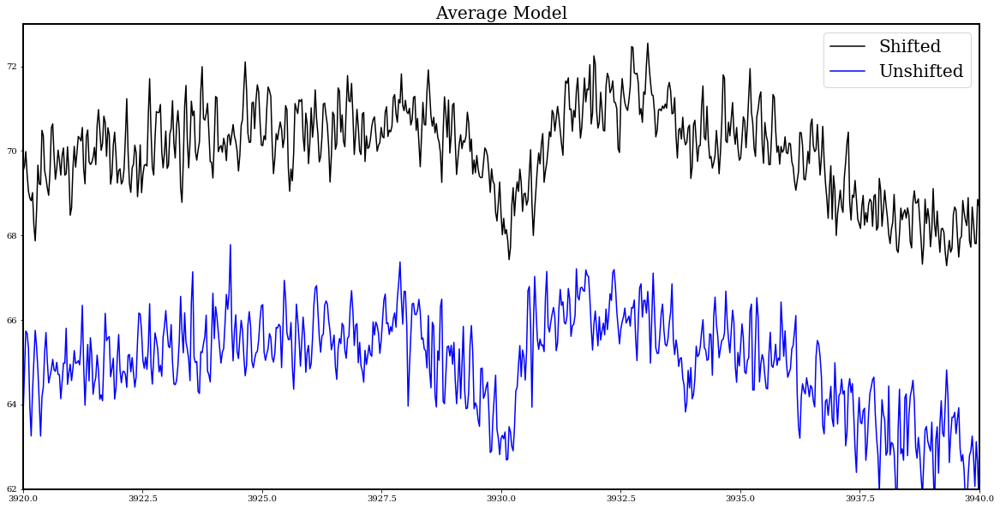

In [7]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Median Model', fontsize=20)
plt.xlim(3920,3940)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, medianUnShifted-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.9, 1.04)
#plt.savefig('WD0137CaMedMod.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')
plt.show()

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Average Model', fontsize=20)
plt.xlim(3920,3940)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted-5, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(62,73)
#plt.savefig('WD0137CaAvgMod.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')




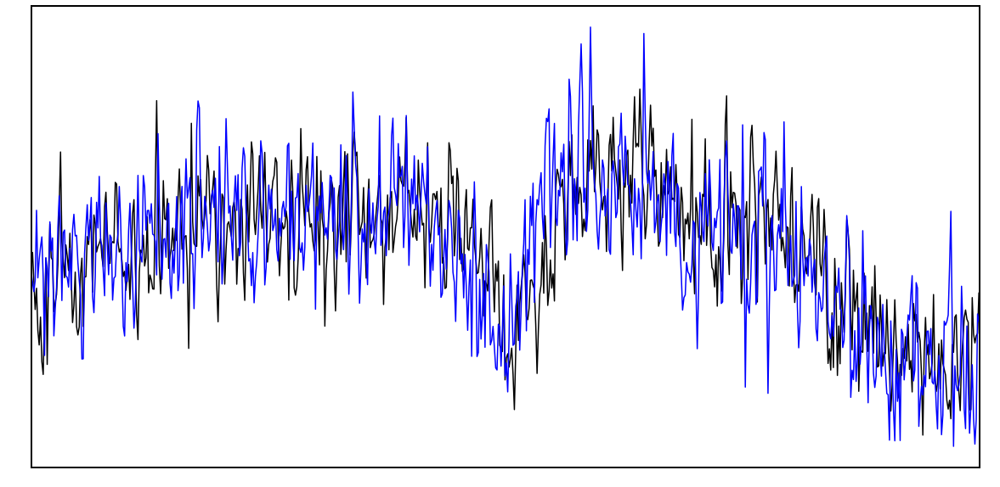

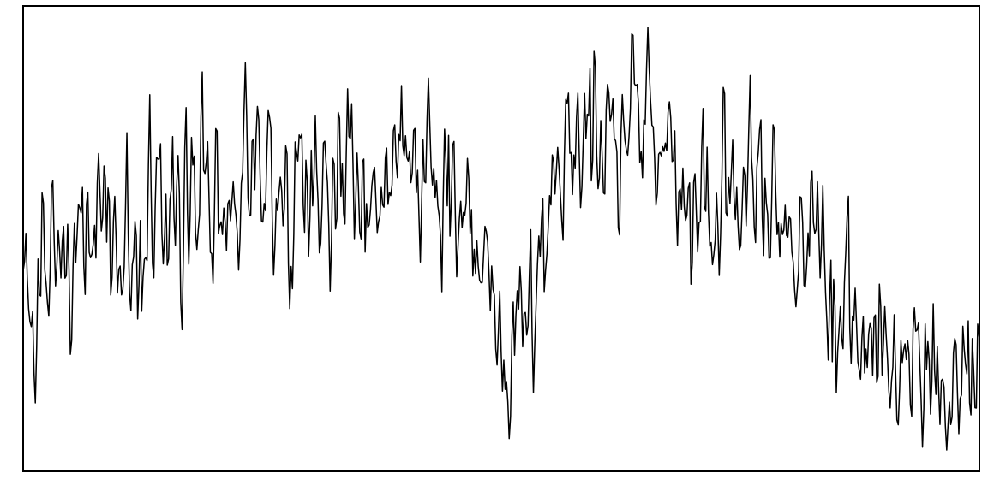

In [29]:

shift = np.array([0.368437950793149,0.496453262106692,0.613136596243456,0.706769581168092,0.769219833650886,0.794435806036302,0.779832480258259,0.726864104569939,0.640746128374593,0.529654025769331,0.403472006392252,0.275899234942159,0.158605785189438,0.062758709383022,-0.002361226479686,-0.030481694481139,-0.01889215633117,0.031315515707845,0.115767912309193,0.225245922778096,0.441132177273131,0.454061704981887,0.437902772148512,0.393749069752242,0.324731911874878,0.235615285069311,0.132873760021157,0.023578653297748,-0.084397783503527,-0.183576908509553,0.548327678151164,0.559530505358547,0.541600283991802,0.495818495306631,0.425351248394714,0.335352256543401,0.231933624967083,0.122332533174931,0.014650845833055,-0.083756823286797,-0.079984318162689,0.008387664015943,0.110884707749555,0.220334873366771,0.328878385805686,0.428830519629729,0.513319958982327,0.57643567944274,0.613662925480481,0.622410724878641,0.058222063131635,0.161498464349721,0.271083038525564,0.379130133706111,0.478276542795582,0.561372147086344,0.62257341501301,0.657651591285536,0.66414314523642,0.641600033285843,-0.078699386495945,-0.028867411667252,0.044896458048738,0.137502987591151,0.242476582313557,0.352178006629038,0.459200666607933,0.555895873286207,0.635413634971435,0.692153652924635])

adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1


from astropy import units as u
from specutils.manipulation import FluxConservingResampler, LinearInterpolatedResampler, SplineInterpolatedResampler

from astropy.nddata import StdDevUncertainty
from astropy.modeling import models
from specutils import Spectrum1D, SpectralRegion
from specutils.analysis import snr_derived
from astropy.io import fits as pyfits
from PyAstronomy import pyasl
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3920,3940,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0.0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl
    else:
        cummulativeShifted = cummulativeShifted + fl
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3920,3940)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.array([-0.200600349656766,-0.200707231138328,-0.200815658273095,-0.200924951091541,-0.201035830905727,-0.201148610270691,-0.201262206565783,-0.201377404241573,-0.201493720429593,-0.20161129360777,-0.201730785133777,-0.201850648709046,-0.201971423386213,-0.202093176805649,-0.202215796138407,-0.202339252414563,-0.202463324191792,-0.202588167008998,-0.202714173090377,-0.202839774556215,0.139617981702683,0.13950704853809,0.139396190078884,0.13928527246927,0.139174478559568,0.139063720818156,0.138953279824688,0.138842991461407,0.138733071249492,0.138623417701589,0.033984648783692,0.033878400806298,0.033771526761023,0.033663909325776,0.033555534423685,0.033446695471096,0.033337130776046,0.033226855560592,0.033116280917012,0.033005196123614,-0.028397894935714,-0.028510897956671,-0.028623656008053,-0.02873617494738,-0.028848260776657,-0.028959815898583,-0.029070955365798,-0.029181703425438,-0.029291901013281,-0.02940160533885,-0.07080554648681,-0.070912621588126,-0.071020404859343,-0.071128728310516,-0.071237805018196,-0.071347416574277,-0.071457484329723,-0.071568053830434,-0.071679036261904,-0.071790482056239,-0.131684605782472,-0.13178316765953,-0.131882718833023,-0.131983326648746,-0.132084957202194,-0.132187325620145,-0.132290689663983,-0.132394912257195,-0.132499911737444,-0.132605634758681])


adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3920,3940,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(3920,3940)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
#plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')


In [18]:
bin0 = (adjAdjFlux[2]+adjAdjFlux[3]+adjAdjFlux[45]+adjAdjFlux[46]+adjAdjFlux[54]+adjAdjFlux[55]+adjAdjFlux[67]+adjAdjFlux[68])/8
bin1 = (adjAdjFlux[4]+adjAdjFlux[5]+adjAdjFlux[20]+adjAdjFlux[21]+adjAdjFlux[30]+adjAdjFlux[31]+adjAdjFlux[47]+adjAdjFlux[48]+adjAdjFlux[49]+adjAdjFlux[56]+adjAdjFlux[57]+adjAdjFlux[69])/12
bin2 = (adjAdjFlux[6]+adjAdjFlux[7]+adjAdjFlux[22]+adjAdjFlux[23]+adjAdjFlux[32]+adjAdjFlux[33]+adjAdjFlux[58]+adjAdjFlux[59])/8
bin3 = (adjAdjFlux[8]+adjAdjFlux[9]+adjAdjFlux[24]+adjAdjFlux[25]+adjAdjFlux[34]+adjAdjFlux[35])/6
bin4 = (adjAdjFlux[10]+adjAdjFlux[11]+adjAdjFlux[26]+adjAdjFlux[27]+adjAdjFlux[28]+adjAdjFlux[36]+adjAdjFlux[37]+adjAdjFlux[38])/8
bin5 = (adjAdjFlux[12]+adjAdjFlux[13]+adjAdjFlux[29]+adjAdjFlux[39])/4
bin6 = (adjAdjFlux[14]+adjAdjFlux[15])/2
bin7 = (adjAdjFlux[16]+adjAdjFlux[17]+adjAdjFlux[60]+adjAdjFlux[61])/4
bin8 = (adjAdjFlux[18]+adjAdjFlux[19]+adjAdjFlux[40]+adjAdjFlux[41]+adjAdjFlux[50]+adjAdjFlux[62]+adjAdjFlux[63])/7
bin9 = (adjAdjFlux[0]+adjAdjFlux[1]+adjAdjFlux[42]+adjAdjFlux[43]+adjAdjFlux[44]+adjAdjFlux[51]+adjAdjFlux[52]+adjAdjFlux[53]+adjAdjFlux[64]+adjAdjFlux[65]+adjAdjFlux[66])/11


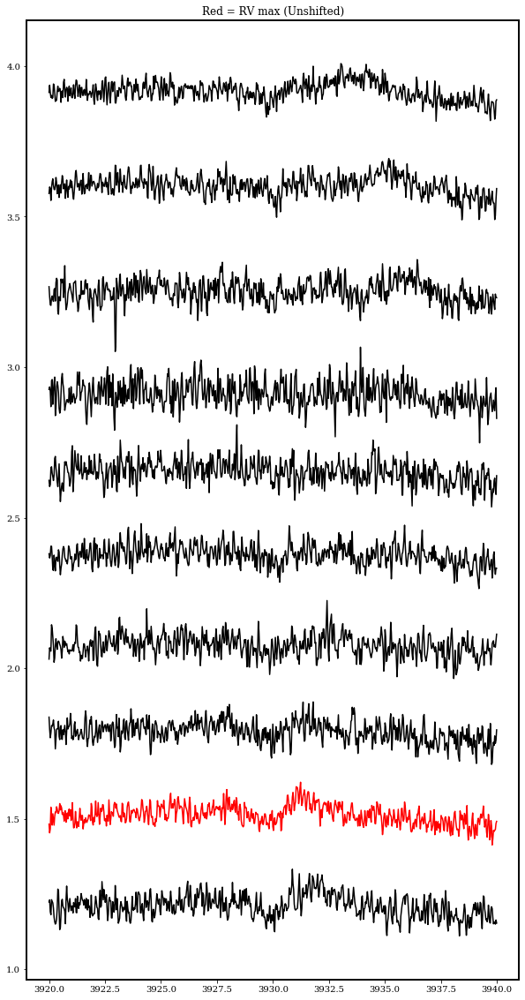

In [19]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(10,20))
plt.plot(resample_grid.value, bin0, c='k')
plt.plot(resample_grid.value, bin1.value+0.3, c='r')
plt.plot(resample_grid.value, bin2.value+0.6, c='k')
plt.plot(resample_grid.value, bin3.value+0.9, c='k')
plt.plot(resample_grid.value, bin4.value+1.2, c='k')
plt.plot(resample_grid.value, bin5.value+1.5, c='k')
plt.plot(resample_grid.value, bin6.value+1.8, c='k')
plt.plot(resample_grid.value, bin7.value+2.1, c='k')
plt.plot(resample_grid.value, bin8.value+2.4, c='k')
plt.plot(resample_grid.value, bin9.value+2.7, c='k')
plt.title('Red = RV max (Unshifted)')
plt.savefig('WD0137CaTrail.pdf')

plt.rc('xtick',c='w')
plt.rc('ytick',c='w')

67.98590219705852
61.05526577398084
41.408463161115876
51.70427323819161
44.52201147444678


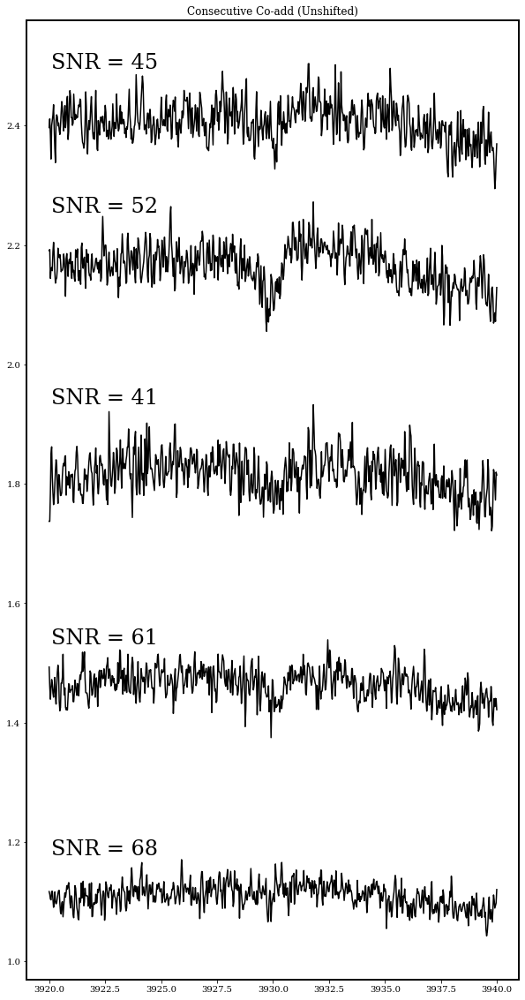

In [56]:
bin0 = (adjAdjFlux[0]+adjAdjFlux[1]+adjAdjFlux[2]+adjAdjFlux[3]+adjAdjFlux[4]+adjAdjFlux[5]+adjAdjFlux[6]+adjAdjFlux[7]+adjAdjFlux[8]+adjAdjFlux[9]+adjAdjFlux[10]+adjAdjFlux[11]+adjAdjFlux[12]+adjAdjFlux[13])/14

bin1 = (adjAdjFlux[14]+adjAdjFlux[15]+adjAdjFlux[16]+adjAdjFlux[17]+adjAdjFlux[18]+adjAdjFlux[19]+adjAdjFlux[20]+adjAdjFlux[21]+adjAdjFlux[22]+adjAdjFlux[23]+adjAdjFlux[24]+adjAdjFlux[25]+adjAdjFlux[26]+adjAdjFlux[27])/14

bin2 = (adjAdjFlux[28]+adjAdjFlux[29]+adjAdjFlux[30]+adjAdjFlux[31]+adjAdjFlux[32]+adjAdjFlux[33]+adjAdjFlux[34]+adjAdjFlux[35]+adjAdjFlux[36]+adjAdjFlux[37]+adjAdjFlux[38]+adjAdjFlux[39]+adjAdjFlux[40]+adjAdjFlux[41])/14

bin3 = (adjAdjFlux[42]+adjAdjFlux[43]+adjAdjFlux[44]+adjAdjFlux[45]+adjAdjFlux[46]+adjAdjFlux[47]+adjAdjFlux[48]+adjAdjFlux[49]+adjAdjFlux[50]+adjAdjFlux[51]+adjAdjFlux[52]+adjAdjFlux[53]+adjAdjFlux[54]+adjAdjFlux[55])/14

bin4 = (adjAdjFlux[56]+adjAdjFlux[57]+adjAdjFlux[58]+adjAdjFlux[59]+adjAdjFlux[60]+adjAdjFlux[61]+adjAdjFlux[62]+adjAdjFlux[63]+adjAdjFlux[64]+adjAdjFlux[65]+adjAdjFlux[66]+adjAdjFlux[67]+adjAdjFlux[68]+adjAdjFlux[69])/14
spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin0* u.Jy)
der = snr_derived(spectrum)
print(der)

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin1* u.Jy)
der = snr_derived(spectrum)
print(der)

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin2* u.Jy)
der = snr_derived(spectrum)
print(der)

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin3* u.Jy)
der = snr_derived(spectrum)
print(der)

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin4* u.Jy)
der = snr_derived(spectrum)
print(der)

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(10,20))
plt.plot(resample_grid.value, bin0, c='k')
plt.plot(resample_grid.value, bin1.value+0.3, c='k')
plt.plot(resample_grid.value, bin2.value+0.6, c='k')
plt.plot(resample_grid.value, bin3.value+0.9, c='k')
plt.plot(resample_grid.value, bin4.value+1.2, c='k')
#plt.text(-1, -1, "right-top",horizontalalignment="right",verticalalignment="top")

plt.annotate('SNR = 68', xy = (0.05, 0.13), xycoords = 'axes fraction', fontsize=24)

plt.annotate('SNR = 61', xy = (0.05, 0.35), xycoords = 'axes fraction', fontsize=24)

plt.annotate('SNR = 41', xy = (0.05, 0.6), xycoords = 'axes fraction', fontsize=24)

plt.annotate('SNR = 52', xy = (0.05, 0.8), xycoords = 'axes fraction', fontsize=24)

plt.annotate('SNR = 45', xy = (0.05, 0.95), xycoords = 'axes fraction', fontsize=24)


plt.title('Consecutive Co-add (Unshifted)')
plt.savefig('WD0137CaTrailConsecutiveUnshifted.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')

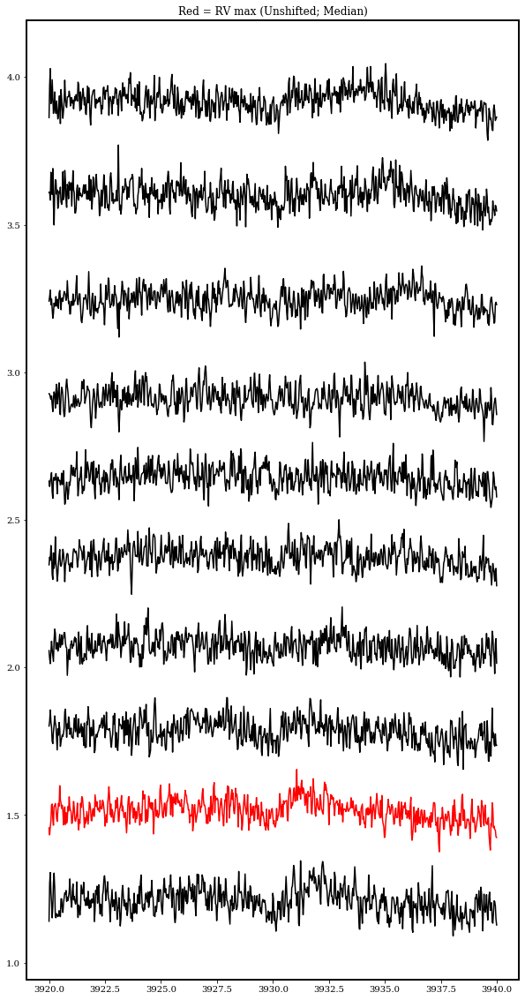

In [8]:
bin0 = np.vstack((adjAdjFlux[2],adjAdjFlux[3],adjAdjFlux[45],adjAdjFlux[46],adjAdjFlux[54],adjAdjFlux[55],adjAdjFlux[67],adjAdjFlux[68]))
bin1 = np.vstack((adjAdjFlux[4],adjAdjFlux[5],adjAdjFlux[20],adjAdjFlux[21],adjAdjFlux[30],adjAdjFlux[31],adjAdjFlux[47],adjAdjFlux[48],adjAdjFlux[49],adjAdjFlux[56],adjAdjFlux[57],adjAdjFlux[69]))
bin2 = np.vstack((adjAdjFlux[6],adjAdjFlux[7],adjAdjFlux[22],adjAdjFlux[23],adjAdjFlux[32],adjAdjFlux[33],adjAdjFlux[58],adjAdjFlux[59]))
bin3 = np.vstack((adjAdjFlux[8],adjAdjFlux[9],adjAdjFlux[24],adjAdjFlux[25],adjAdjFlux[34],adjAdjFlux[35]))
bin4 = np.vstack((adjAdjFlux[10],adjAdjFlux[11],adjAdjFlux[26],adjAdjFlux[27],adjAdjFlux[28],adjAdjFlux[36],adjAdjFlux[37],adjAdjFlux[38]))
bin5 = np.vstack((adjAdjFlux[12],adjAdjFlux[13],adjAdjFlux[29],adjAdjFlux[39]))
bin6 = np.vstack((adjAdjFlux[14],adjAdjFlux[15]))
bin7 = np.vstack((adjAdjFlux[16],adjAdjFlux[17],adjAdjFlux[60],adjAdjFlux[61]))
bin8 = np.vstack((adjAdjFlux[18],adjAdjFlux[19],adjAdjFlux[40],adjAdjFlux[41],adjAdjFlux[50],adjAdjFlux[62],adjAdjFlux[63]))
bin9 = np.vstack((adjAdjFlux[0],adjAdjFlux[1],adjAdjFlux[42],adjAdjFlux[43],adjAdjFlux[44],adjAdjFlux[51],adjAdjFlux[52],adjAdjFlux[53],adjAdjFlux[64],adjAdjFlux[65],adjAdjFlux[66]))

bin0 = np.median(bin0, axis=0)
bin1 = np.median(bin1, axis=0)
bin2 = np.median(bin2, axis=0)
bin3 = np.median(bin3, axis=0)
bin4 = np.median(bin4, axis=0)
bin5 = np.median(bin5, axis=0)
bin6 = np.median(bin6, axis=0)
bin7 = np.median(bin7, axis=0)
bin8 = np.median(bin8, axis=0)
bin9 = np.median(bin9, axis=0)


plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(10,20))
plt.plot(resample_grid.value, bin0, c='k')
plt.plot(resample_grid.value, bin1.value+0.3, c='r')
plt.plot(resample_grid.value, bin2.value+0.6, c='k')
plt.plot(resample_grid.value, bin3.value+0.9, c='k')
plt.plot(resample_grid.value, bin4.value+1.2, c='k')
plt.plot(resample_grid.value, bin5.value+1.5, c='k')
plt.plot(resample_grid.value, bin6.value+1.8, c='k')
plt.plot(resample_grid.value, bin7.value+2.1, c='k')
plt.plot(resample_grid.value, bin8.value+2.4, c='k')
plt.plot(resample_grid.value, bin9.value+2.7, c='k')
plt.title('Red = RV max (Unshifted; Median)')
plt.savefig('WD0137CaTrailMedian.pdf')

plt.rc('xtick',c='w')
plt.rc('ytick',c='w')

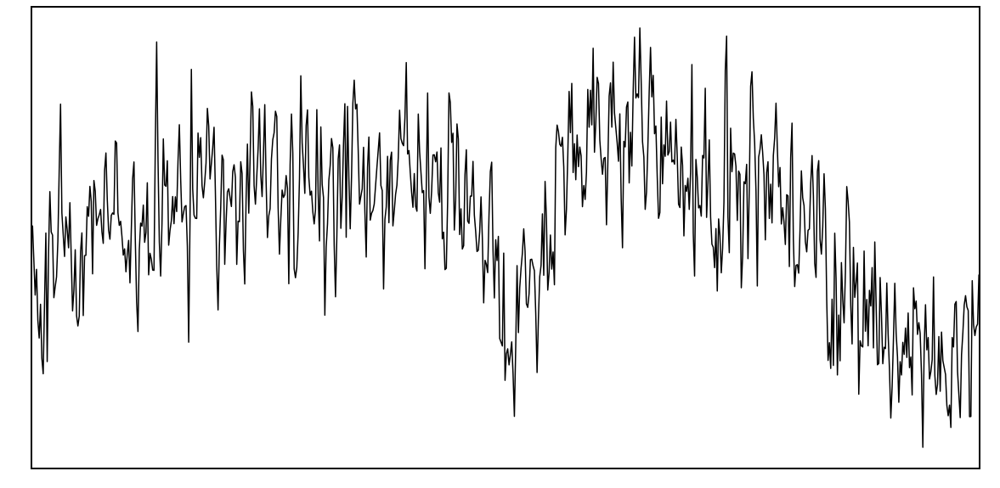

In [57]:

shift = np.array([0.368437950793149,0.496453262106692,0.613136596243456,0.706769581168092,0.769219833650886,0.794435806036302,0.779832480258259,0.726864104569939,0.640746128374593,0.529654025769331,0.403472006392252,0.275899234942159,0.158605785189438,0.062758709383022,-0.002361226479686,-0.030481694481139,-0.01889215633117,0.031315515707845,0.115767912309193,0.225245922778096,0.441132177273131,0.454061704981887,0.437902772148512,0.393749069752242,0.324731911874878,0.235615285069311,0.132873760021157,0.023578653297748,-0.084397783503527,-0.183576908509553,0.548327678151164,0.559530505358547,0.541600283991802,0.495818495306631,0.425351248394714,0.335352256543401,0.231933624967083,0.122332533174931,0.014650845833055,-0.083756823286797,-0.079984318162689,0.008387664015943,0.110884707749555,0.220334873366771,0.328878385805686,0.428830519629729,0.513319958982327,0.57643567944274,0.613662925480481,0.622410724878641,0.058222063131635,0.161498464349721,0.271083038525564,0.379130133706111,0.478276542795582,0.561372147086344,0.62257341501301,0.657651591285536,0.66414314523642,0.641600033285843,-0.078699386495945,-0.028867411667252,0.044896458048738,0.137502987591151,0.242476582313557,0.352178006629038,0.459200666607933,0.555895873286207,0.635413634971435,0.692153652924635])

adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1


from astropy import units as u
from specutils.manipulation import FluxConservingResampler, LinearInterpolatedResampler, SplineInterpolatedResampler

from astropy.nddata import StdDevUncertainty
from astropy.modeling import models
from specutils import Spectrum1D, SpectralRegion
from specutils.analysis import snr_derived
from astropy.io import fits as pyfits
from PyAstronomy import pyasl
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3920,3940,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0.0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl
    else:
        cummulativeShifted = cummulativeShifted + fl
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3920,3940)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

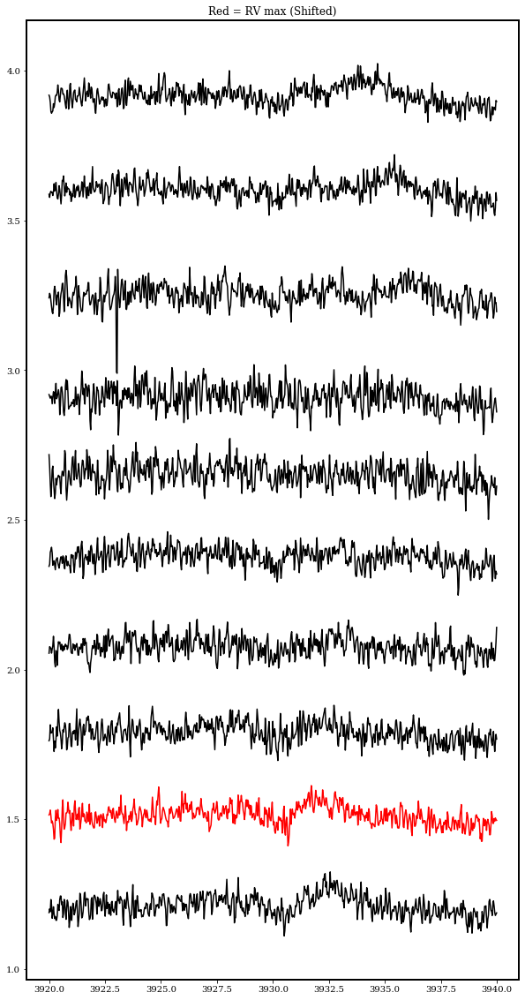

In [20]:
bin0 = (adjAdjFlux[2]+adjAdjFlux[3]+adjAdjFlux[45]+adjAdjFlux[46]+adjAdjFlux[54]+adjAdjFlux[55]+adjAdjFlux[67]+adjAdjFlux[68])/8
bin1 = (adjAdjFlux[4]+adjAdjFlux[5]+adjAdjFlux[20]+adjAdjFlux[21]+adjAdjFlux[30]+adjAdjFlux[31]+adjAdjFlux[47]+adjAdjFlux[48]+adjAdjFlux[49]+adjAdjFlux[56]+adjAdjFlux[57]+adjAdjFlux[69])/12
bin2 = (adjAdjFlux[6]+adjAdjFlux[7]+adjAdjFlux[22]+adjAdjFlux[23]+adjAdjFlux[32]+adjAdjFlux[33]+adjAdjFlux[58]+adjAdjFlux[59])/8
bin3 = (adjAdjFlux[8]+adjAdjFlux[9]+adjAdjFlux[24]+adjAdjFlux[25]+adjAdjFlux[34]+adjAdjFlux[35])/6
bin4 = (adjAdjFlux[10]+adjAdjFlux[11]+adjAdjFlux[26]+adjAdjFlux[27]+adjAdjFlux[28]+adjAdjFlux[36]+adjAdjFlux[37]+adjAdjFlux[38])/8
bin5 = (adjAdjFlux[12]+adjAdjFlux[13]+adjAdjFlux[29]+adjAdjFlux[39])/4
bin6 = (adjAdjFlux[14]+adjAdjFlux[15])/2
bin7 = (adjAdjFlux[16]+adjAdjFlux[17]+adjAdjFlux[60]+adjAdjFlux[61])/4
bin8 = (adjAdjFlux[18]+adjAdjFlux[19]+adjAdjFlux[40]+adjAdjFlux[41]+adjAdjFlux[50]+adjAdjFlux[62]+adjAdjFlux[63])/7
bin9 = (adjAdjFlux[0]+adjAdjFlux[1]+adjAdjFlux[42]+adjAdjFlux[43]+adjAdjFlux[44]+adjAdjFlux[51]+adjAdjFlux[52]+adjAdjFlux[53]+adjAdjFlux[64]+adjAdjFlux[65]+adjAdjFlux[66])/11
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(10,20))
plt.plot(resample_grid.value, bin0, c='k')
plt.plot(resample_grid.value, bin1.value+0.3, c='r')
plt.plot(resample_grid.value, bin2.value+0.6, c='k')
plt.plot(resample_grid.value, bin3.value+0.9, c='k')
plt.plot(resample_grid.value, bin4.value+1.2, c='k')
plt.plot(resample_grid.value, bin5.value+1.5, c='k')
plt.plot(resample_grid.value, bin6.value+1.8, c='k')
plt.plot(resample_grid.value, bin7.value+2.1, c='k')
plt.plot(resample_grid.value, bin8.value+2.4, c='k')
plt.plot(resample_grid.value, bin9.value+2.7, c='k')
plt.title('Red = RV max (Shifted)')
plt.savefig('WD0137CaTrailShifted.pdf')

plt.rc('xtick',c='w')
plt.rc('ytick',c='w')

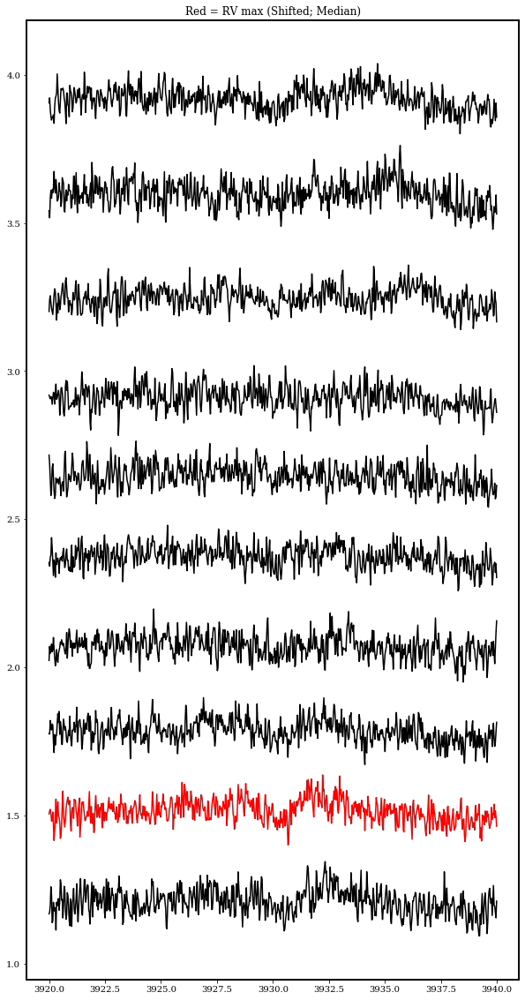

In [10]:
bin0 = np.vstack((adjAdjFlux[2],adjAdjFlux[3],adjAdjFlux[45],adjAdjFlux[46],adjAdjFlux[54],adjAdjFlux[55],adjAdjFlux[67],adjAdjFlux[68]))
bin1 = np.vstack((adjAdjFlux[4],adjAdjFlux[5],adjAdjFlux[20],adjAdjFlux[21],adjAdjFlux[30],adjAdjFlux[31],adjAdjFlux[47],adjAdjFlux[48],adjAdjFlux[49],adjAdjFlux[56],adjAdjFlux[57],adjAdjFlux[69]))
bin2 = np.vstack((adjAdjFlux[6],adjAdjFlux[7],adjAdjFlux[22],adjAdjFlux[23],adjAdjFlux[32],adjAdjFlux[33],adjAdjFlux[58],adjAdjFlux[59]))
bin3 = np.vstack((adjAdjFlux[8],adjAdjFlux[9],adjAdjFlux[24],adjAdjFlux[25],adjAdjFlux[34],adjAdjFlux[35]))
bin4 = np.vstack((adjAdjFlux[10],adjAdjFlux[11],adjAdjFlux[26],adjAdjFlux[27],adjAdjFlux[28],adjAdjFlux[36],adjAdjFlux[37],adjAdjFlux[38]))
bin5 = np.vstack((adjAdjFlux[12],adjAdjFlux[13],adjAdjFlux[29],adjAdjFlux[39]))
bin6 = np.vstack((adjAdjFlux[14],adjAdjFlux[15]))
bin7 = np.vstack((adjAdjFlux[16],adjAdjFlux[17],adjAdjFlux[60],adjAdjFlux[61]))
bin8 = np.vstack((adjAdjFlux[18],adjAdjFlux[19],adjAdjFlux[40],adjAdjFlux[41],adjAdjFlux[50],adjAdjFlux[62],adjAdjFlux[63]))
bin9 = np.vstack((adjAdjFlux[0],adjAdjFlux[1],adjAdjFlux[42],adjAdjFlux[43],adjAdjFlux[44],adjAdjFlux[51],adjAdjFlux[52],adjAdjFlux[53],adjAdjFlux[64],adjAdjFlux[65],adjAdjFlux[66]))

bin0 = np.median(bin0, axis=0)
bin1 = np.median(bin1, axis=0)
bin2 = np.median(bin2, axis=0)
bin3 = np.median(bin3, axis=0)
bin4 = np.median(bin4, axis=0)
bin5 = np.median(bin5, axis=0)
bin6 = np.median(bin6, axis=0)
bin7 = np.median(bin7, axis=0)
bin8 = np.median(bin8, axis=0)
bin9 = np.median(bin9, axis=0)

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(10,20))
plt.plot(resample_grid.value, bin0, c='k')
plt.plot(resample_grid.value, bin1.value+0.3, c='r')
plt.plot(resample_grid.value, bin2.value+0.6, c='k')
plt.plot(resample_grid.value, bin3.value+0.9, c='k')
plt.plot(resample_grid.value, bin4.value+1.2, c='k')
plt.plot(resample_grid.value, bin5.value+1.5, c='k')
plt.plot(resample_grid.value, bin6.value+1.8, c='k')
plt.plot(resample_grid.value, bin7.value+2.1, c='k')
plt.plot(resample_grid.value, bin8.value+2.4, c='k')
plt.plot(resample_grid.value, bin9.value+2.7, c='k')
plt.title('Red = RV max (Shifted; Median)')
plt.savefig('WD0137CaTrailShiftedMedian.pdf')

plt.rc('xtick',c='w')
plt.rc('ytick',c='w')

75.62413826255508
67.28353486364867
55.58677309013643
61.66266508640303
48.448260042702415


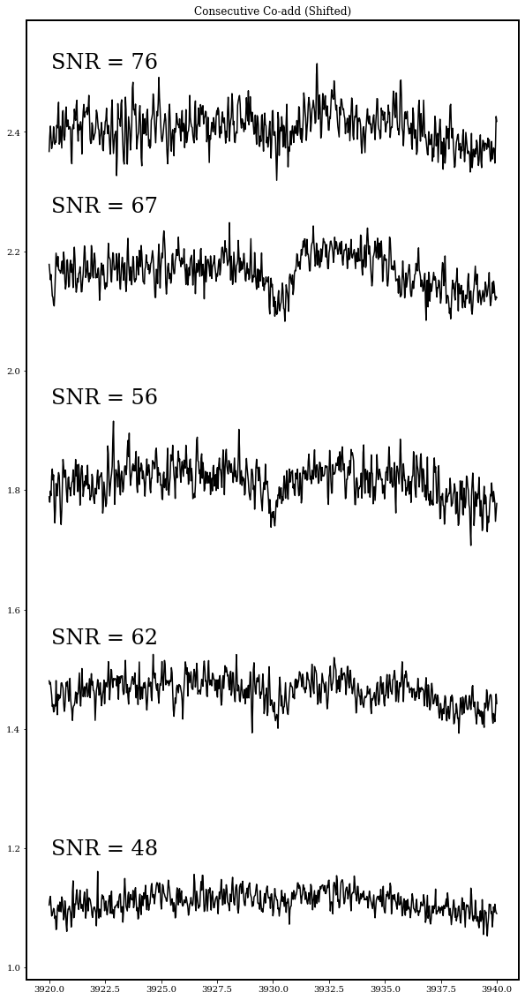

In [60]:
bin0 = (adjAdjFlux[0]+adjAdjFlux[1]+adjAdjFlux[2]+adjAdjFlux[3]+adjAdjFlux[4]+adjAdjFlux[5]+adjAdjFlux[6]+adjAdjFlux[7]+adjAdjFlux[8]+adjAdjFlux[9]+adjAdjFlux[10]+adjAdjFlux[11]+adjAdjFlux[12]+adjAdjFlux[13])/14

bin1 = (adjAdjFlux[14]+adjAdjFlux[15]+adjAdjFlux[16]+adjAdjFlux[17]+adjAdjFlux[18]+adjAdjFlux[19]+adjAdjFlux[20]+adjAdjFlux[21]+adjAdjFlux[22]+adjAdjFlux[23]+adjAdjFlux[24]+adjAdjFlux[25]+adjAdjFlux[26]+adjAdjFlux[27])/14

bin2 = (adjAdjFlux[28]+adjAdjFlux[29]+adjAdjFlux[30]+adjAdjFlux[31]+adjAdjFlux[32]+adjAdjFlux[33]+adjAdjFlux[34]+adjAdjFlux[35]+adjAdjFlux[36]+adjAdjFlux[37]+adjAdjFlux[38]+adjAdjFlux[39]+adjAdjFlux[40]+adjAdjFlux[41])/14

bin3 = (adjAdjFlux[42]+adjAdjFlux[43]+adjAdjFlux[44]+adjAdjFlux[45]+adjAdjFlux[46]+adjAdjFlux[47]+adjAdjFlux[48]+adjAdjFlux[49]+adjAdjFlux[50]+adjAdjFlux[51]+adjAdjFlux[52]+adjAdjFlux[53]+adjAdjFlux[54]+adjAdjFlux[55])/14

bin4 = (adjAdjFlux[56]+adjAdjFlux[57]+adjAdjFlux[58]+adjAdjFlux[59]+adjAdjFlux[60]+adjAdjFlux[61]+adjAdjFlux[62]+adjAdjFlux[63]+adjAdjFlux[64]+adjAdjFlux[65]+adjAdjFlux[66]+adjAdjFlux[67]+adjAdjFlux[68]+adjAdjFlux[69])/14

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin0* u.Jy)
der = snr_derived(spectrum)
print(der)

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin1* u.Jy)
der = snr_derived(spectrum)
print(der)

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin2* u.Jy)
der = snr_derived(spectrum)
print(der)

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin3* u.Jy)
der = snr_derived(spectrum)
print(der)

spectrum = Spectrum1D(spectral_axis=resample_grid.value* u.AA, flux=bin4* u.Jy)
der = snr_derived(spectrum)
print(der)

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(10,20))
plt.plot(resample_grid.value, bin0, c='k')
plt.plot(resample_grid.value, bin1.value+0.3, c='k')
plt.plot(resample_grid.value, bin2.value+0.6, c='k')
plt.plot(resample_grid.value, bin3.value+0.9, c='k')
plt.plot(resample_grid.value, bin4.value+1.2, c='k')
plt.title('Consecutive Co-add (Shifted)')

plt.annotate('SNR = 48', xy = (0.05, 0.13), xycoords = 'axes fraction', fontsize=24)

plt.annotate('SNR = 62', xy = (0.05, 0.35), xycoords = 'axes fraction', fontsize=24)

plt.annotate('SNR = 56', xy = (0.05, 0.6), xycoords = 'axes fraction', fontsize=24)

plt.annotate('SNR = 67', xy = (0.05, 0.8), xycoords = 'axes fraction', fontsize=24)

plt.annotate('SNR = 76', xy = (0.05, 0.95), xycoords = 'axes fraction', fontsize=24)

plt.savefig('WD0137CaTrailConsecutiveShifted.pdf')

plt.rc('xtick',c='w')
plt.rc('ytick',c='w')

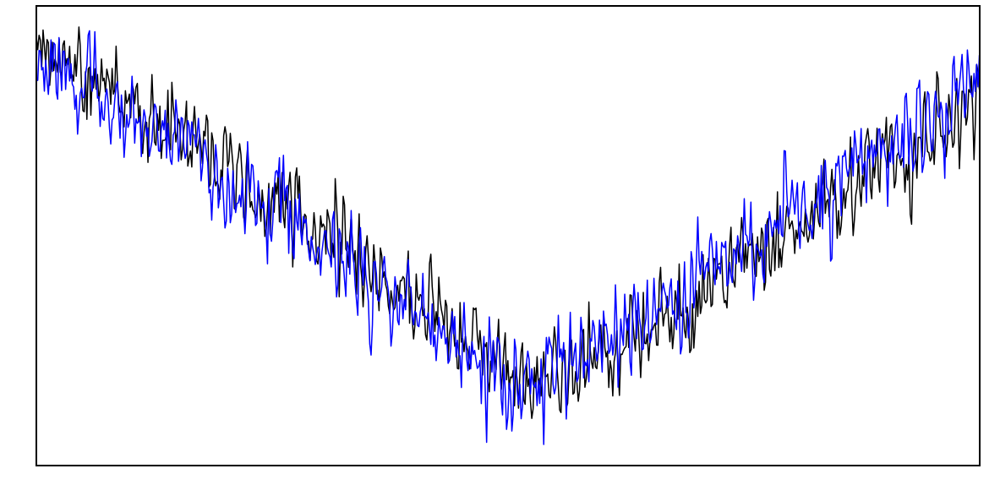

[<Quantity 13.89956944>, <Quantity 15.4669576>, <Quantity 17.34069736>, <Quantity 14.03988398>, <Quantity 16.73727599>, <Quantity 14.52514716>, <Quantity 20.26967941>, <Quantity 20.34455276>, <Quantity 21.02037437>, <Quantity 17.31477564>, <Quantity 20.5097649>, <Quantity 16.13185023>, <Quantity 17.0811445>, <Quantity 20.17534198>, <Quantity 17.62015568>, <Quantity 18.00738163>, <Quantity 17.70732366>, <Quantity 20.7355909>, <Quantity 20.50702072>, <Quantity 16.60209269>, <Quantity 13.99576208>, <Quantity 12.39322746>, <Quantity 15.29083679>, <Quantity 13.5638997>, <Quantity 13.63831931>, <Quantity 14.09021836>, <Quantity 14.39958303>, <Quantity 13.20572125>, <Quantity 13.93708643>, <Quantity 11.01924692>, <Quantity 8.67656768>, <Quantity 8.23258536>, <Quantity 10.97418331>, <Quantity 11.52221999>, <Quantity 10.28176354>, <Quantity 9.55403024>, <Quantity 12.16368816>, <Quantity 11.05056999>, <Quantity 11.41599504>, <Quantity 10.8644192>, <Quantity 13.65332427>, <Quantity 14.76818561>, 

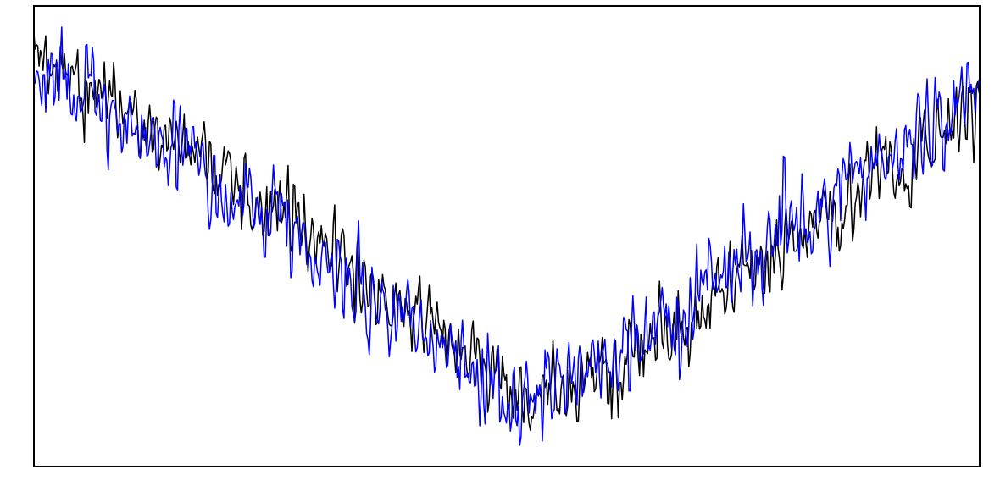

In [13]:

shift = np.array([0.359989692048848,0.485069620427813,0.59907741314488,0.690563399689079,0.751581671860166,0.776219443604897,0.761950971156795,0.710197156949227,0.626053860462818,0.517509092694366,0.394220418984532,0.269572883058135,0.154968964637324,0.06131965617424,-0.002307083706904,-0.029782751168196,-0.018458960389818,0.030597452927282,0.113113361453696,0.220081048115669,0.431017044545849,0.44365009900778,0.427861689475043,0.384720428662381,0.317285829819148,0.230212641590014,0.129826973167169,0.023037996279456,-0.082462547703447,-0.179367501690226,0.535754559416488,0.546700506509561,0.529181423976703,0.484449408790046,0.41559797136146,0.327662650660877,0.22661540171943,0.119527455981111,0.014314902871278,-0.08183628466366,-0.078150282841761,0.008195335414303,0.108342128463578,0.21528260875454,0.321337225366829,0.418997463128665,0.501549565018401,0.563218046028766,0.599591673686024,0.608138886601169,0.056887034932439,0.157795314848708,0.264867121718608,0.370436703888646,0.467309692132753,0.548499919509842,0.608297846261119,0.642571682185995,0.64891438521826,0.626888185388843,-0.076894814576294,-0.028205483756411,0.043866985125327,0.134350052843837,0.236916609725475,0.344102587368754,0.448671224571063,0.543149216319136,0.620843640793746,0.676282613749293])
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1

adjAdjFlux = []
adjAdjWvl = []
count = 0
SNRs = []
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3825,3845,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    der = snr_derived(output_spectrum1D)
    SNRs.append(der)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl*SNRs[count].value
    else:
        cummulativeShifted = cummulativeShifted + fl*SNRs[count].value
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3825,3845)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.array([-0.196000596416229,-0.196105027112227,-0.196210968019699,-0.19631775476078,-0.196426092107889,-0.196536285449197,-0.196647276988478,-0.1967598331889,-0.196873482254137,-0.196988359486828,-0.197105111079754,-0.197222226190877,-0.19734023151239,-0.197459193133672,-0.197579000812941,-0.197699626244547,-0.197820853063828,-0.197942833243187,-0.198065950013145,-0.198188671445372,0.136416550275106,0.136308160800911,0.136199844319113,0.136091470043223,0.135983216630813,0.135874998557357,0.135767089968836,0.1356593305107,0.135551930762243,0.135444791563209,0.033205382951709,0.033101571233669,0.032997147803445,0.032891998029134,0.032786108156645,0.032679764874306,0.032572712490735,0.032464965878948,0.032356926704902,0.032248389078742,-0.027746733013621,-0.027857144882506,-0.027967317398952,-0.028077256286166,-0.028186771994517,-0.028295769164602,-0.028404360210914,-0.0285125688246,-0.028620239588773,-0.028727428401144,-0.069181979815775,-0.069286599691838,-0.069391911499511,-0.069497751100848,-0.069604326686568,-0.069711424856651,-0.069818968765475,-0.069927002914577,-0.070035440525962,-0.070144330875331,-0.128665086159435,-0.128761388018929,-0.128858656490355,-0.128956957375271,-0.129056257546602,-0.12915627866325,-0.129257272576147,-0.129359105351934,-0.129461697200789,-0.129564995999883])

adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3825,3845,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl*SNRs[count].value
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl*SNRs[count].value
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(3825,3845)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')
print(SNRs)

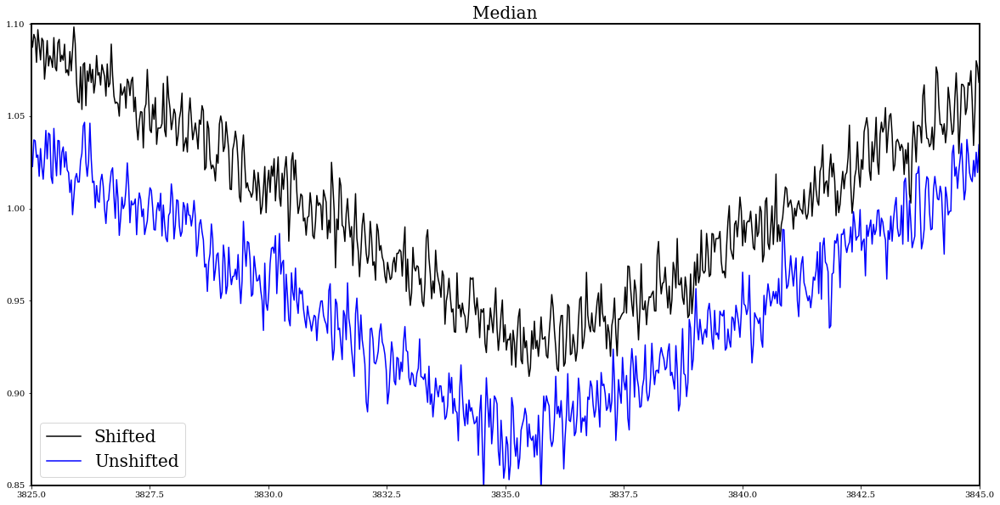

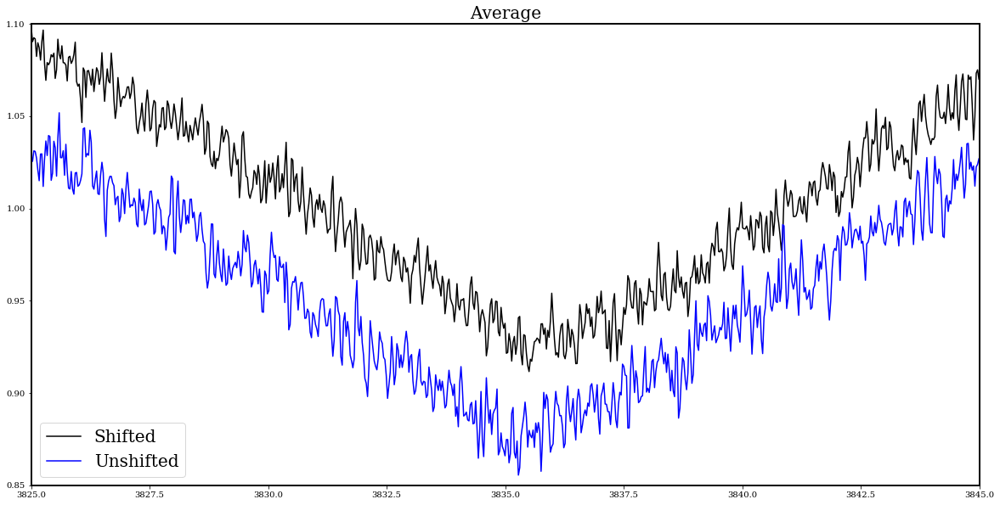

In [17]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Median', fontsize=20)
plt.xlim(3825,3845)
plt.plot(resample_grid.value, medianShifted/np.median(medianShifted), c='k', label='Shifted')
plt.plot(resample_grid.value, (medianUnShifted/np.median(medianUnShifted))-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.85, 1.1)
plt.savefig('WD0137MgMed.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')
plt.show()

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Average', fontsize=20)
plt.xlim(3825,3845)
plt.plot(resample_grid.value, cummulativeShifted/np.median(cummulativeShifted), c='k', label='Shifted')
plt.plot(resample_grid.value, (cummulativeUnShifted/np.median(cummulativeUnShifted))-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.85,1.1)
plt.savefig('WD0137MgAvg.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')


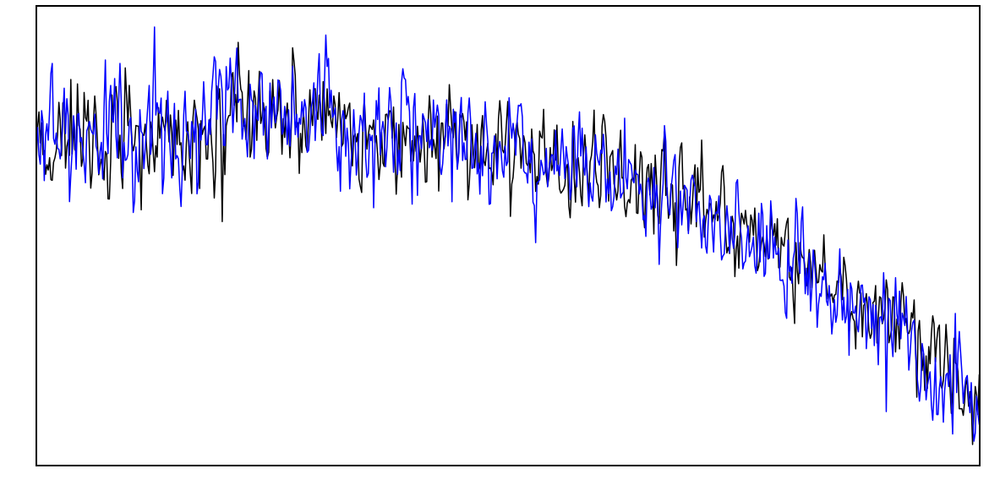

[<Quantity 14.81817854>, <Quantity 16.51004333>, <Quantity 18.63447296>, <Quantity 18.89397856>, <Quantity 18.61181347>, <Quantity 19.06061211>, <Quantity 16.30469512>, <Quantity 16.84911634>, <Quantity 19.08491298>, <Quantity 19.13814367>, <Quantity 16.90517943>, <Quantity 22.01514811>, <Quantity 20.58406483>, <Quantity 19.85206951>, <Quantity 15.71119467>, <Quantity 15.8603639>, <Quantity 20.85255999>, <Quantity 17.75660031>, <Quantity 19.47684436>, <Quantity 15.38478483>, <Quantity 13.06927351>, <Quantity 11.47190244>, <Quantity 14.85121994>, <Quantity 14.21240586>, <Quantity 12.84409694>, <Quantity 13.31353645>, <Quantity 15.5872649>, <Quantity 13.54488305>, <Quantity 13.26389781>, <Quantity 13.33573006>, <Quantity 9.03325811>, <Quantity 8.97950482>, <Quantity 12.02356461>, <Quantity 10.464591>, <Quantity 10.9672501>, <Quantity 11.47254156>, <Quantity 10.46559311>, <Quantity 11.29900142>, <Quantity 12.29621263>, <Quantity 9.61585351>, <Quantity 16.32438843>, <Quantity 16.4118853>, 

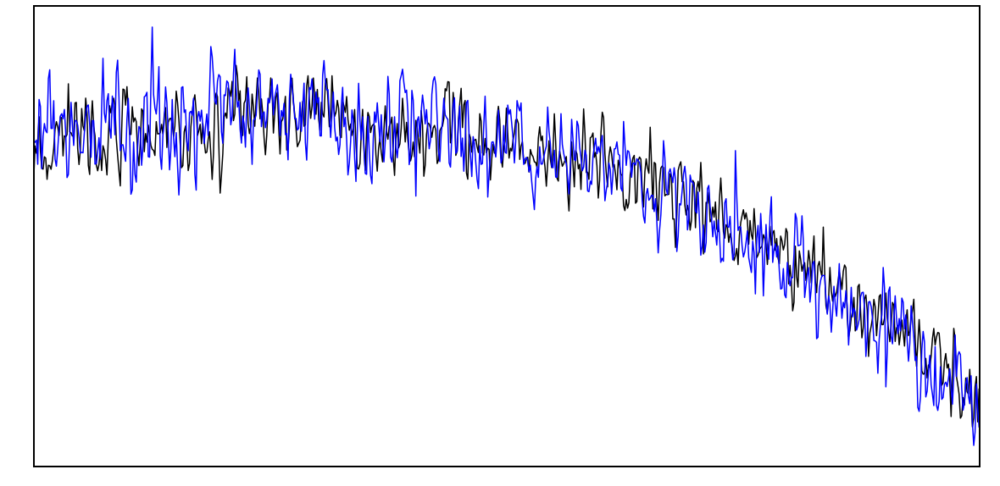

In [18]:

shift = np.array([0.358581648924798,0.483172346814666,0.596734215961784,0.687862369442577,0.748641978228379,0.773183383199663,0.758970719639885,0.707419332345775,0.623605149144189,0.515484937181871,0.392678487749912,0.268518491077465,0.154362827878638,0.061079813972776,-0.00229805991144,-0.029666260616039,-0.01838676106626,0.030477775797188,0.112670936311113,0.219220235671931,0.429331189091302,0.441914831345429,0.426188175696131,0.383215655147404,0.316044816143193,0.229312201010131,0.129319175358171,0.022947886776407,-0.082140008403433,-0.178665933887005,0.533659039627375,0.544562173368063,0.527111613974186,0.482554561037282,0.413972425189251,0.326381049680457,0.225729031178154,0.119059943115474,0.014258912377648,-0.081516194893137,-0.077844610288273,0.008163280647363,0.107918365249248,0.214440564652501,0.320080365293687,0.417358620378487,0.49958783269108,0.561015107126437,0.597246465053615,0.605760246888257,0.056664530232572,0.157178123265206,0.263831135584116,0.368987798919068,0.465481883688948,0.546354548247091,0.60591858480247,0.640058364002738,0.646376258548567,0.624436210739343,-0.076594052589685,-0.028095162437937,0.043695406304758,0.133824563719285,0.235989947627462,0.342756684158707,0.446916317564918,0.54102477349129,0.618415308430798,0.673637440553403])
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1

adjAdjFlux = []
adjAdjWvl = []
count = 0
SNRs = []
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3810,3830,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    der = snr_derived(output_spectrum1D)
    SNRs.append(der)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl*SNRs[count].value
    else:
        cummulativeShifted = cummulativeShifted + fl*SNRs[count].value
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3810,3830)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.array([-0.195233970876139,-0.195337993107876,-0.195443519644133,-0.195549888705653,-0.195657802308249,-0.195767564645615,-0.195878122058928,-0.195990238013455,-0.196103442558228,-0.196217870466671,-0.196334165404084,-0.196450822437849,-0.196568366200085,-0.196686862521676,-0.19680620159203,-0.196926355216211,-0.197047107875834,-0.197168610948885,-0.19729124616694,-0.197413487593565,0.135882978370509,0.135775012844714,0.135667120025818,0.135559169638881,0.135451339642688,0.135343544847224,0.135236058326193,0.135128720352249,0.135021740681034,0.134915020540145,0.033075505313045,0.032972099638231,0.032868084643849,0.032763346146361,0.032657870445472,0.032551943108175,0.032445309443183,0.032337984265341,0.03223036766955,0.032122254571263,-0.027638206026606,-0.027748186036811,-0.027857927630768,-0.027967436509297,-0.02807652386416,-0.028185094708939,-0.028293261018433,-0.028401046391127,-0.028508296018022,-0.028615065578193,-0.068911385370603,-0.069015596042457,-0.069120495939539,-0.069225921565903,-0.069332080297964,-0.06943875957038,-0.0695458828381,-0.069653494428601,-0.069761507903305,-0.06986997234518,-0.128161832888928,-0.128257758078829,-0.12835464609991,-0.128452562496359,-0.12855147427067,-0.128651104170434,-0.128751703061507,-0.128853137534391,-0.128955328111347,-0.129058222873417])
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3810,3830,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl*SNRs[count].value
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl*SNRs[count].value
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(3810,3830)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')

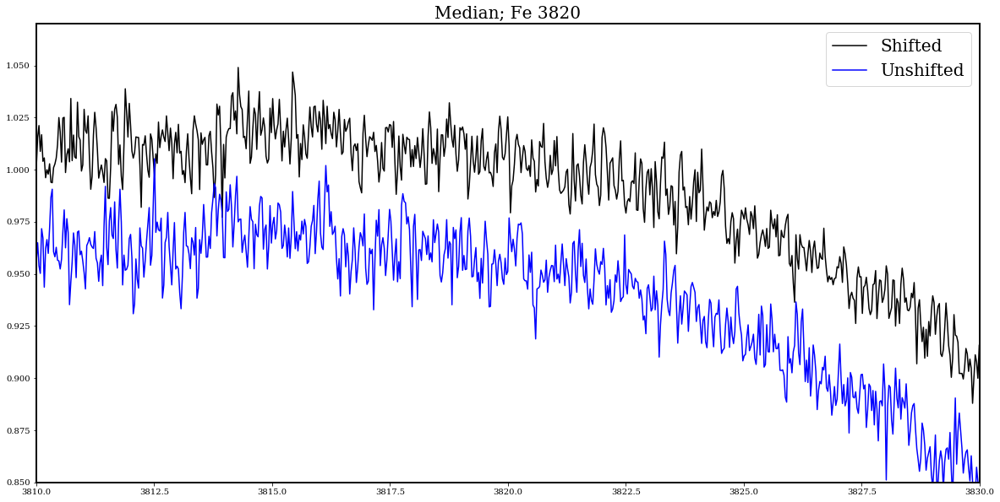

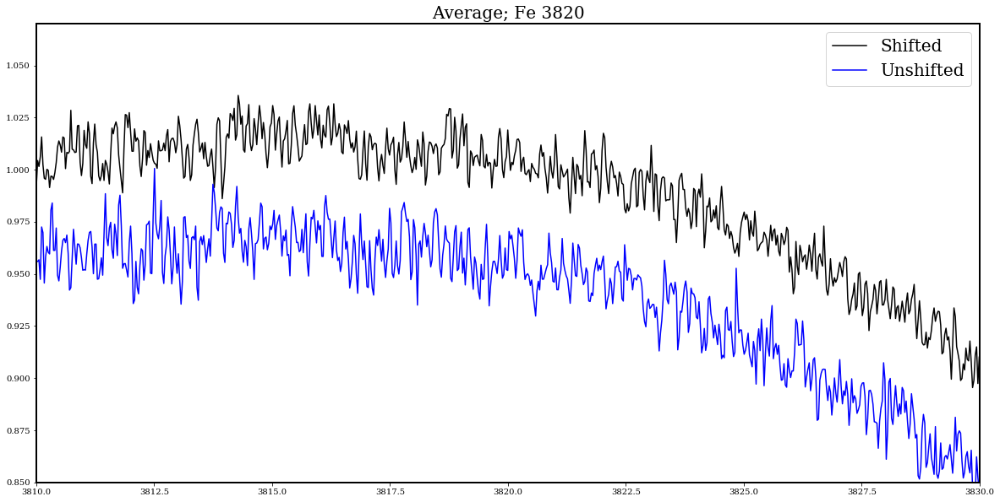

In [21]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Median; Fe 3820', fontsize=20)
plt.xlim(3810,3830)
plt.plot(resample_grid.value, medianShifted/np.median(medianShifted), c='k', label='Shifted')
plt.plot(resample_grid.value, (medianUnShifted/np.median(medianUnShifted))-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.85, 1.07)
plt.savefig('WD0137Fe1Med.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')
plt.show()

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Average; Fe 3820', fontsize=20)
plt.xlim(3810,3830)
plt.plot(resample_grid.value, cummulativeShifted/np.median(cummulativeShifted), c='k', label='Shifted')
plt.plot(resample_grid.value, (cummulativeUnShifted/np.median(cummulativeUnShifted))-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.85,1.07)
plt.savefig('WD0137Fe1Avg.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')


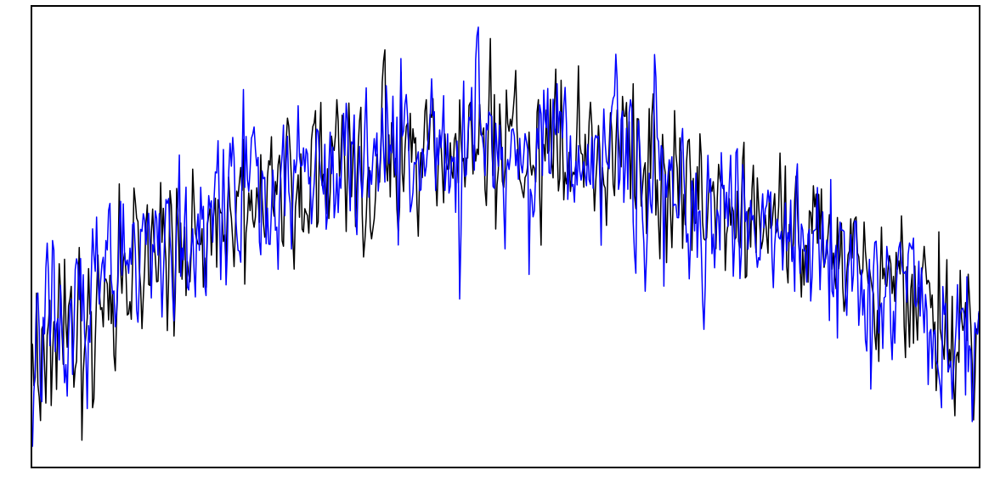

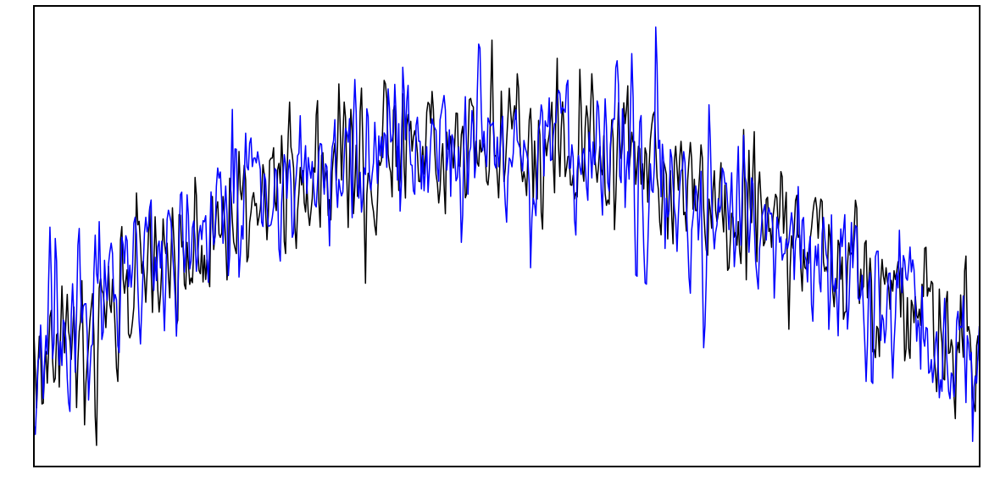

In [22]:

shift = np.array([0.358581648924798,0.483172346814666,0.596734215961784,0.687862369442577,0.748641978228379,0.773183383199663,0.758970719639885,0.707419332345775,0.623605149144189,0.515484937181871,0.392678487749912,0.268518491077465,0.154362827878638,0.061079813972776,-0.00229805991144,-0.029666260616039,-0.01838676106626,0.030477775797188,0.112670936311113,0.219220235671931,0.429331189091302,0.441914831345429,0.426188175696131,0.383215655147404,0.316044816143193,0.229312201010131,0.129319175358171,0.022947886776407,-0.082140008403433,-0.178665933887005,0.533659039627375,0.544562173368063,0.527111613974186,0.482554561037282,0.413972425189251,0.326381049680457,0.225729031178154,0.119059943115474,0.014258912377648,-0.081516194893137,-0.077844610288273,0.008163280647363,0.107918365249248,0.214440564652501,0.320080365293687,0.417358620378487,0.49958783269108,0.561015107126437,0.597246465053615,0.605760246888257,0.056664530232572,0.157178123265206,0.263831135584116,0.368987798919068,0.465481883688948,0.546354548247091,0.60591858480247,0.640058364002738,0.646376258548567,0.624436210739343,-0.076594052589685,-0.028095162437937,0.043695406304758,0.133824563719285,0.235989947627462,0.342756684158707,0.446916317564918,0.54102477349129,0.618415308430798,0.673637440553403])
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1

adjAdjFlux = []
adjAdjWvl = []
count = 0
SNRs = []
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3850,3870,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    der = snr_derived(output_spectrum1D)
    SNRs.append(der)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl*SNRs[count].value
    else:
        cummulativeShifted = cummulativeShifted + fl*SNRs[count].value
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3850,3870)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.array([-0.195233970876139,-0.195337993107876,-0.195443519644133,-0.195549888705653,-0.195657802308249,-0.195767564645615,-0.195878122058928,-0.195990238013455,-0.196103442558228,-0.196217870466671,-0.196334165404084,-0.196450822437849,-0.196568366200085,-0.196686862521676,-0.19680620159203,-0.196926355216211,-0.197047107875834,-0.197168610948885,-0.19729124616694,-0.197413487593565,0.135882978370509,0.135775012844714,0.135667120025818,0.135559169638881,0.135451339642688,0.135343544847224,0.135236058326193,0.135128720352249,0.135021740681034,0.134915020540145,0.033075505313045,0.032972099638231,0.032868084643849,0.032763346146361,0.032657870445472,0.032551943108175,0.032445309443183,0.032337984265341,0.03223036766955,0.032122254571263,-0.027638206026606,-0.027748186036811,-0.027857927630768,-0.027967436509297,-0.02807652386416,-0.028185094708939,-0.028293261018433,-0.028401046391127,-0.028508296018022,-0.028615065578193,-0.068911385370603,-0.069015596042457,-0.069120495939539,-0.069225921565903,-0.069332080297964,-0.06943875957038,-0.0695458828381,-0.069653494428601,-0.069761507903305,-0.06986997234518,-0.128161832888928,-0.128257758078829,-0.12835464609991,-0.128452562496359,-0.12855147427067,-0.128651104170434,-0.128751703061507,-0.128853137534391,-0.128955328111347,-0.129058222873417])
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3850,3870,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl*SNRs[count].value
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl*SNRs[count].value
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(3850,3870)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')

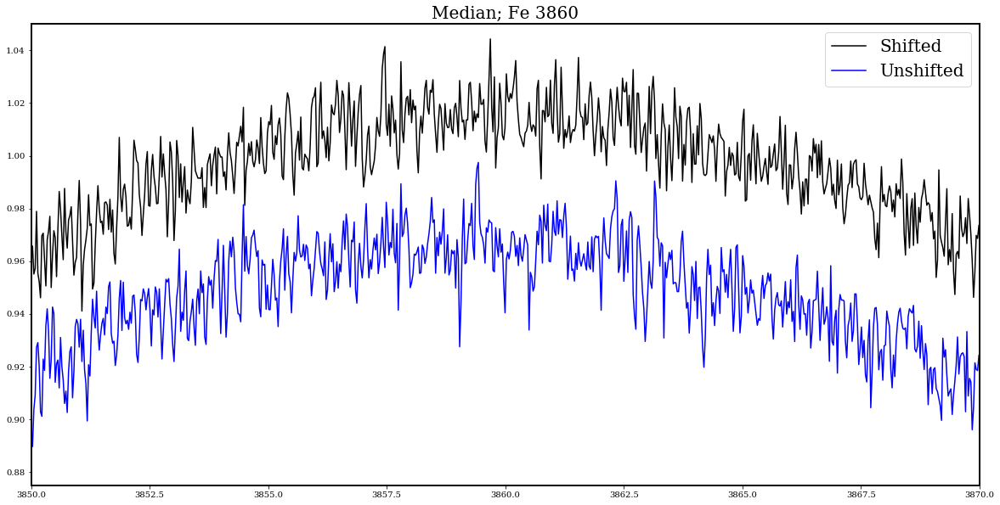

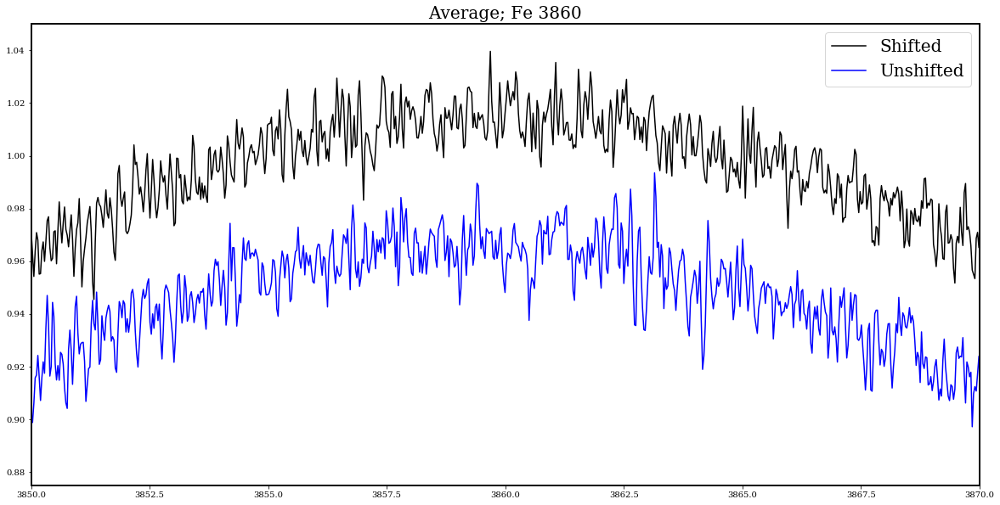

In [25]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Median; Fe 3860', fontsize=20)
plt.xlim(3850,3870)
plt.plot(resample_grid.value, medianShifted/np.median(medianShifted), c='k', label='Shifted')
plt.plot(resample_grid.value, (medianUnShifted/np.median(medianUnShifted))-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.875, 1.05)
plt.savefig('WD0137Fe2Med.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')
plt.show()

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Average; Fe 3860', fontsize=20)
plt.xlim(3850,3870)
plt.plot(resample_grid.value, cummulativeShifted/np.median(cummulativeShifted), c='k', label='Shifted')
plt.plot(resample_grid.value, (cummulativeUnShifted/np.median(cummulativeUnShifted))-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.875,1.05)
plt.savefig('WD0137Fe2Avg.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')


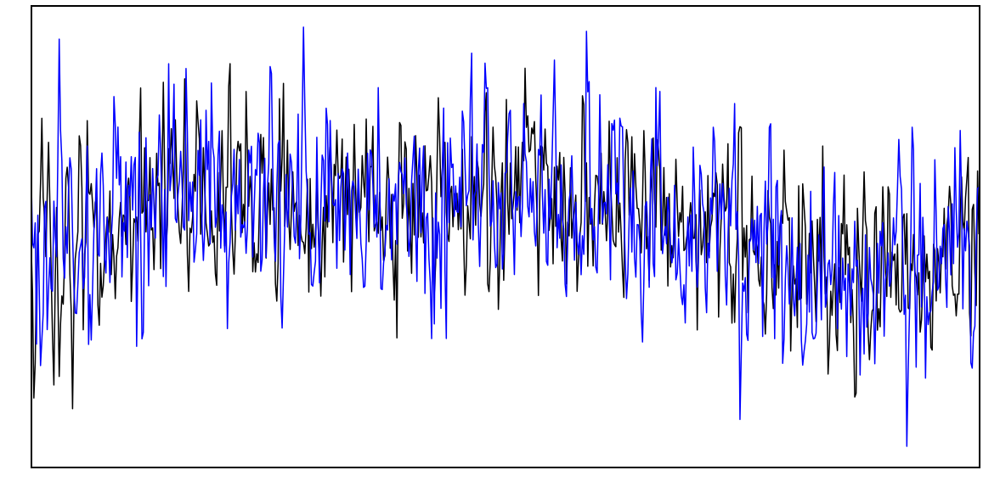

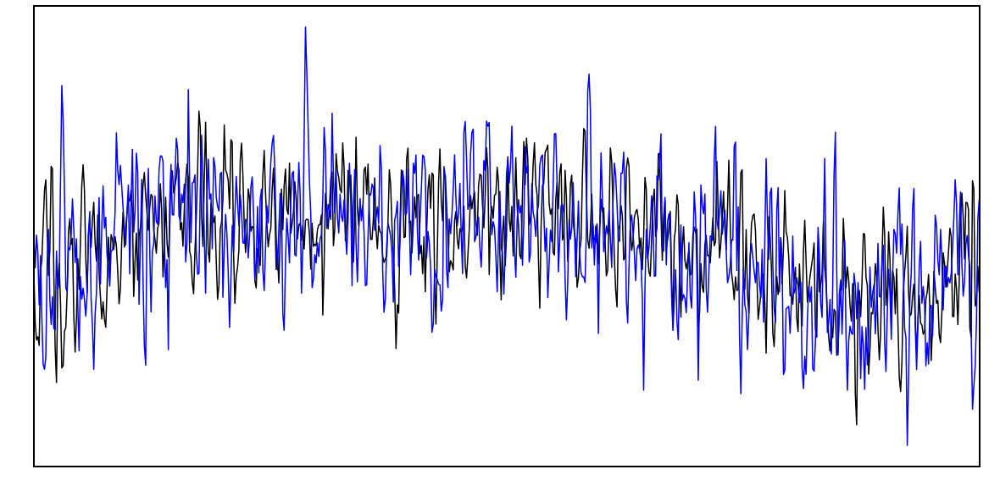

In [26]:

shift = np.array([0.396786552357361,0.534651704184711,0.660312966196456,0.761150323464338,0.828405665437528,0.85556182219502,0.839834877465391,0.782790973252772,0.690046849589656,0.570407023420882,0.434516221915936,0.297127660152996,0.170809338597645,0.067587532372493,-0.002542905561691,-0.032827037597905,-0.020345769378817,0.033725015260397,0.124675405179863,0.242576946645354,0.475074067091344,0.488998427250557,0.471596182897263,0.424045176520439,0.349717653884103,0.253744155410949,0.143097422575652,0.025392857959129,-0.090891574743799,-0.19770180694774,0.590517476571967,0.602582279274032,0.583272458709133,0.53396809672895,0.458078911328524,0.361155156282537,0.249779218531429,0.131745125536416,0.015778121104796,-0.090201297333322,-0.086138525572914,0.009033033323666,0.119416473798056,0.237288027954482,0.354183168611626,0.461825886999965,0.552816169839056,0.620788182676296,0.660879792612992,0.670300671098603,0.062701824422273,0.173924588230897,0.291940892700015,0.408301420426938,0.515076419464184,0.604565621843051,0.670475879047132,0.708253064041773,0.715244095519579,0.690966456229111,-0.084754727826335,-0.031088547545854,0.048350911636182,0.1480828352988,0.261133379220231,0.379275524591323,0.494532794331651,0.598667988886828,0.684304059878791,0.745409806601894])
    
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1

adjAdjFlux = []
adjAdjWvl = []
count = 0
SNRs = []
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(4215,4235,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    der = snr_derived(output_spectrum1D)
    SNRs.append(der)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl*SNRs[count].value
    else:
        cummulativeShifted = cummulativeShifted + fl*SNRs[count].value
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(4215,4235)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')

shift = np.array([-0.216035077197235,-0.216150182425914,-0.21626695223449,-0.216384654334763,-0.216504065538474,-0.21662552244948,-0.216747859147405,-0.216871920440543,-0.216997186307233,-0.217123805880266,-0.217252491403943,-0.217381577603347,-0.217511645007267,-0.217642766460504,-0.217774820452751,-0.217907775785059,-0.21804139397674,-0.218175842534277,-0.218311543860643,-0.218446809439267,0.150360562715221,0.15024109405618,0.150121705850558,0.150002253943338,0.149882935253833,0.149763655515502,0.14964471689655,0.149525942651559,0.149407564884485,0.149289474299265,0.036599518575456,0.036485095594451,0.036369998374228,0.036254100565619,0.036137387008641,0.036020173695878,0.035902178800088,0.035783418714553,0.035664336162091,0.035544704207521,-0.030582904940959,-0.030704602716649,-0.030826036674151,-0.030947213121676,-0.031067923134504,-0.031188061605939,-0.031307752441077,-0.031427021752694,-0.031545698237743,-0.031663843507597,-0.076253514649617,-0.076368828395671,-0.076484904800113,-0.076601562947401,-0.076719032308768,-0.076837077671203,-0.076955614334201,-0.077074691348088,-0.077194213064731,-0.077314233796617,-0.141816771628665,-0.141922917120212,-0.142030128027309,-0.142138476877515,-0.142247927157624,-0.142358172075504,-0.14246948922539,-0.142581730983736,-0.142694809404885,-0.142808667038203])
    
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1
    
    
adjAdjFlux = []
adjAdjWvl = []
count = 0
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(4215,4235,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)
count = 0

medianUnShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeUnShifted = fl*SNRs[count].value
    else:
        cummulativeUnShifted = cummulativeUnShifted + fl*SNRs[count].value
    count = count + 1
plt.plot(resample_grid.value, medianUnShifted, c='b', label='Unshifted')
plt.show()

plt.figure(figsize=(20,10))
plt.xlim(4215,4235)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
plt.plot(resample_grid.value, cummulativeUnShifted, c='b', label='Unshifted')

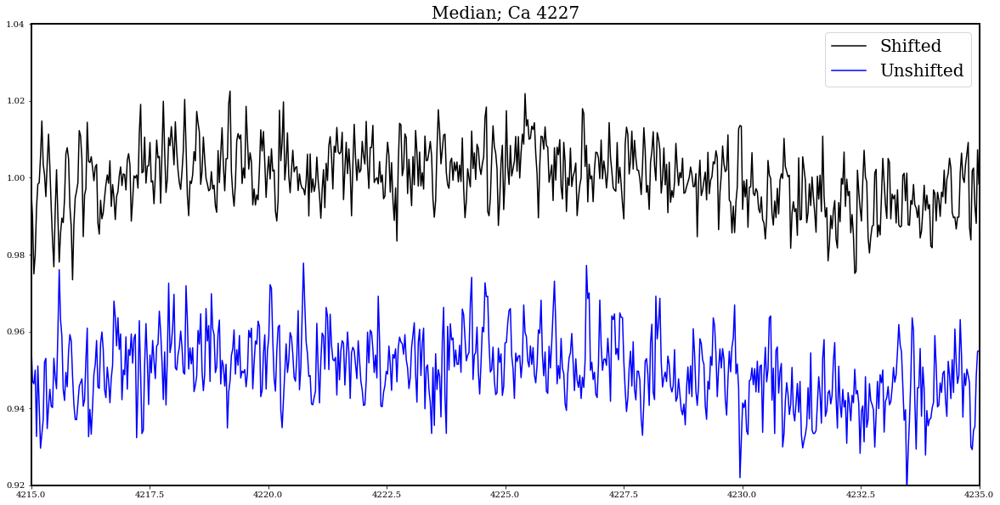

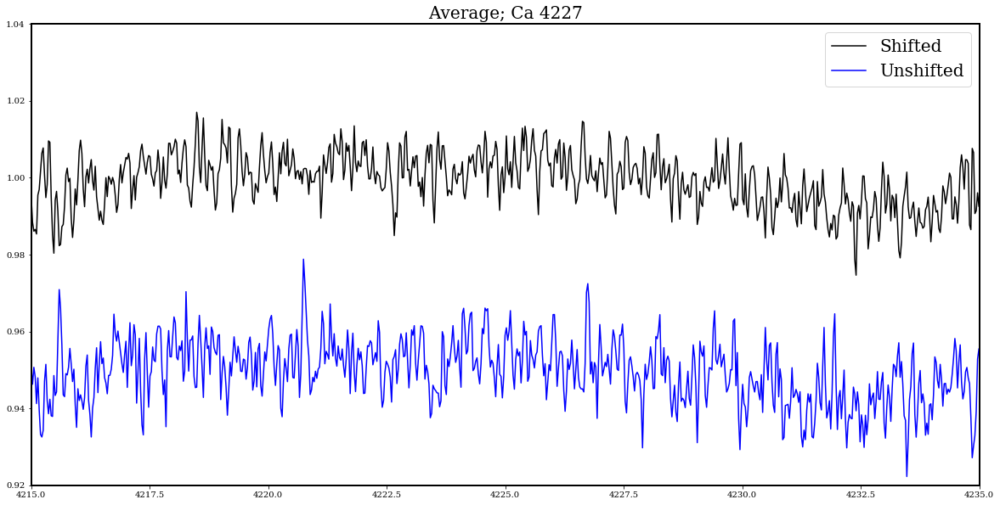

In [28]:
plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Median; Ca 4227', fontsize=20)
plt.xlim(4215,4235)
plt.plot(resample_grid.value, medianShifted/np.median(medianShifted), c='k', label='Shifted')
plt.plot(resample_grid.value, (medianUnShifted/np.median(medianUnShifted))-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.92, 1.04)
plt.savefig('WD0137Ca2Med.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')
plt.show()

plt.rc('xtick',c='k')
plt.rc('ytick',c='k')
plt.figure(figsize=(20,10))
plt.title('Average; Ca 4227', fontsize=20)
plt.xlim(4215,4235)
plt.plot(resample_grid.value, cummulativeShifted/np.median(cummulativeShifted), c='k', label='Shifted')
plt.plot(resample_grid.value, (cummulativeUnShifted/np.median(cummulativeUnShifted))-0.05, c='b', label='Unshifted')
plt.legend(prop={'size': 20})
plt.ylim(0.92,1.04)
plt.savefig('WD0137Ca2Avg.pdf')
plt.rc('xtick',c='w')
plt.rc('ytick',c='w')


In [12]:
phases1 = [0.86833048,0.91072794,0.9531298,0.99555495,0.03794662,0.08028289,0.12262357,0.16499484,0.2073515,0.24973159]
print(np.min(phases1), np.max(phases1), np.mean(phases1))

0.03794662 0.99555495 0.45906741799999995


In [ ]:
#shifts from H alpha/beta/gamma

path = '/home/nwal/Desktop/binaries/WD0137UVES/'
fluxes = []
wavels = []
count = 0
with open(path+'Bs') as file:
    for line in file:
        line = line.strip('\n')
        line = path+line
        wvl, flx = pyasl.read1dFitsSpec(line)
        flx = flx/np.median(flx)
        fluxes.append(flx)
        wavels.append(np.log10(wvl))
        count = count+1
path = '/home/nwal/Desktop/binaries/WD0137UVES/'
dates2 = []
with open(path+'Bs') as file:
    for line in file:
        line = line.strip('\n')
        line = path+line
        hdul = fits.open(line)
        dates2.append(hdul[0].header['MJD-OBS'])
        hdul.close()

count=0
wavelsAng = np.array(wavels)



shift = np.array([0.394901805871226,0.531587756849297,0.657916926719776,0.761182450134333,0.832396216174621,0.864682909902868,0.854719729967097,0.803558250014524,0.716229424420236,0.60102701185406,0.468180741832613,0.332112005469913,0.205285371554612,0.099776845974411,0.025801661854846,-0.009516460249393,-0.002766831695291,0.045416610557664,0.130872751815313,0.244262456142515,0.470792079259484,0.48927848241422,0.476846849908538,0.434333342789736,0.364749597220054,0.272896812667684,0.165449089063836,0.049802805798836,-0.065711896750349,-0.173093461315297,0.58954170438423,0.606208732867953,0.59188670992059,0.547611387706674,0.476440658988535,0.383582411268983,0.275344043389232,0.159294950218901,0.044014650284312,-0.062620301755233,-0.083816590206189,0.007198932453113,0.114329940258602,0.230082034762605,0.346142819137371,0.454291676292871,0.547091517067835,0.618051969316843,0.662098215760186,0.676165238811438,0.061801618002431,0.169853086081062,0.285846101207256,0.401474501274055,0.50885882872909,0.600256689399317,0.669237865988195,0.711033570985516,0.72270603455707,0.7034474393895,-0.070978885174225,-0.022307675316196,0.052502581282069,0.148292518715483,0.258367939200886,0.374717125975336,0.489484397577931,0.594470919231599,0.682239991600119,0.746609499573621])
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1

adjAdjFlux = []
adjAdjWvl = []
count = 0
SNRs = []
for el in fluxes:
    input_spectra = Spectrum1D(flux=el* u.mJy,spectral_axis=adjWvl[count]*u.Angstrom)
    resample_grid = np.arange(3760,4500,0.02815550757804896)*u.Angstrom
    fluxc_resample = FluxConservingResampler()
    output_spectrum1D = fluxc_resample(input_spectra, resample_grid)
    der = snr_derived(output_spectrum1D)
    SNRs.append(der)
    adjAdjFlux.append(np.nan_to_num(output_spectrum1D.flux, copy=False, nan=0.0))
    adjAdjWvl.append(resample_grid)
    count = count+1
    
adjAdjAdjFlux = []
for el in adjAdjFlux:
    fl = el / np.median(el)
    adjAdjAdjFlux.append(fl)

count = 0
medianShifted = np.median(adjAdjAdjFlux, axis=0)
for el in adjAdjFlux:
    fl = el / np.median(el)
    if count == 0:
        cummulativeShifted = fl*SNRs[count].value
    else:
        cummulativeShifted = cummulativeShifted + fl*SNRs[count].value
    count = count + 1

plt.figure(figsize=(20,10))
plt.xlim(3760,4500)
plt.plot(resample_grid.value, medianShifted, c='k', label='Shifted')



plt.figure(figsize=(20,10))
plt.xlim(3760,4500)
plt.plot(resample_grid.value, cummulativeShifted, c='k', label='Shifted')
print(SNRs)

/home/nwal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:27: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [5]:
#shifts from H alpha/beta/gamma
path = '/home/nwal/Desktop/binaries/WD0137UVES/'
fluxes = []
wavels = []
count = 0
with open(path+'Bs') as file:
    for line in file:
        line = line.strip('\n')
        line = path+line
        wvl, flx = pyasl.read1dFitsSpec(line)
        flx = flx/np.median(flx)
        fluxes.append(flx)
        wavels.append(np.log10(wvl))
        count = count+1
path = '/home/nwal/Desktop/binaries/WD0137UVES/'
dates2 = []
with open(path+'Bs') as file:
    for line in file:
        line = line.strip('\n')
        line = path+line
        hdul = fits.open(line)
        dates2.append(hdul[0].header['MJD-OBS'])
        hdul.close()

count=0
wavelsAng = np.array(wavels)



shift = np.array([0.394901805871226,0.531587756849297,0.657916926719776,0.761182450134333,0.832396216174621,0.864682909902868,0.854719729967097,0.803558250014524,0.716229424420236,0.60102701185406,0.468180741832613,0.332112005469913,0.205285371554612,0.099776845974411,0.025801661854846,-0.009516460249393,-0.002766831695291,0.045416610557664,0.130872751815313,0.244262456142515,0.470792079259484,0.48927848241422,0.476846849908538,0.434333342789736,0.364749597220054,0.272896812667684,0.165449089063836,0.049802805798836,-0.065711896750349,-0.173093461315297,0.58954170438423,0.606208732867953,0.59188670992059,0.547611387706674,0.476440658988535,0.383582411268983,0.275344043389232,0.159294950218901,0.044014650284312,-0.062620301755233,-0.083816590206189,0.007198932453113,0.114329940258602,0.230082034762605,0.346142819137371,0.454291676292871,0.547091517067835,0.618051969316843,0.662098215760186,0.676165238811438,0.061801618002431,0.169853086081062,0.285846101207256,0.401474501274055,0.50885882872909,0.600256689399317,0.669237865988195,0.711033570985516,0.72270603455707,0.7034474393895,-0.070978885174225,-0.022307675316196,0.052502581282069,0.148292518715483,0.258367939200886,0.374717125975336,0.489484397577931,0.594470919231599,0.682239991600119,0.746609499573621])
adjWvl = []
count = 0
for el in wavels:
    
    newW = 10**el+shift[count]
    adjWvl.append(newW)
    count = count + 1
count = 0

for el in adjWvl:
    nameFile = str(count)+'ShiftedWD0137.fits'
    pyasl.write1dFitsSpec(nameFile, fluxes[count], wvl=el, clobber=True)
    count = count +1




/home/nwal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:26: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
